# Assignment 1


### This is the supporting Notbook for the given assignment. You will be provided with the instructions and code skeleton of the questions.

1. Please implement the codes on your own cosidering plagarism policy.
2. Write code for corresponding questions in their designated places.
3. Each group have to submit only one notebook (.ipynb) or python (.py) file.

## Group Informtion: To be filled by the candidates.

### Group Number: 14
### Members Roll Numbers: 24AI60R13, 24AI60R46


## Question: 1

### A). Write a Python function to generate the specified graph of 50 nodes and plot the graph. (without using any external library) [3 Marks]

In [1]:
import random
import matplotlib.pyplot as plt
import numpy as np
import networkx as nx

def generate_erdos_renyi_graph(n, p, seed=None):
    np.random.seed(seed)
    random_graph_matrix = np.random.rand(n, n)
    G = (random_graph_matrix < p).astype(int)
    np.fill_diagonal(G, 0)
    return G

In [2]:
def visualize_graph(adjacency_matrix, title="Random Graph", g_size=10):
    n = adjacency_matrix.shape[0]
    plt.figure(figsize=(g_size, g_size))

    # Generate random positions for each node
    node_positions = {i: (random.random(), random.random()) for i in range(n)}

    # Draw edges
    for i in range(n):
        for j in range(i + 1, n):
            if adjacency_matrix[i, j] == 1:
                x_values = [node_positions[i][0], node_positions[j][0]]
                y_values = [node_positions[i][1], node_positions[j][1]]
                plt.plot(x_values, y_values, color='black', zorder=1)

    # Draw nodes on top of edges
    for node, pos in node_positions.items():
        plt.scatter(pos[0], pos[1], color='lightblue', s=500, zorder=2)
        plt.text(pos[0], pos[1], str(node), fontsize=10, fontweight='bold',
                 ha='center', va='center', color='black', zorder=3)

    plt.title(title)
    plt.show()

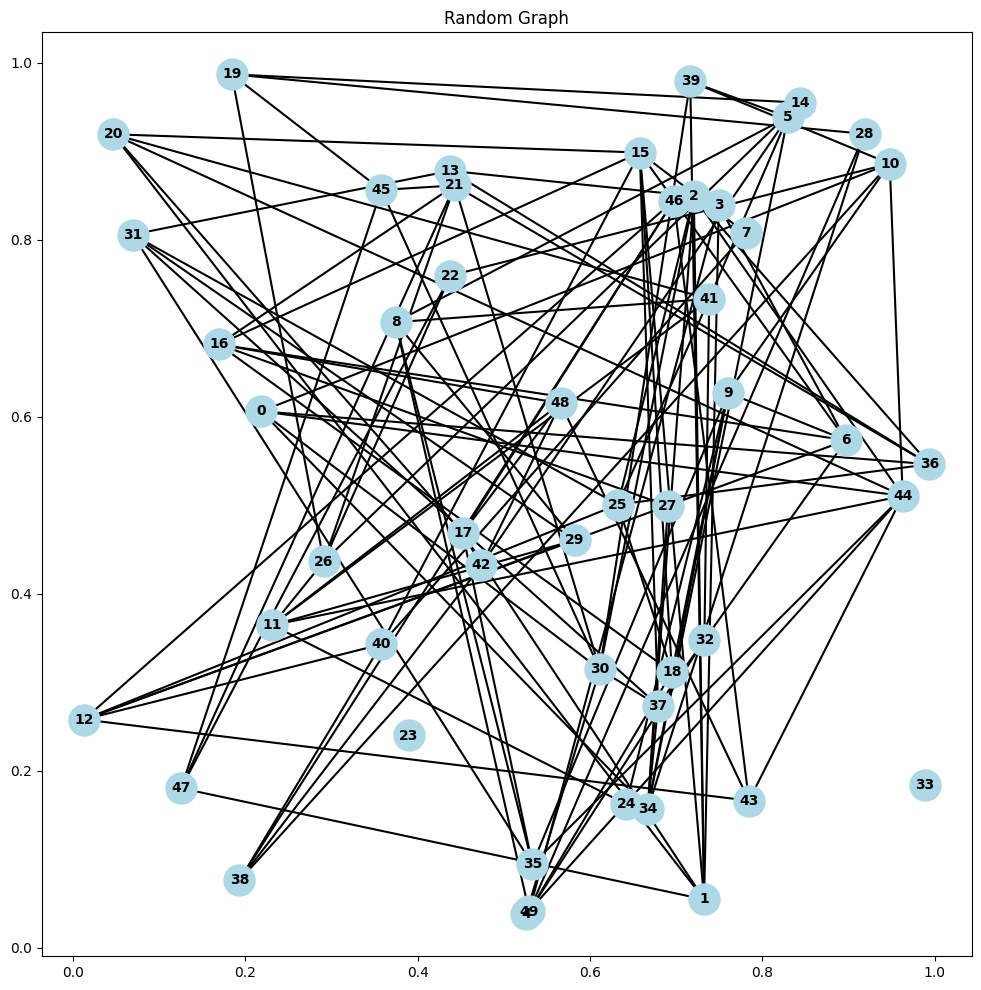

In [3]:
# Generating graph
n = 50
p = 0.1

random_graph = generate_erdos_renyi_graph(n,p,5)
visualize_graph(random_graph,g_size=12)

### B). Visualize the Node degree distrbution [refer assignemnt pdf for more detail]. [2 marks]

In [4]:
def visualize_graph_B(random_graph,title="Erdős-Rényi Random Graph",g_size=10):
    G = nx.from_numpy_array(random_graph)
    pos = nx.spring_layout(G)
    plt.figure(figsize=(g_size, g_size))
    nx.draw(G, pos, node_color='lightblue',with_labels=True, node_size=500, font_size=10, font_weight='bold')
    plt.title(title)
    plt.show()



Graph for 100 nodes




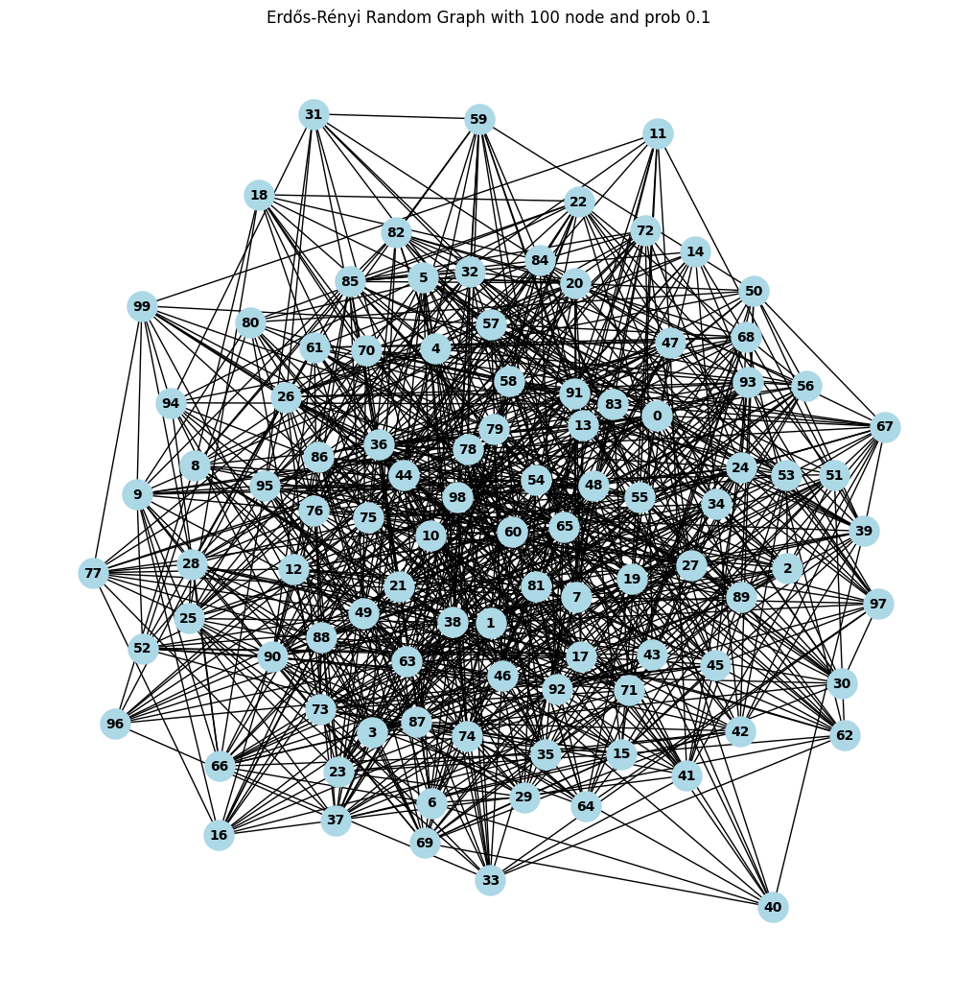

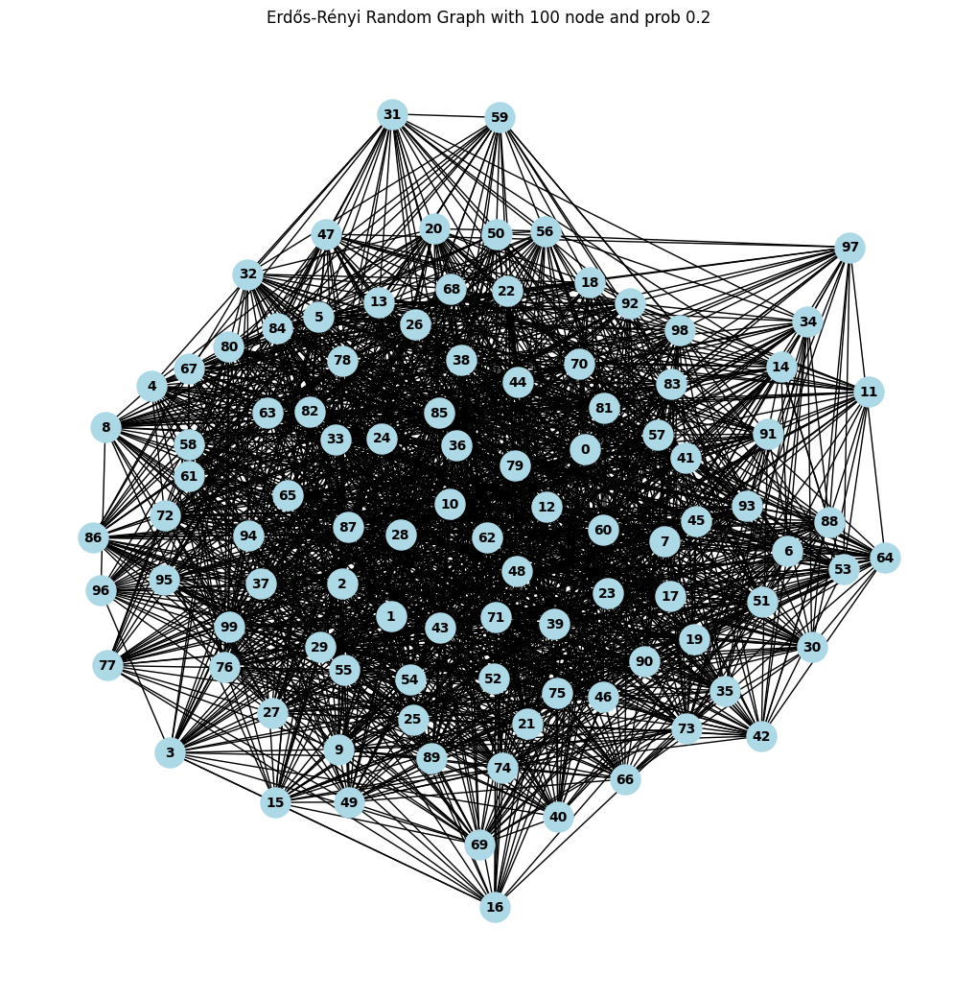

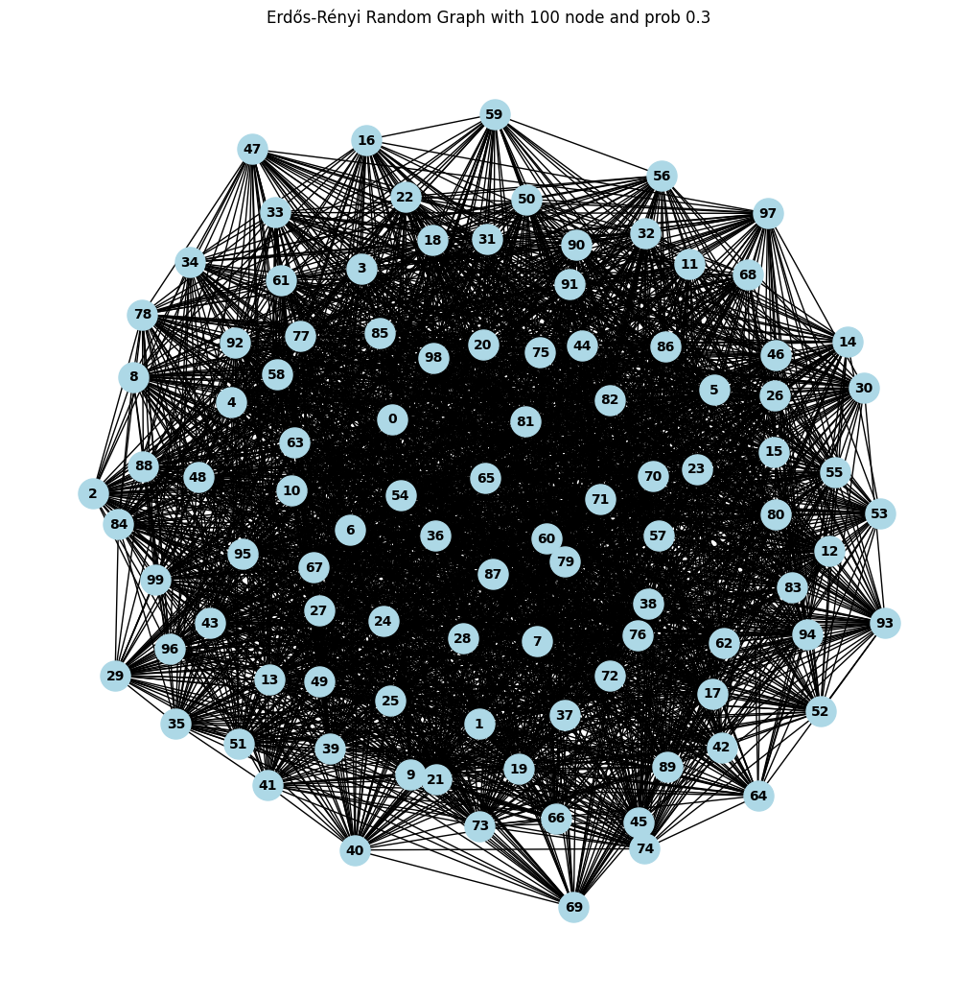

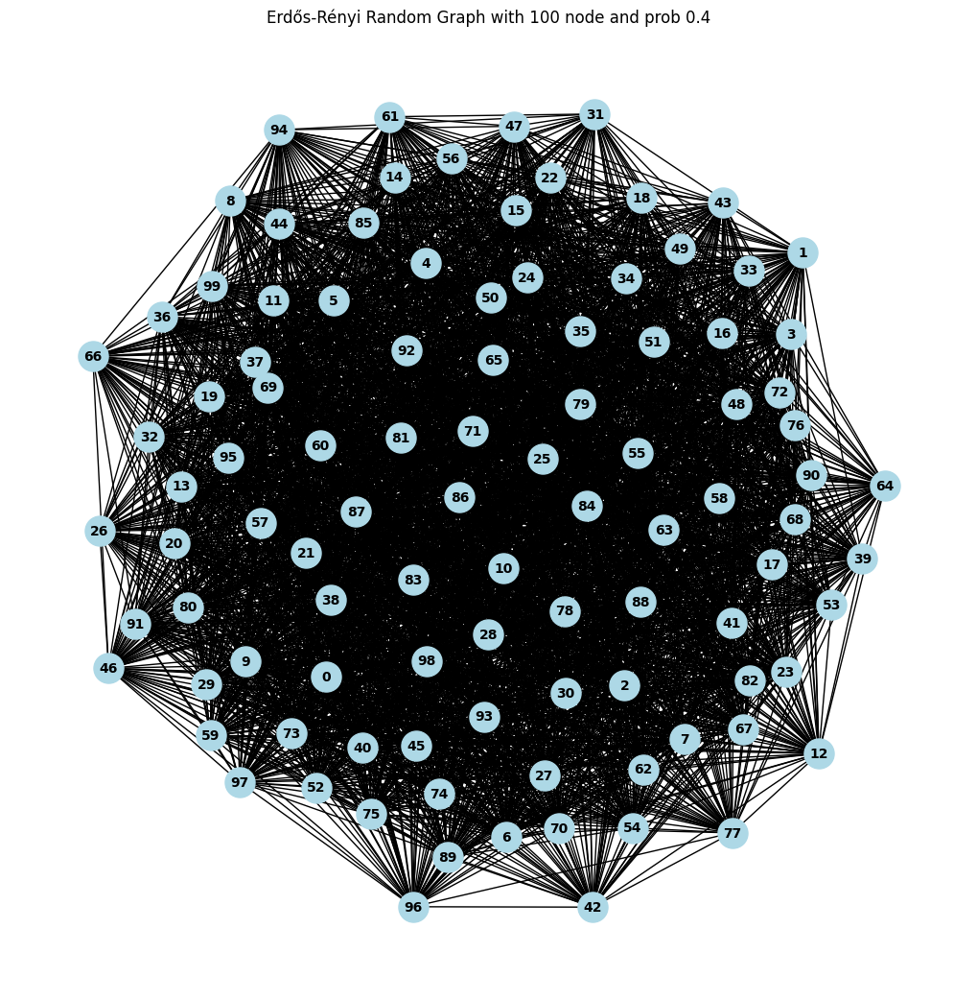

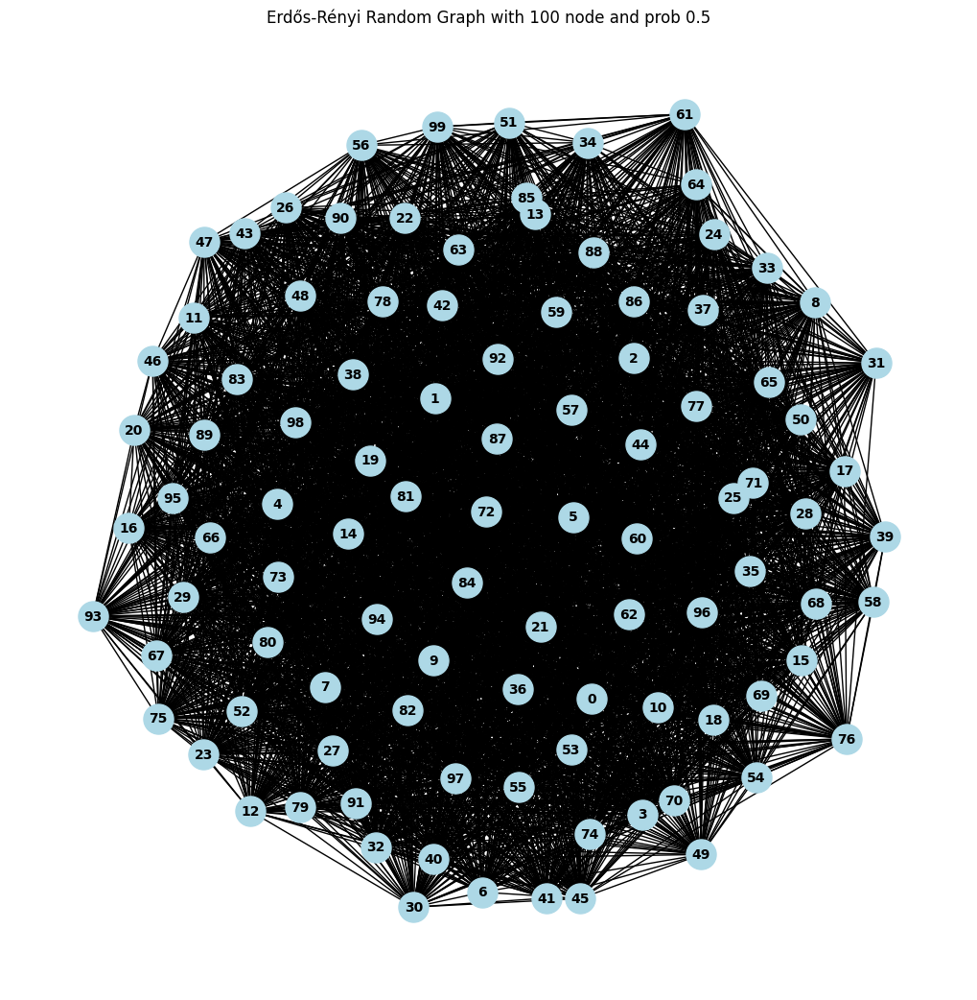

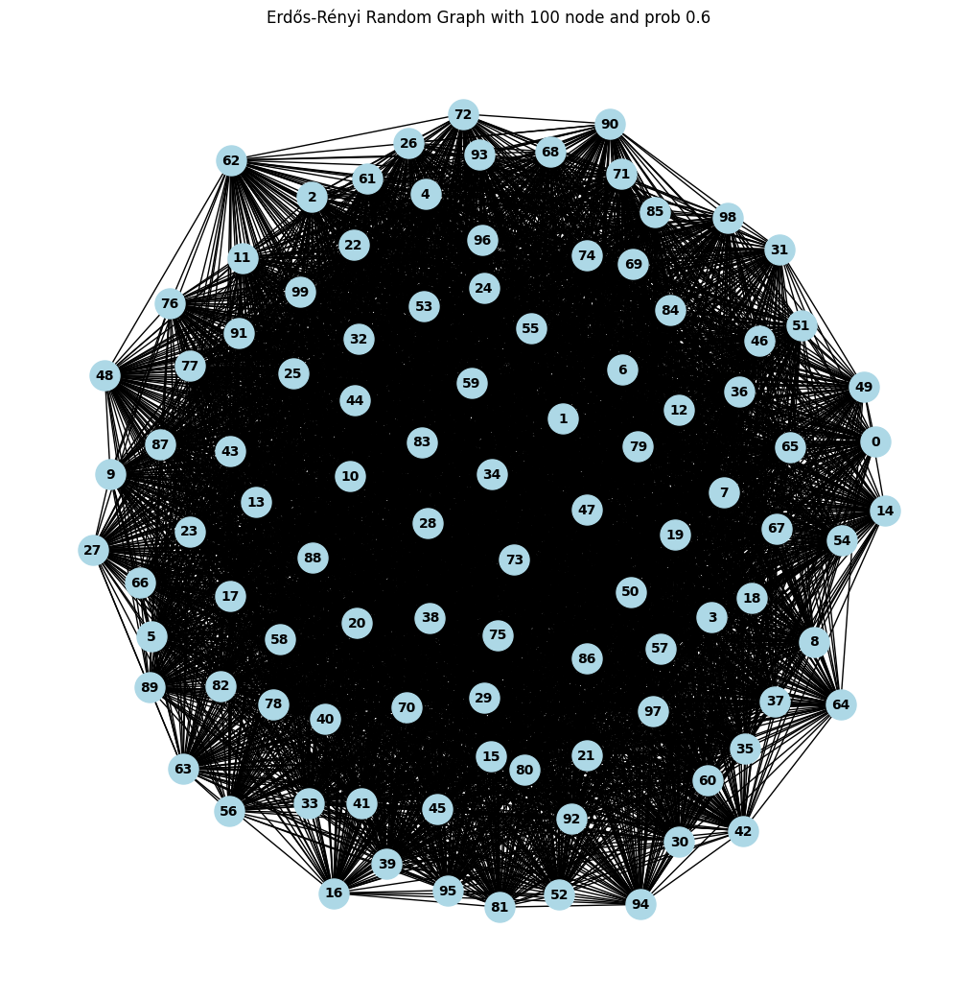



Graph for 200 nodes




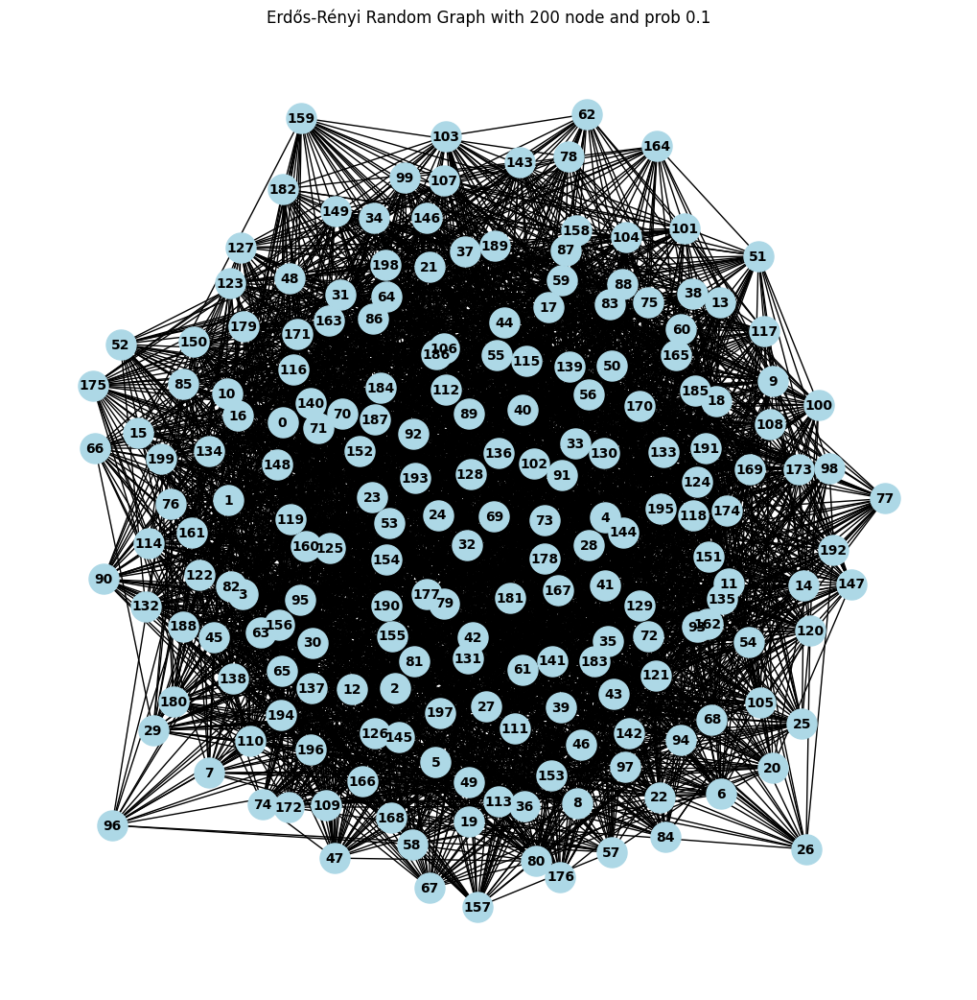

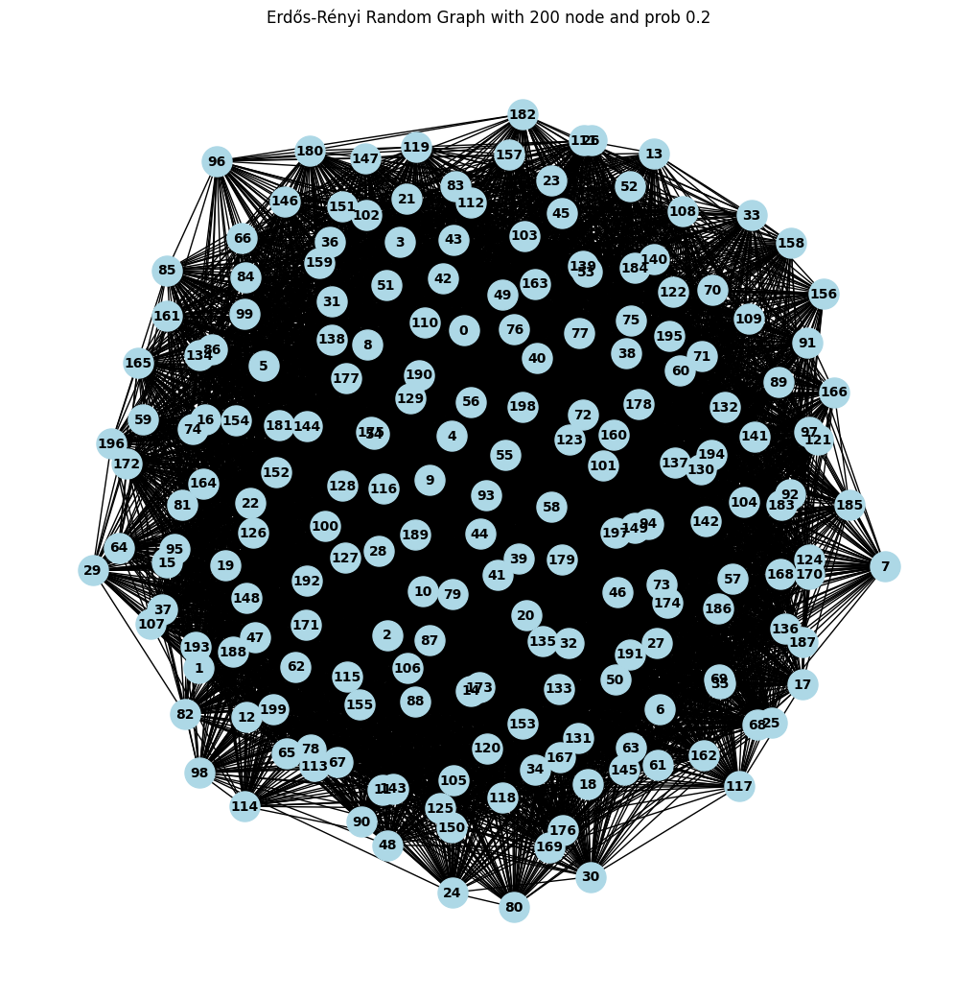

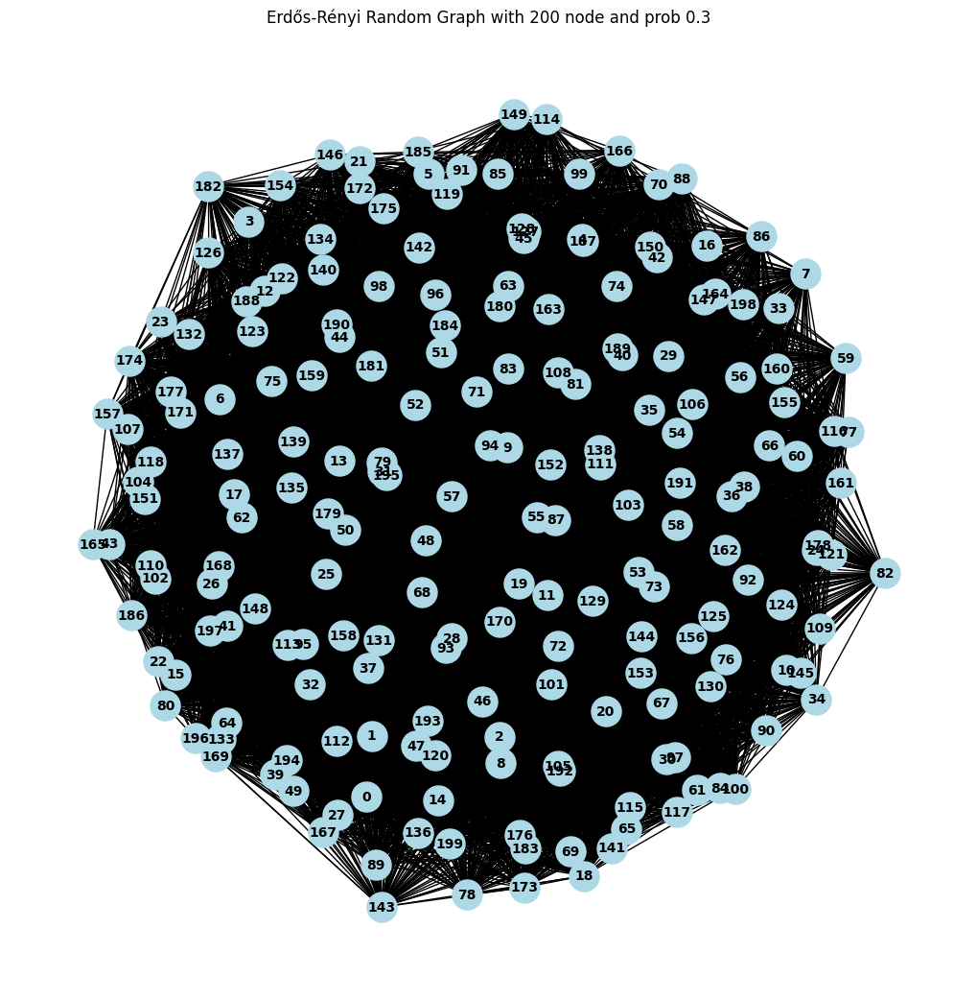

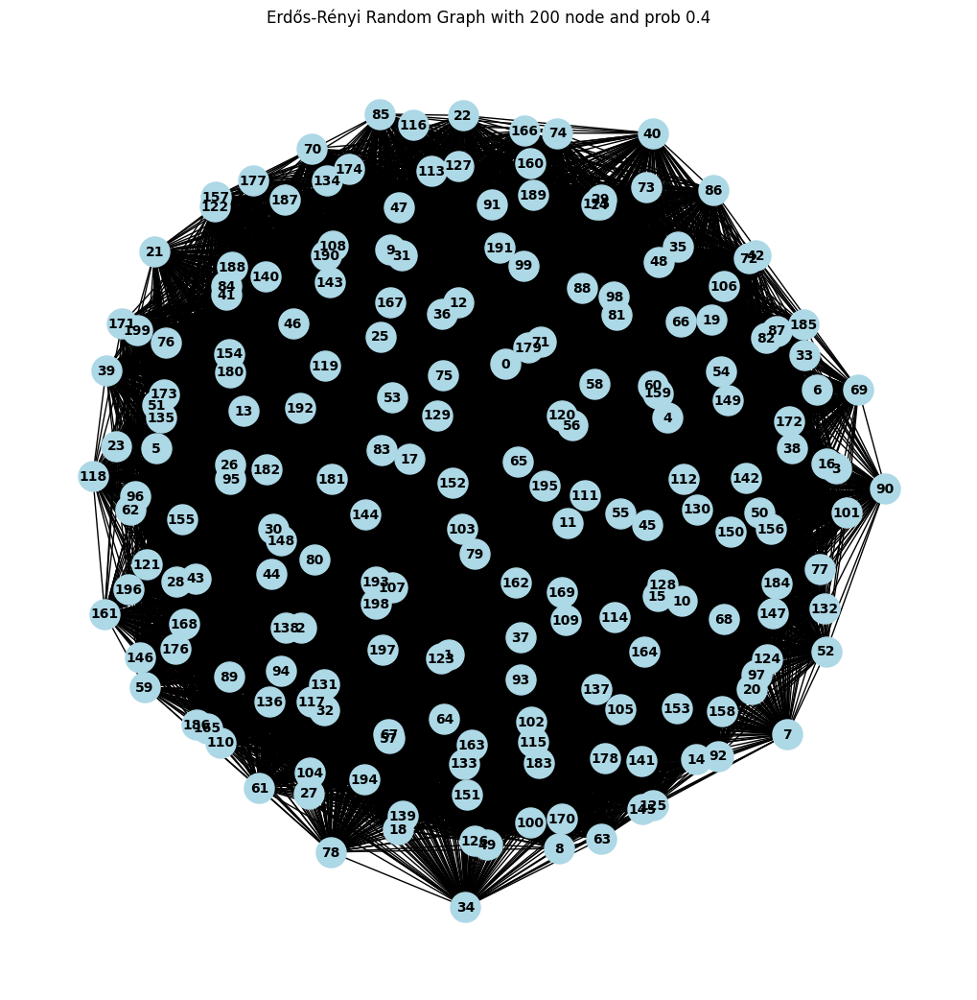

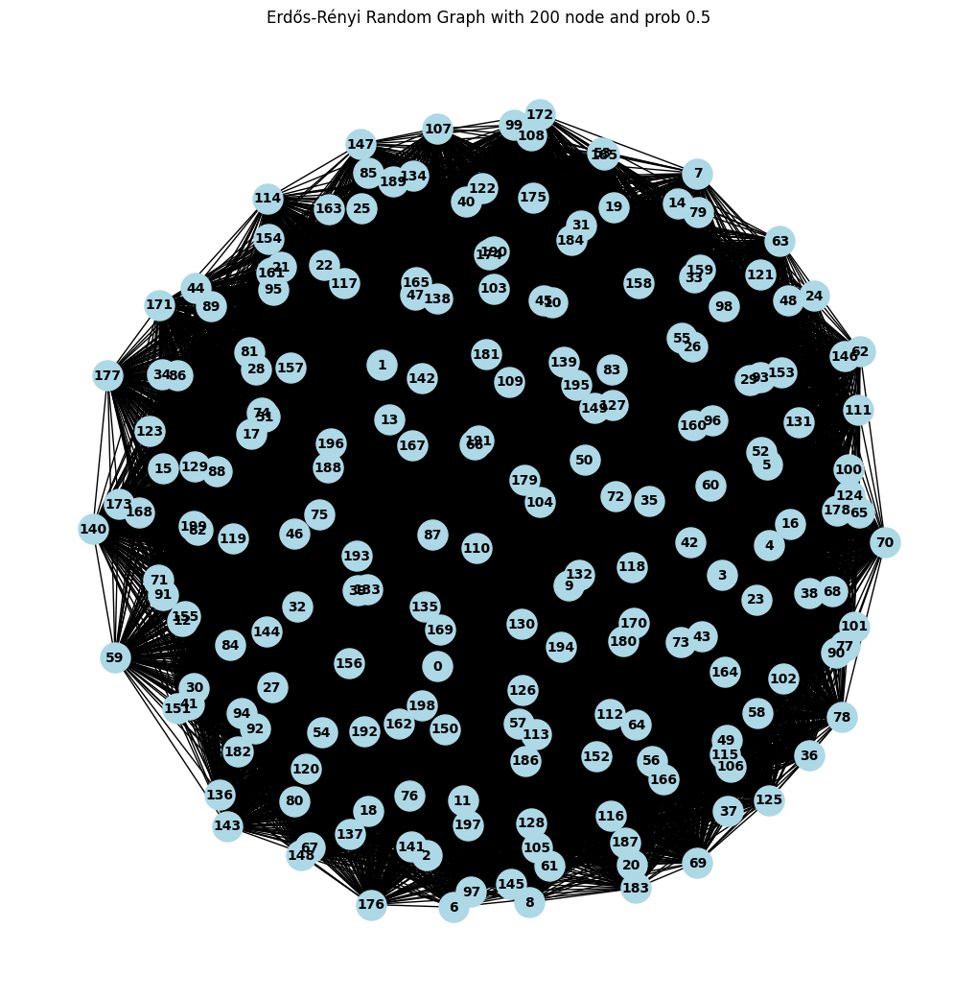

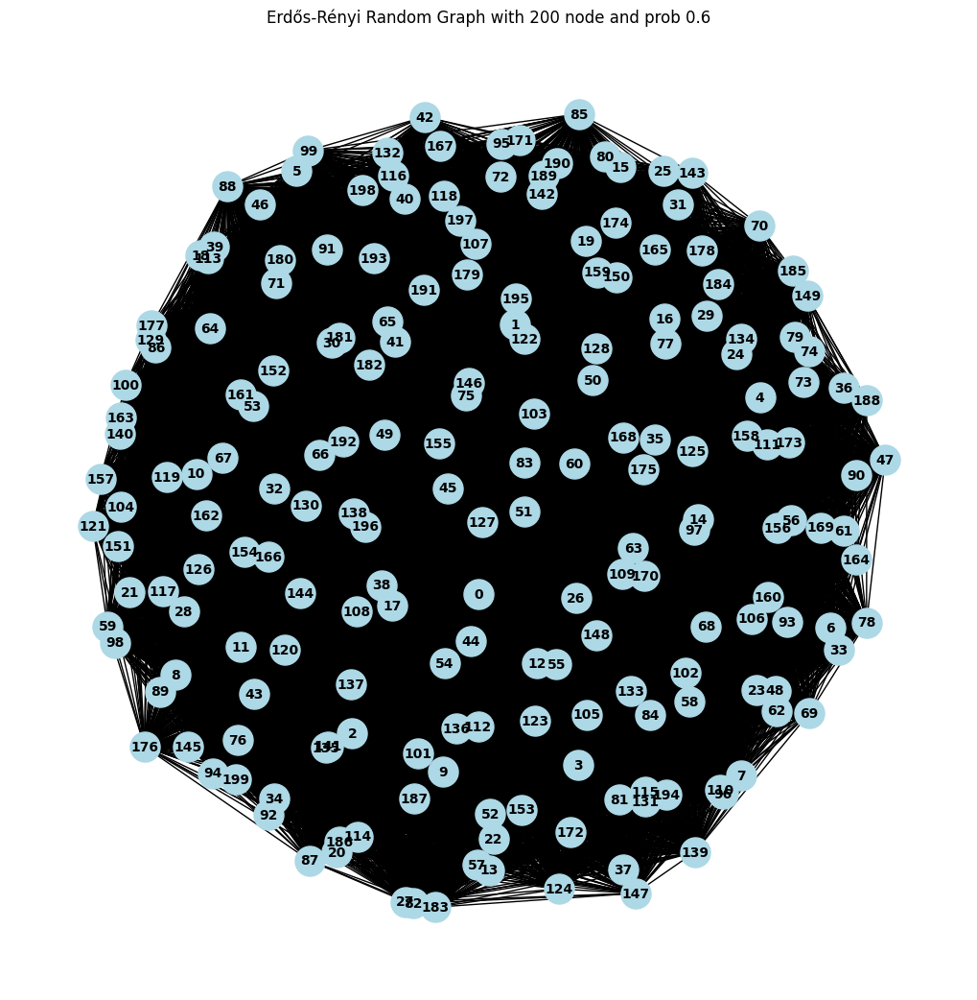



Graph for 300 nodes




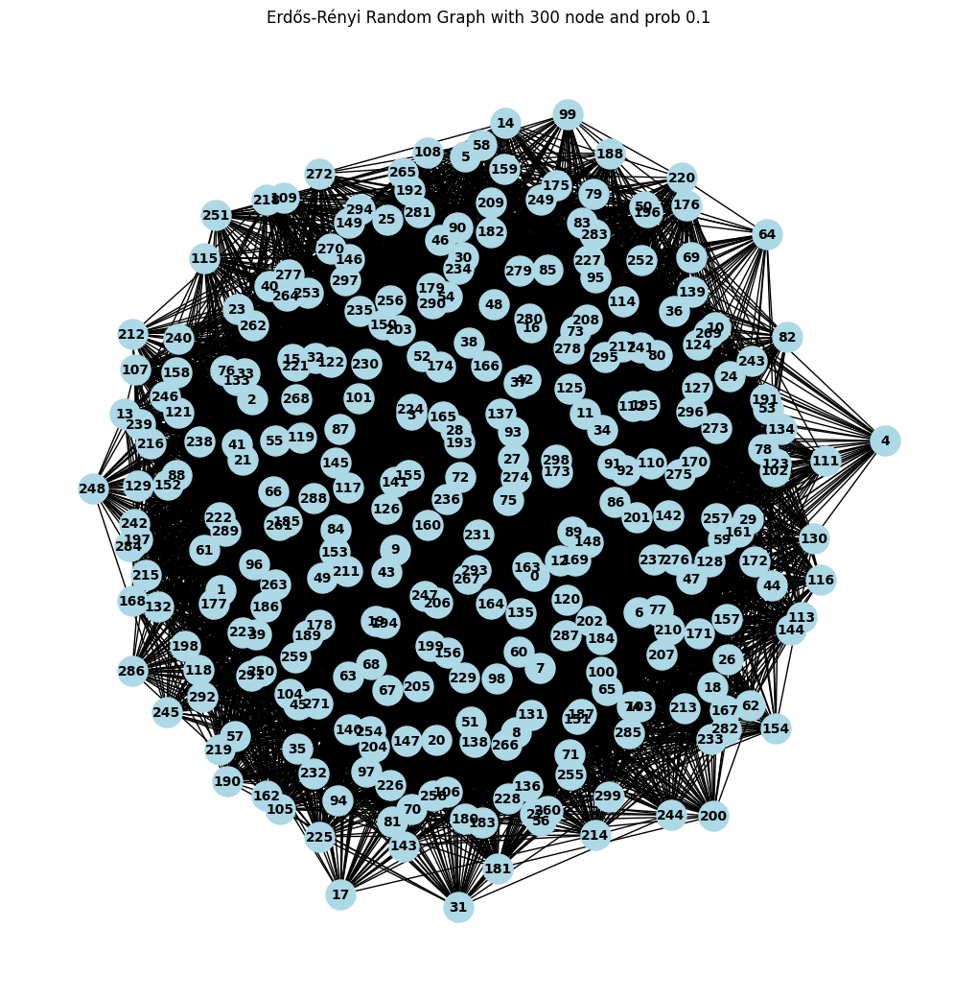

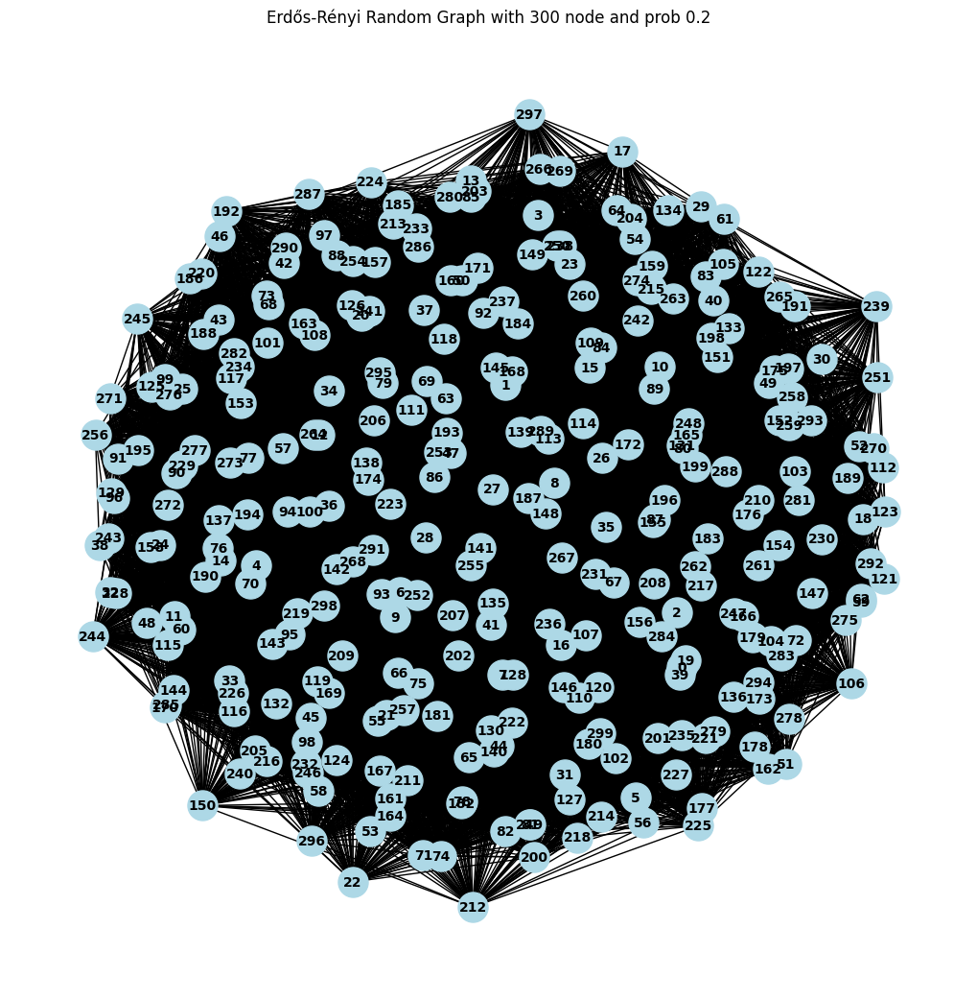

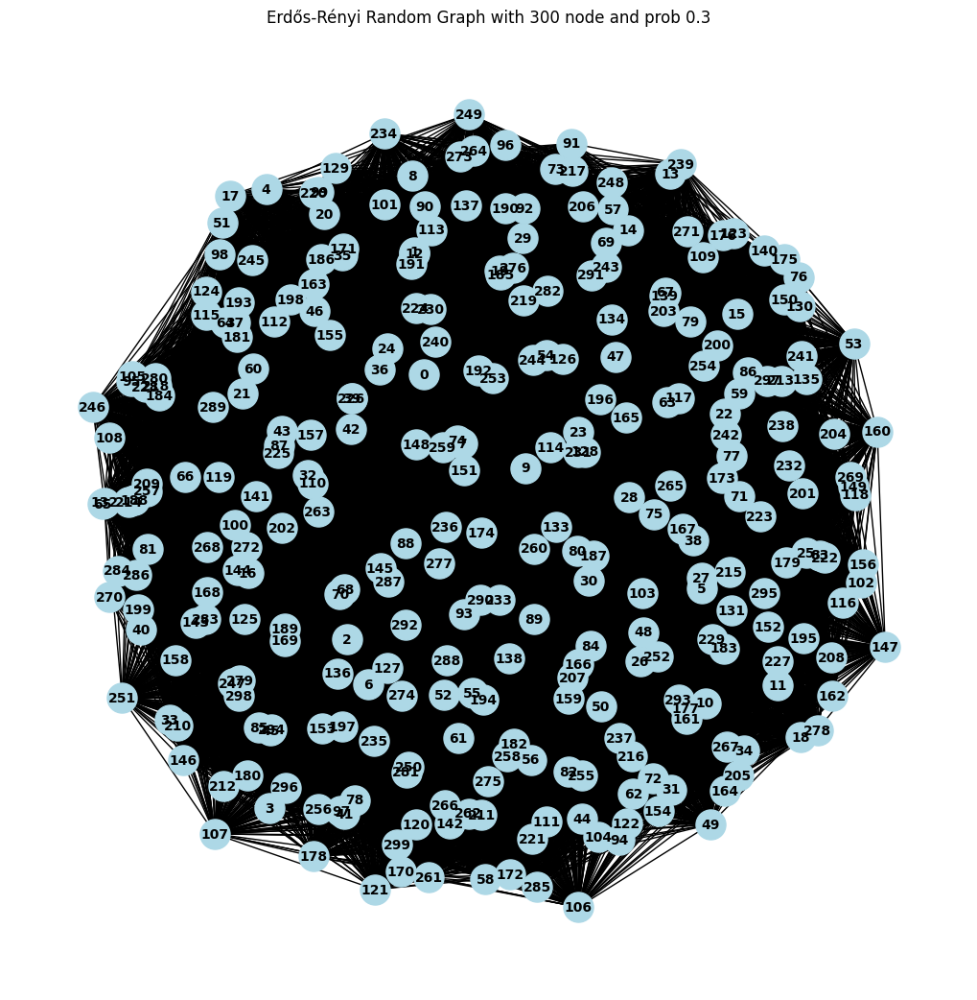

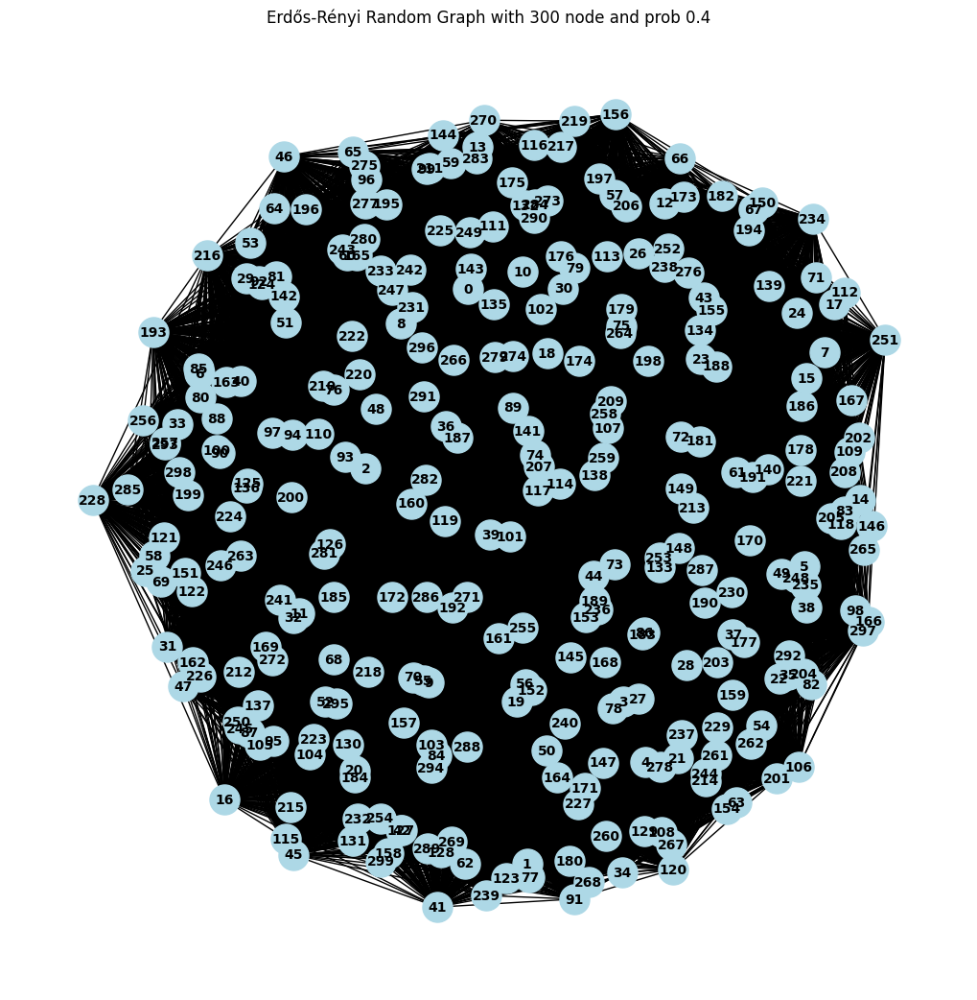

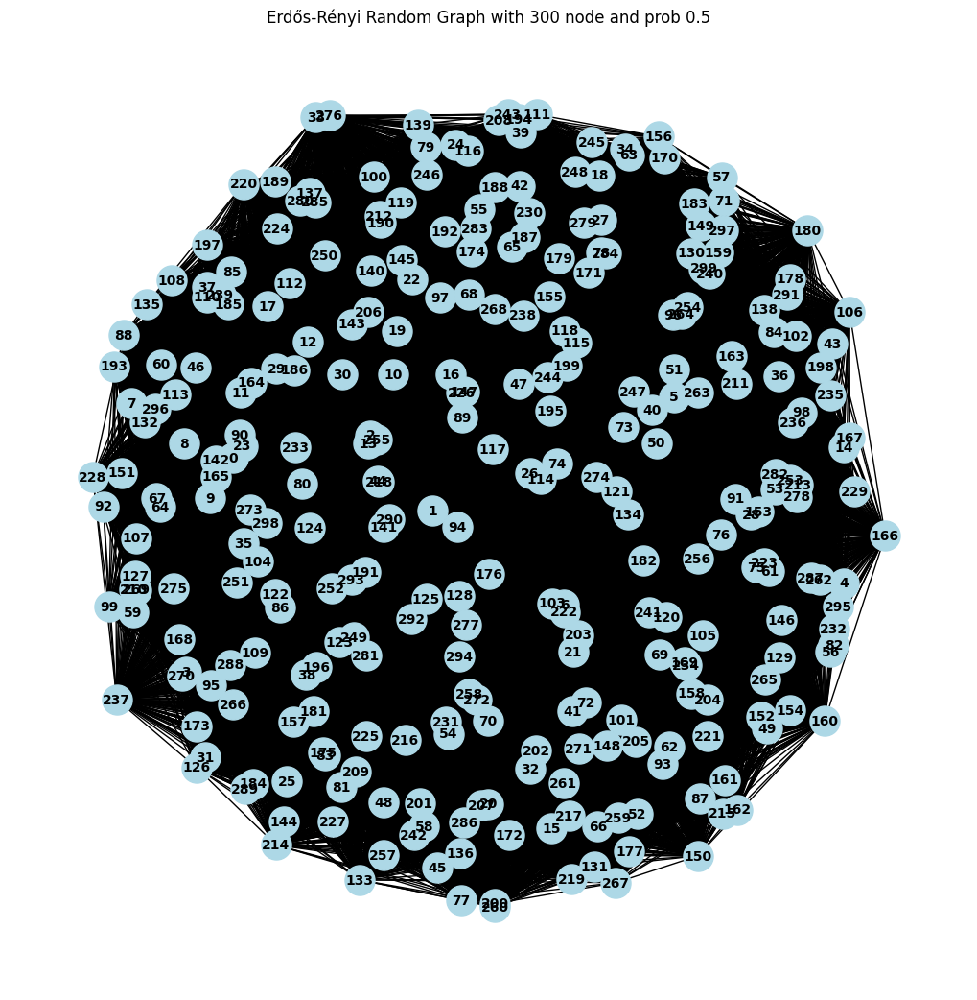

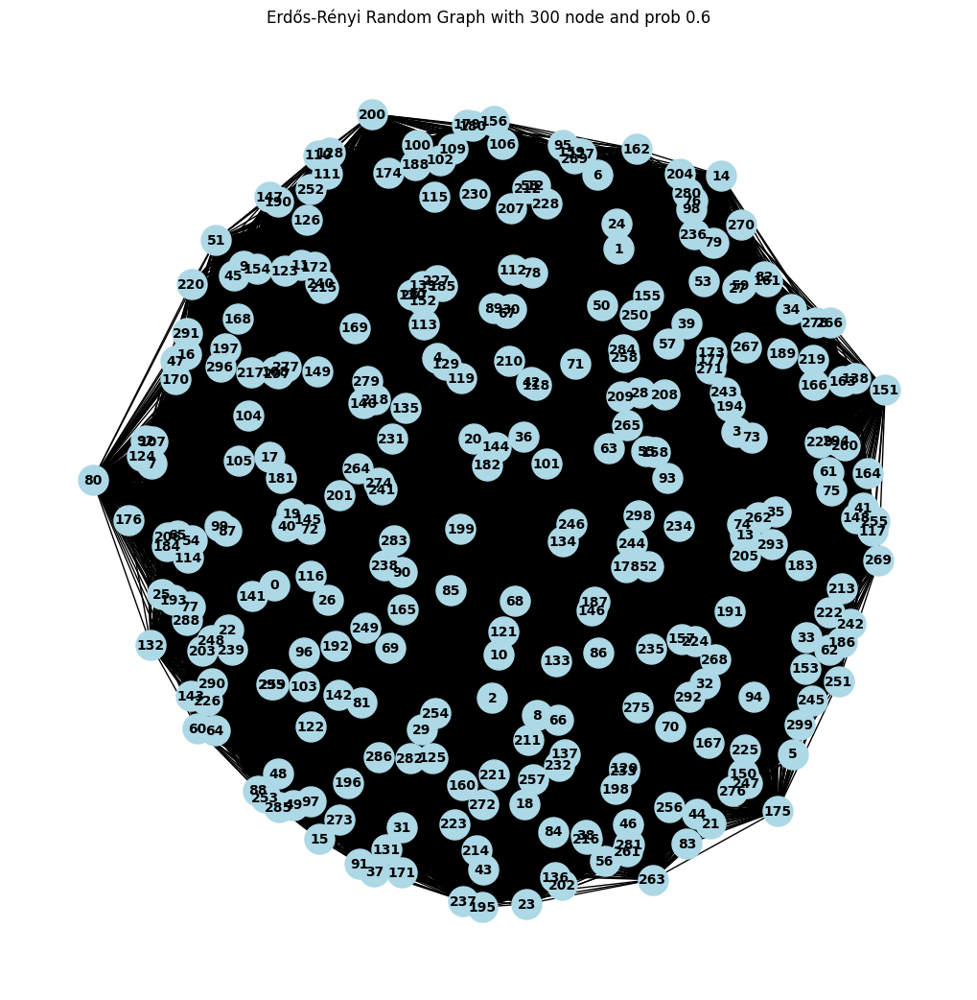



Graph for 400 nodes




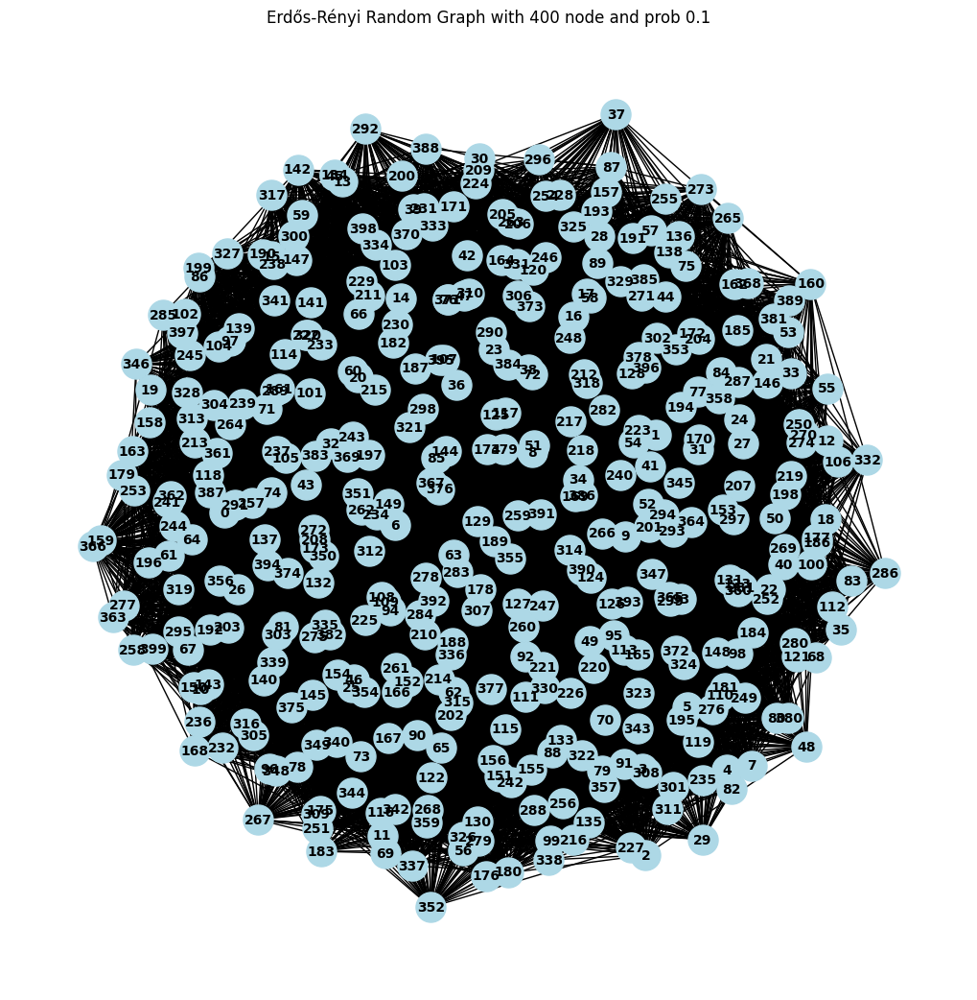

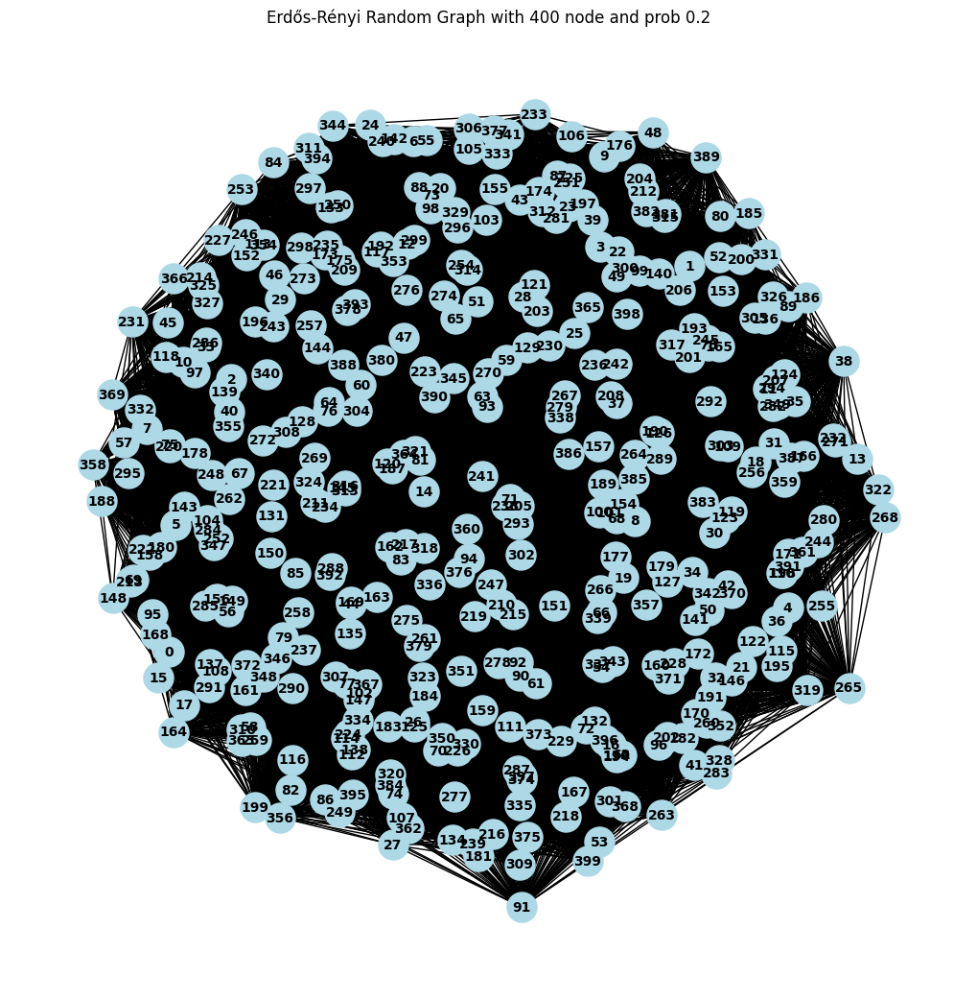

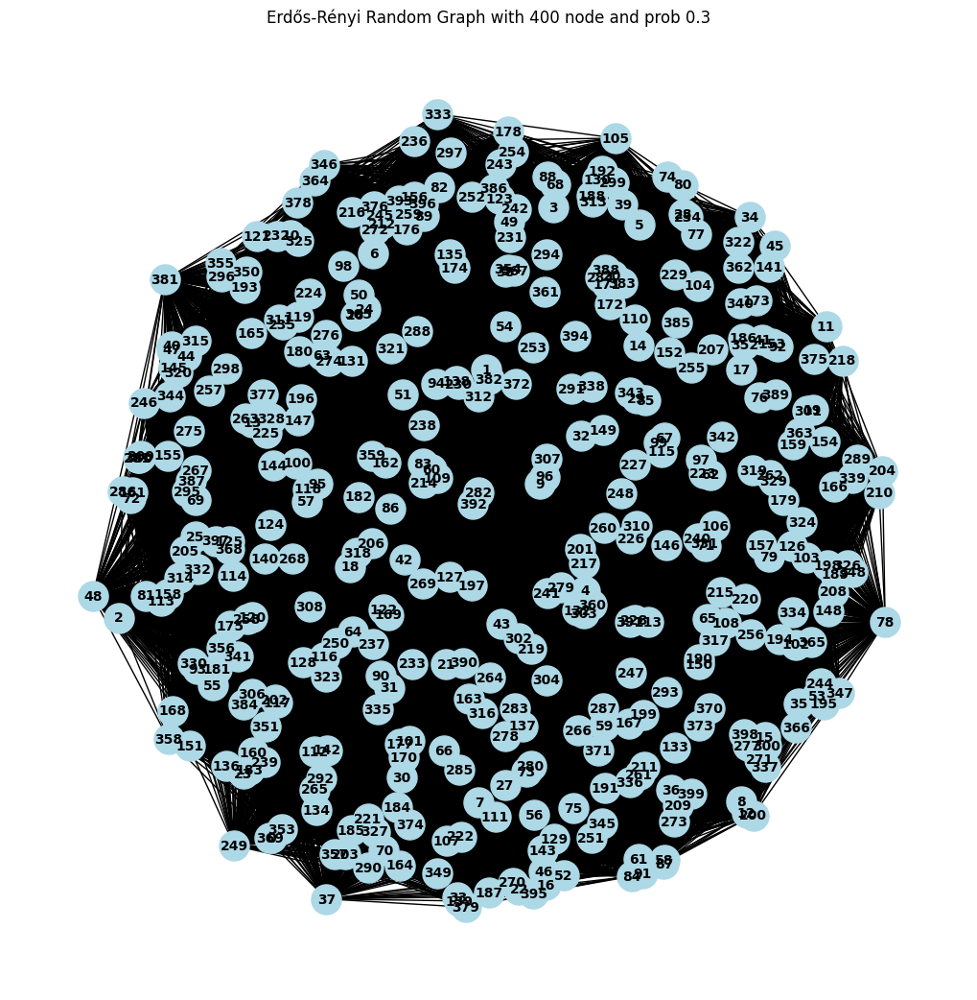

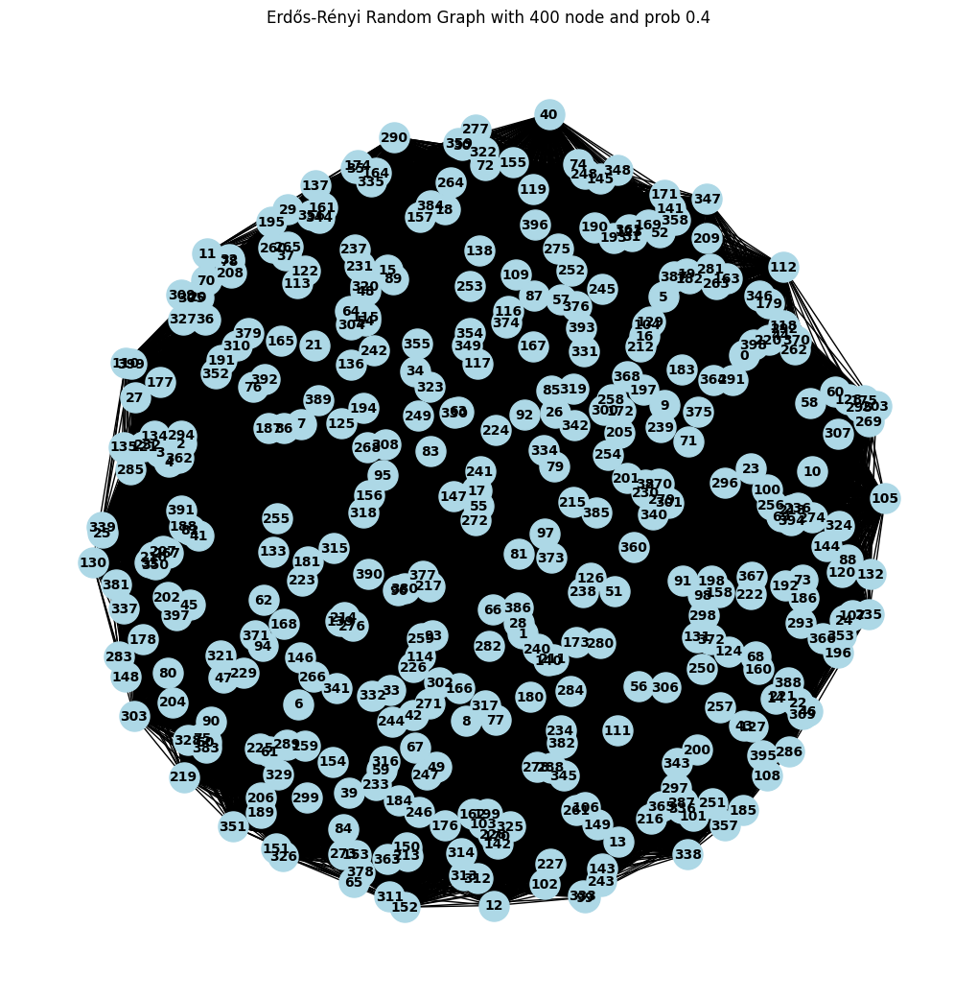

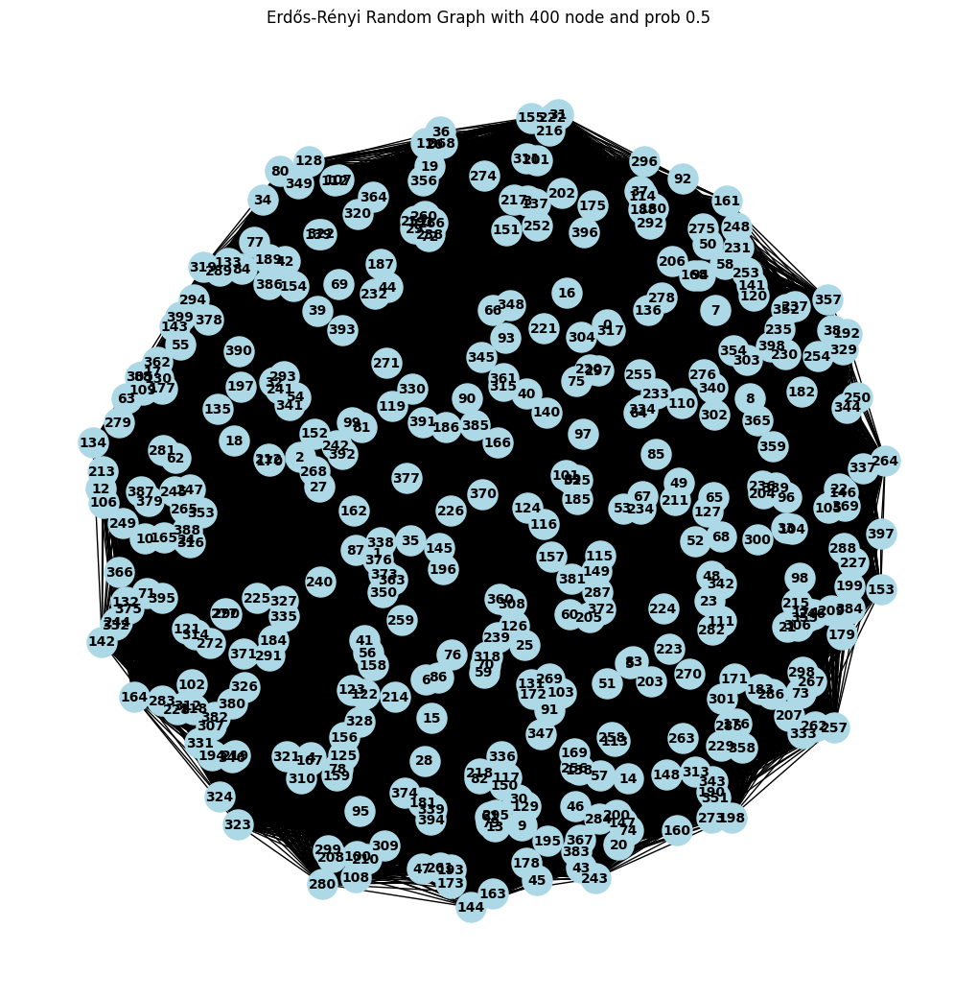

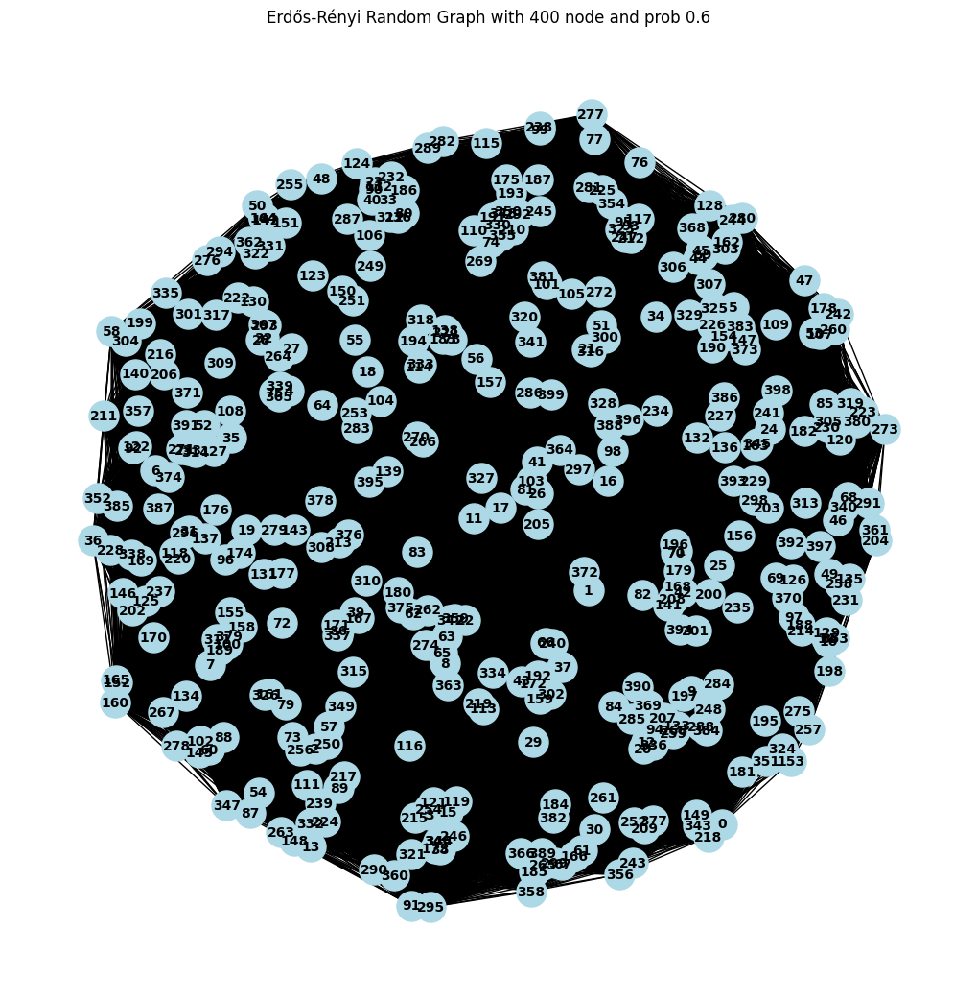



Graph for 500 nodes




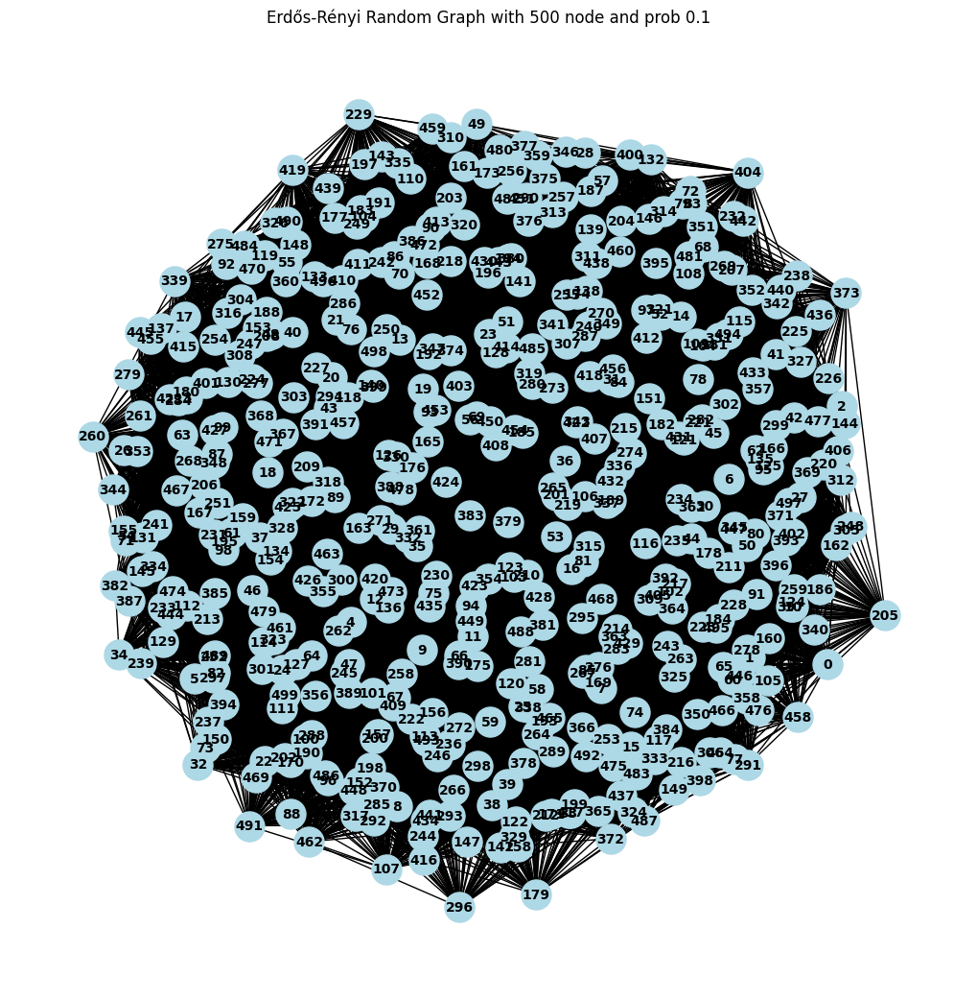

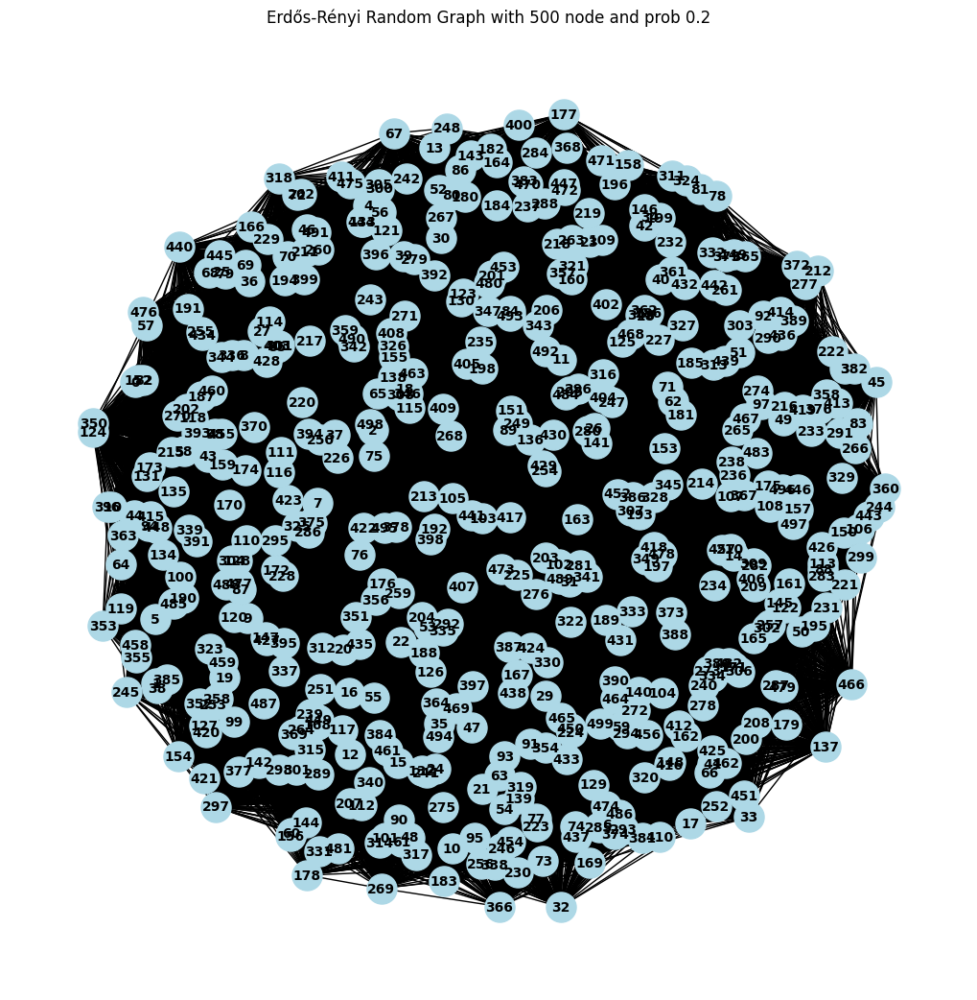

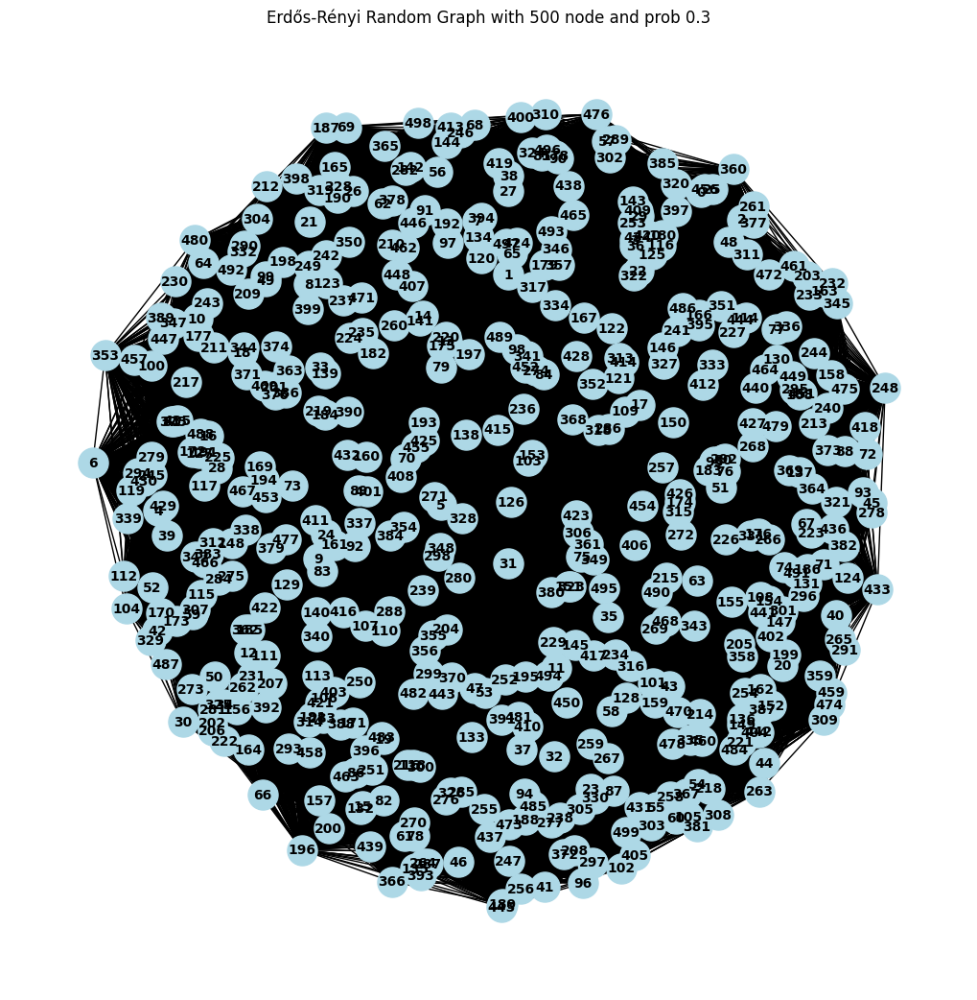

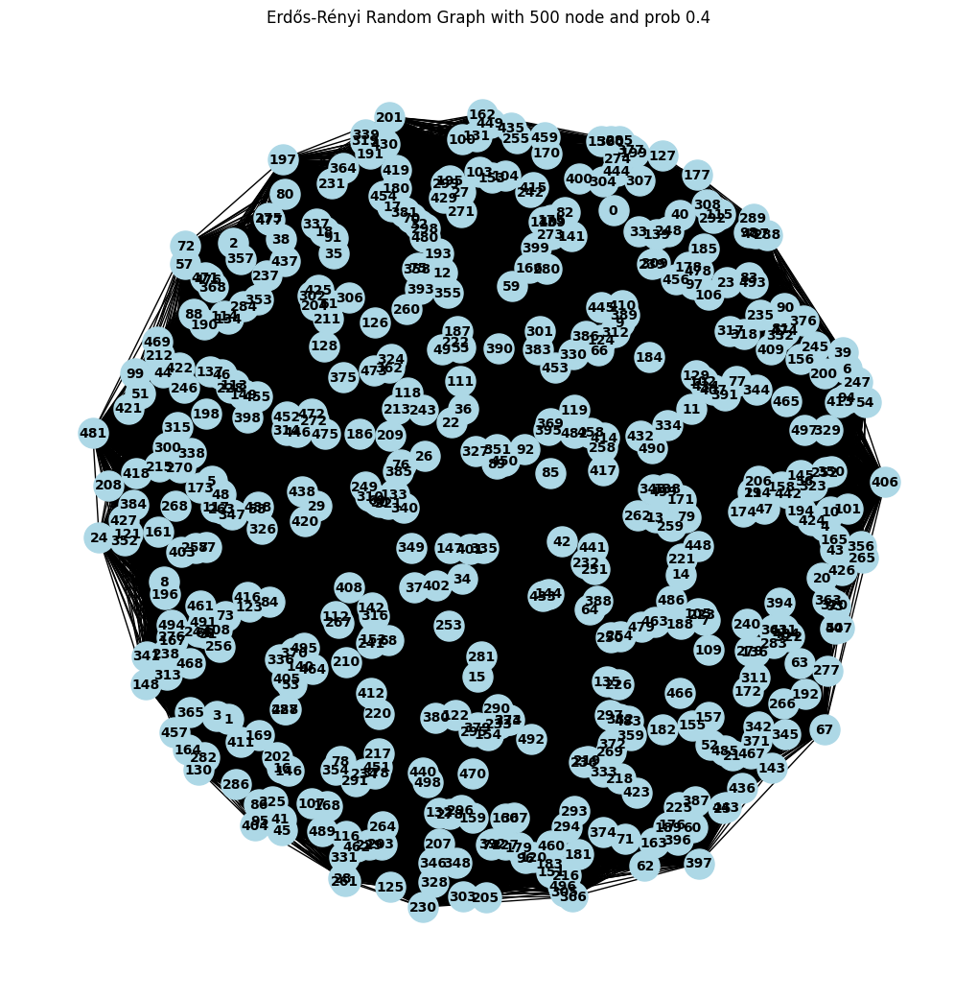

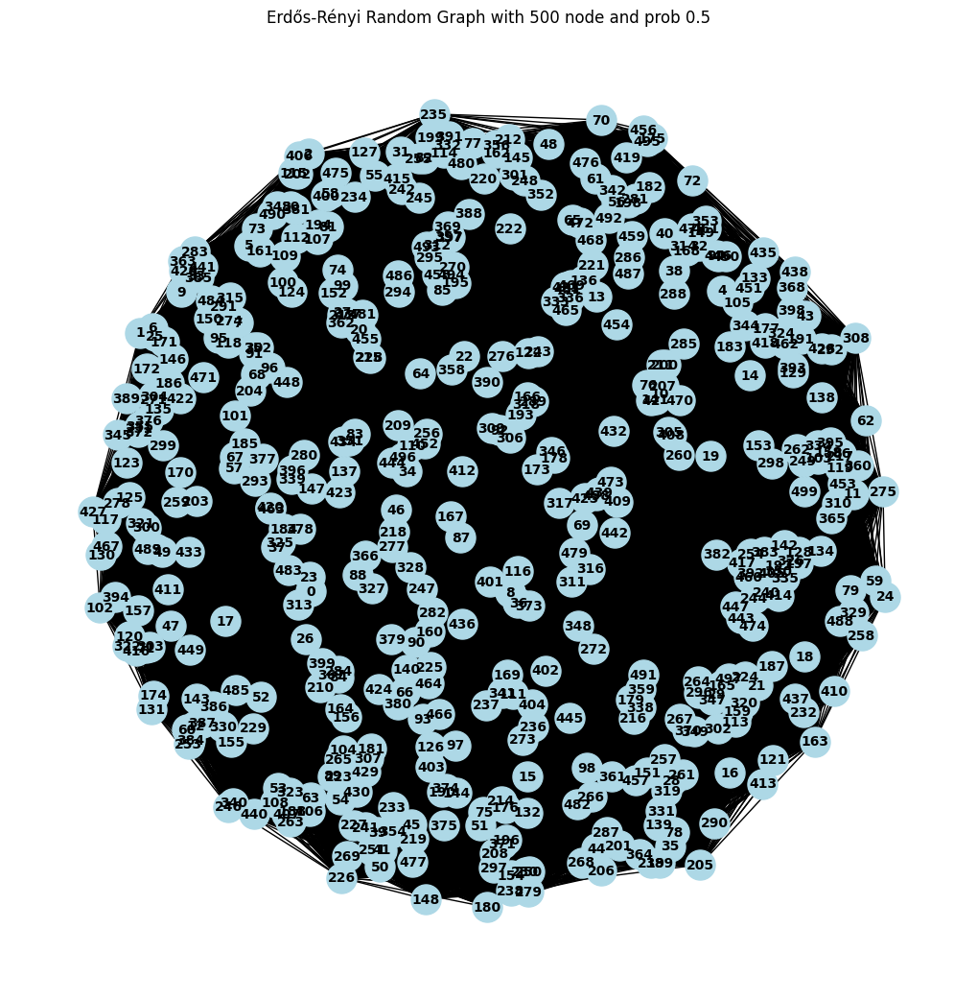

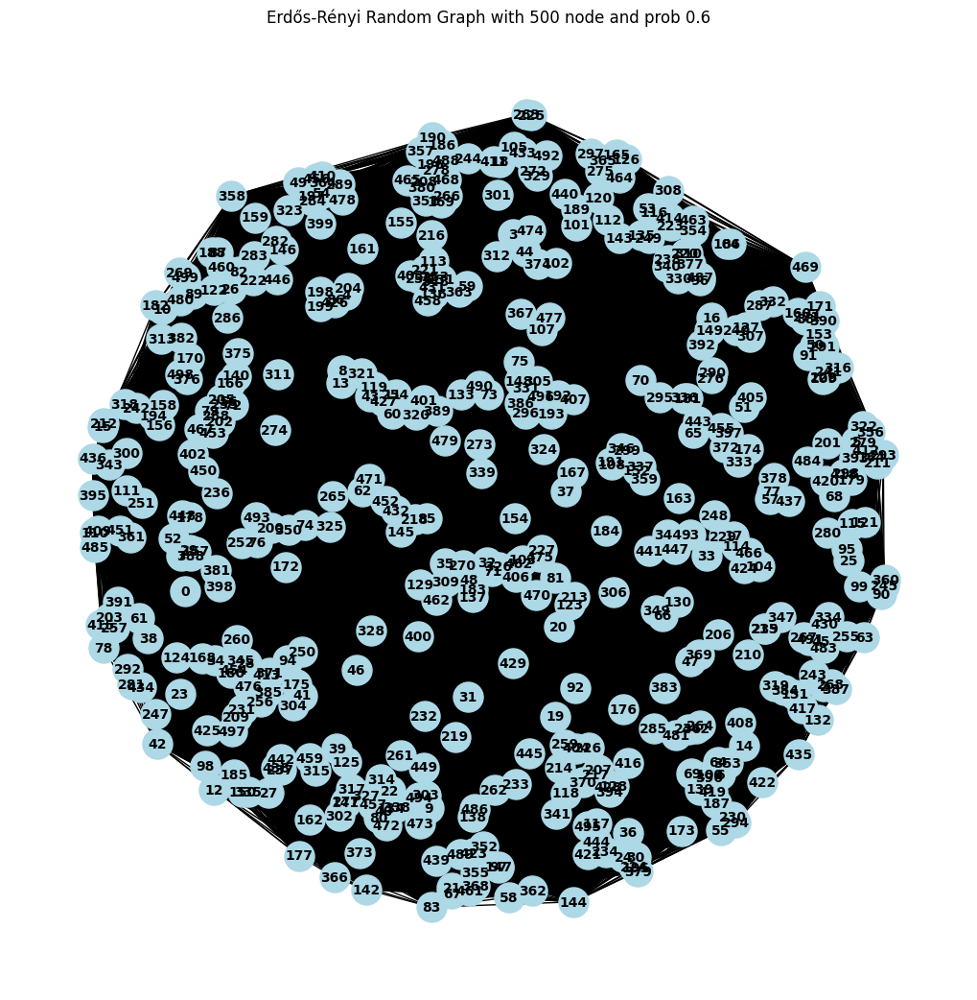



Graph for 600 nodes




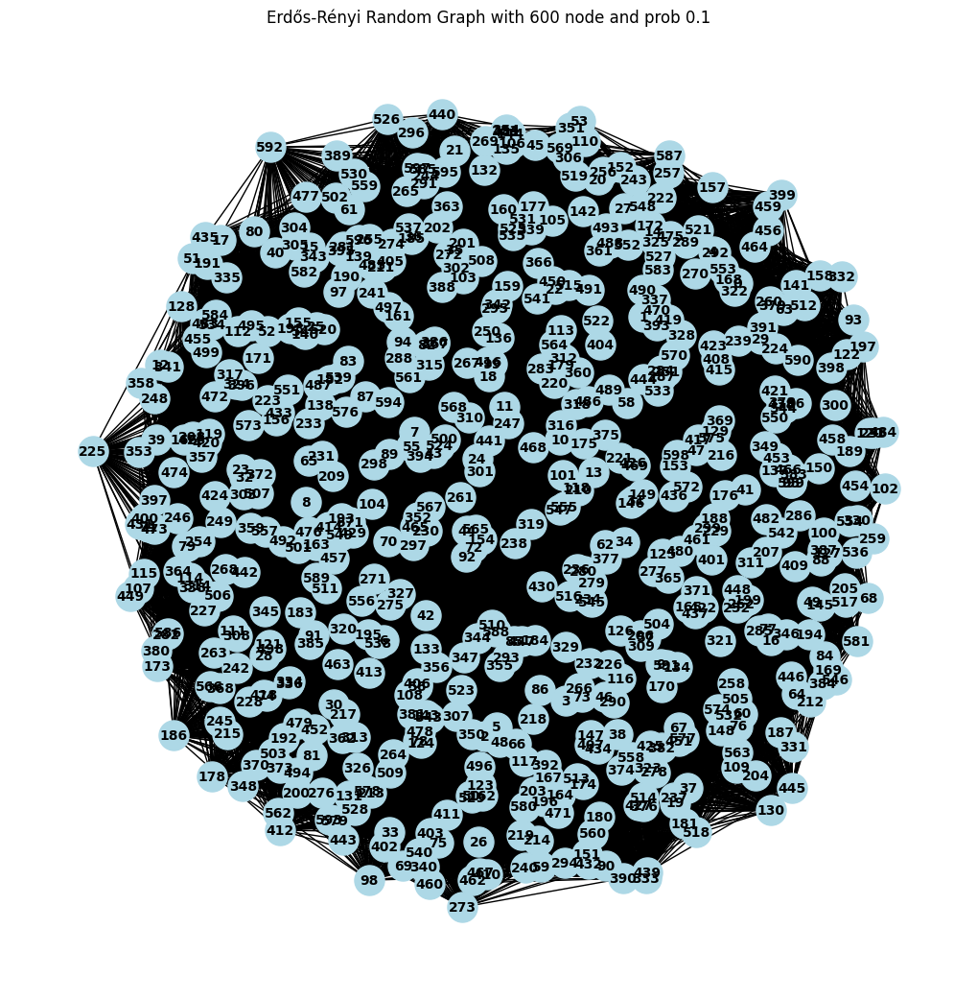

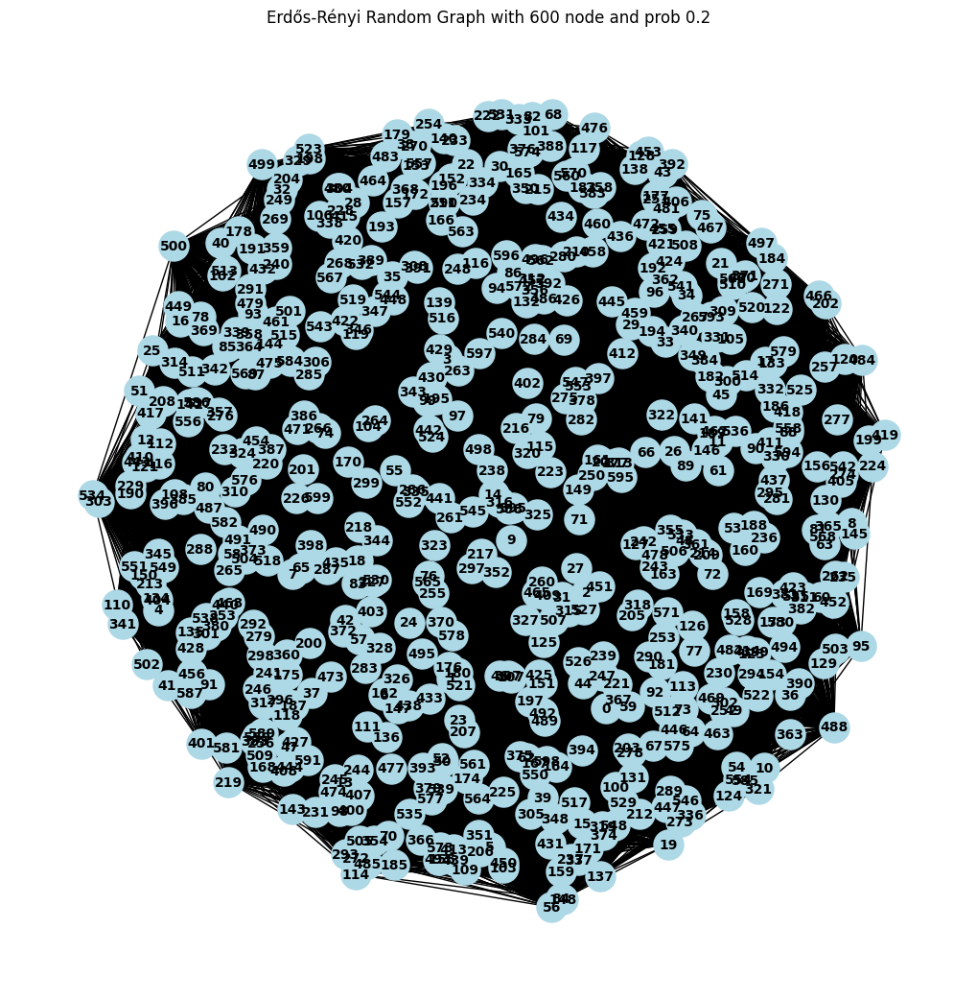

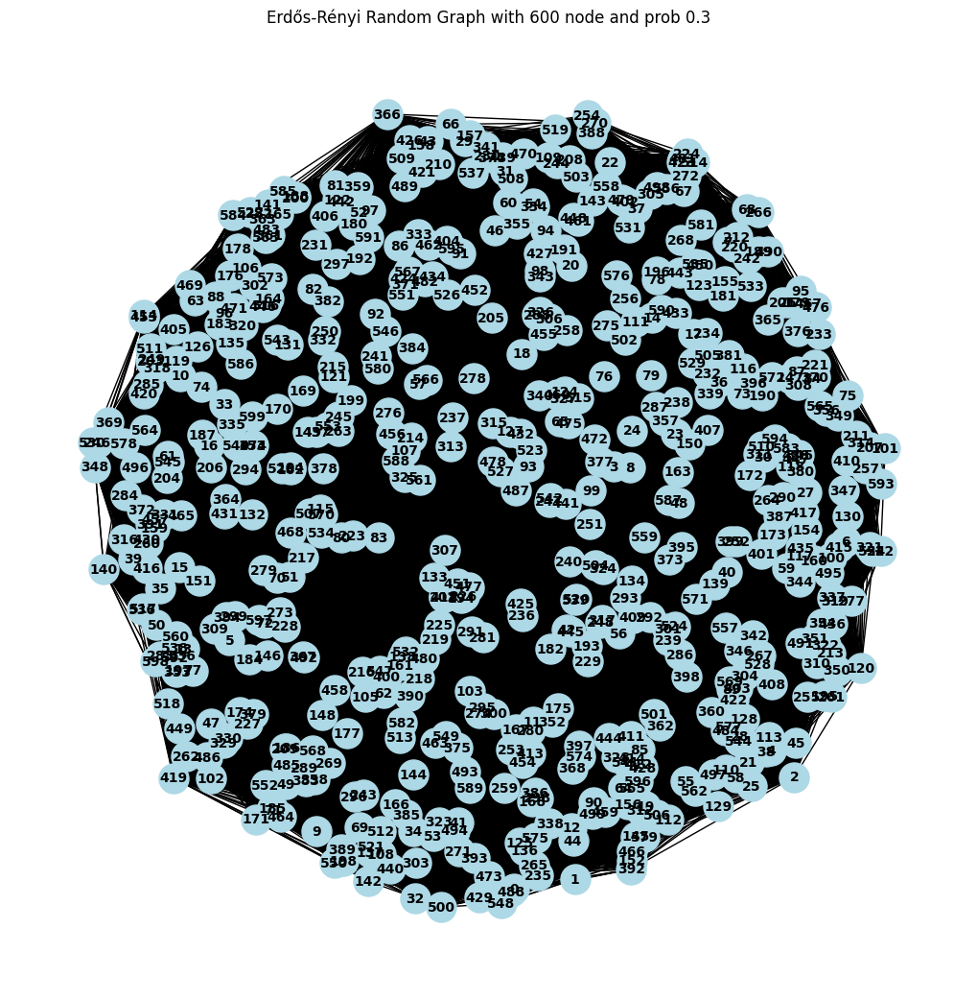

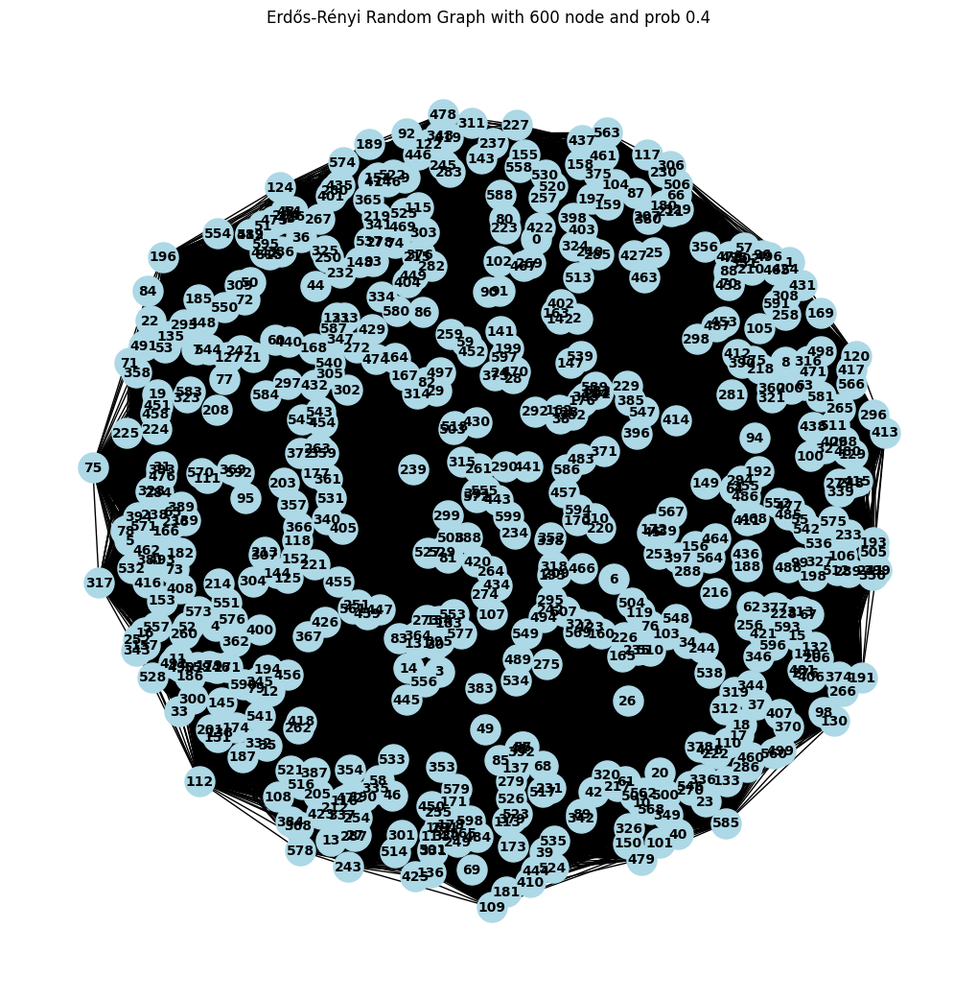

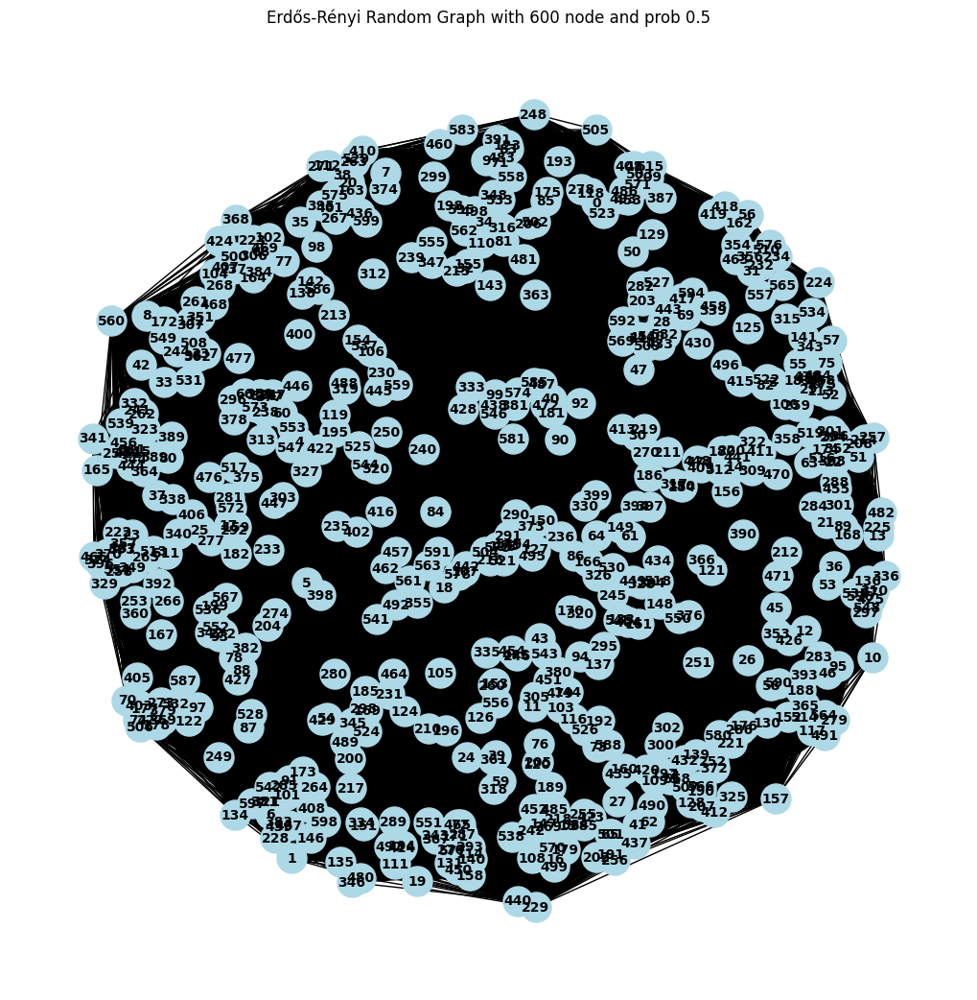

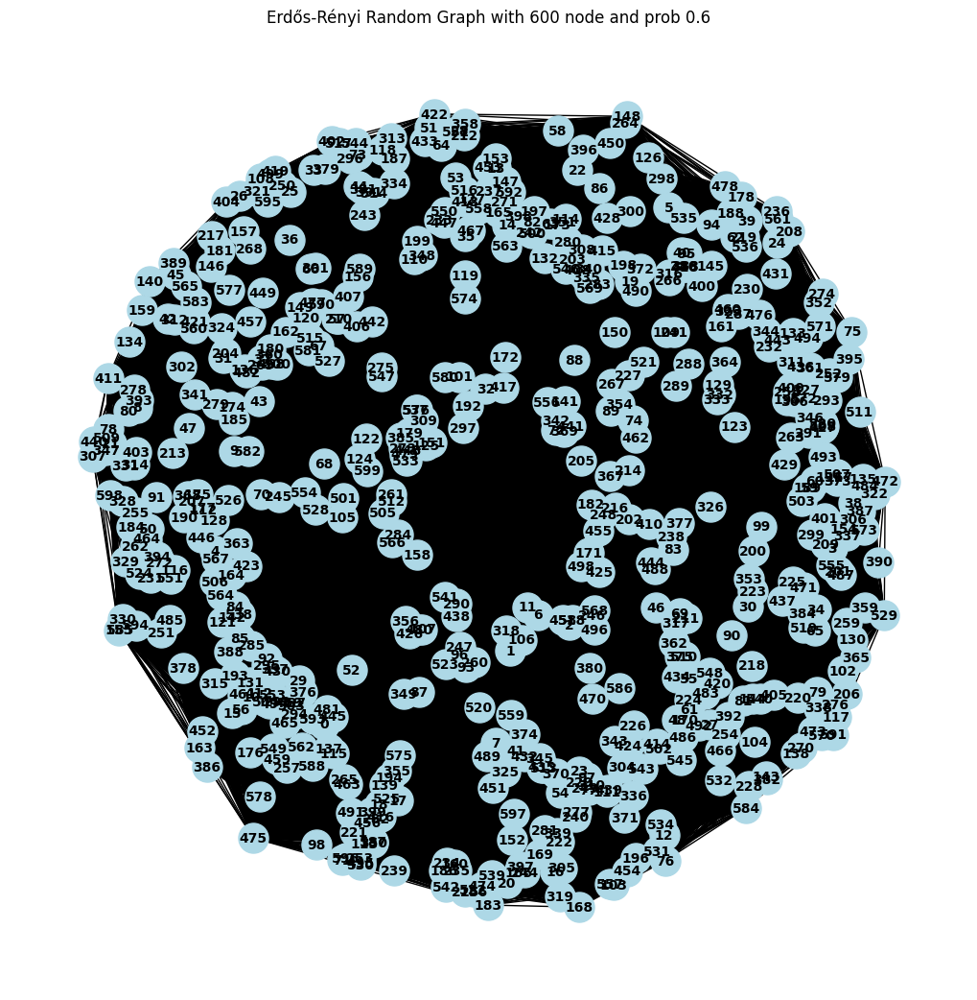



Graph for 700 nodes




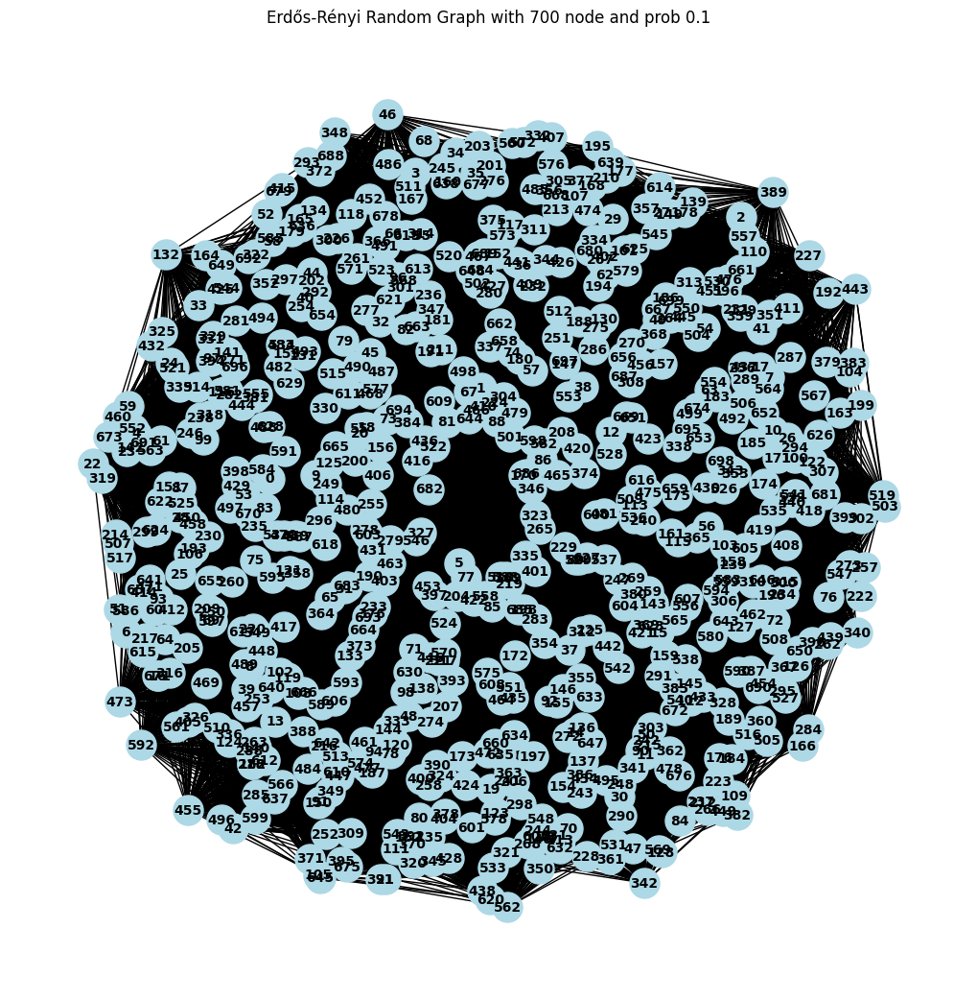

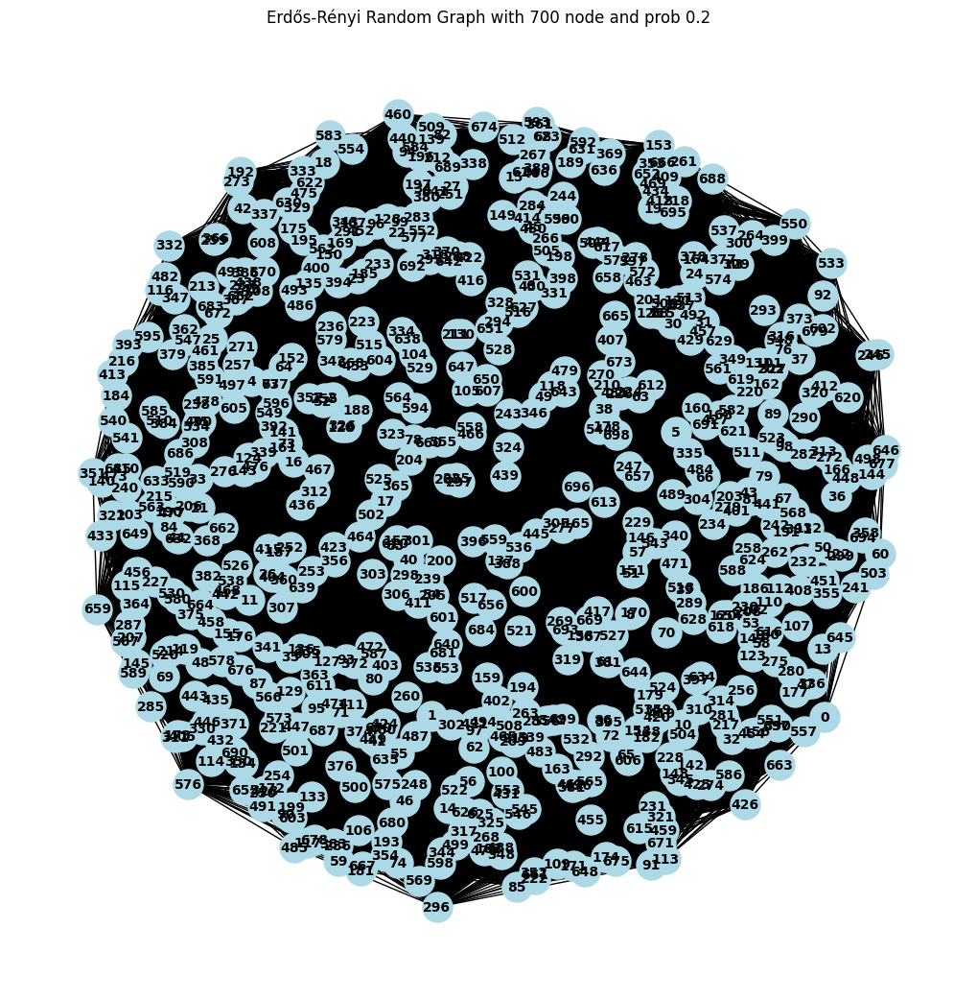

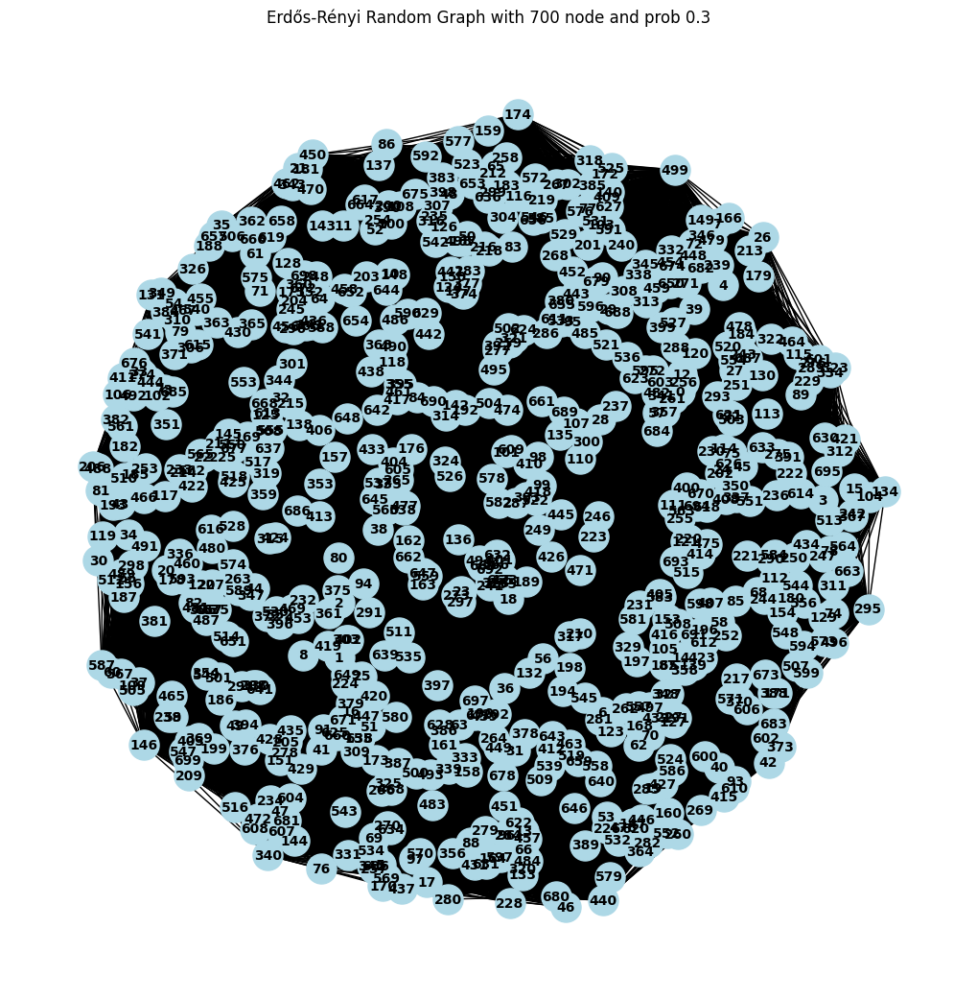

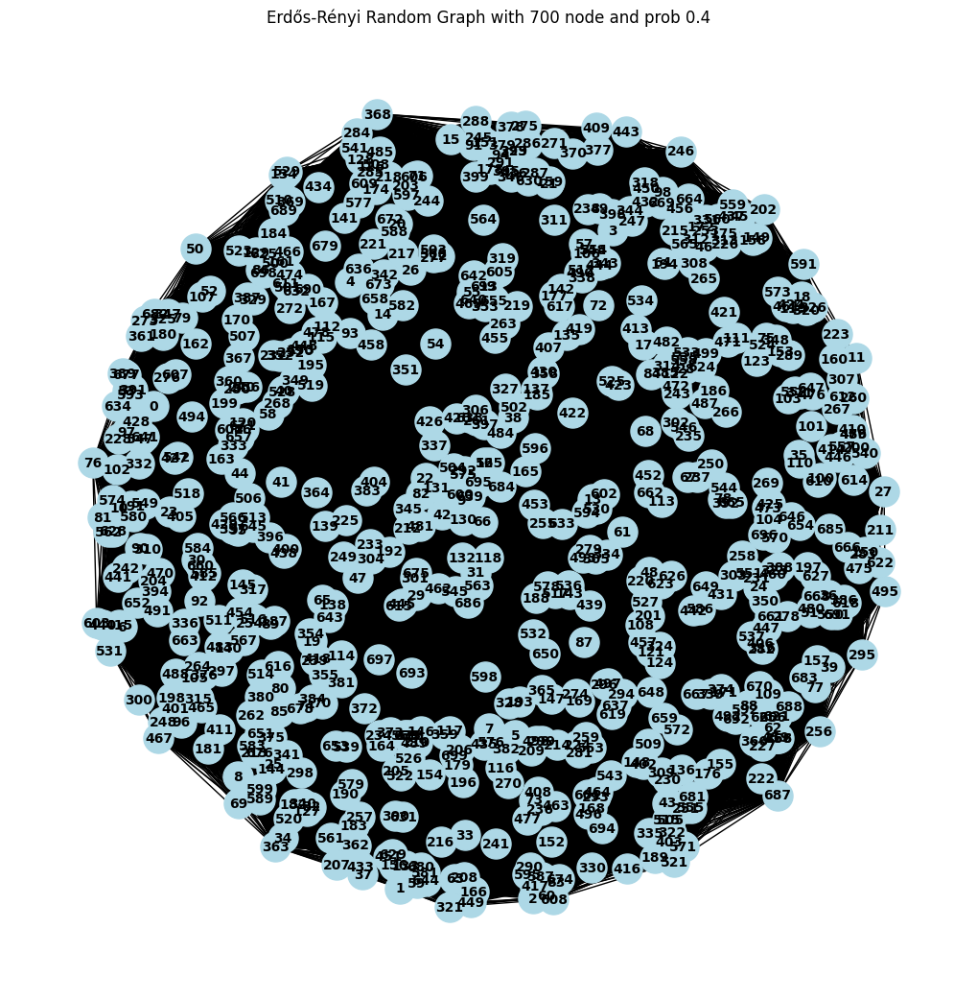

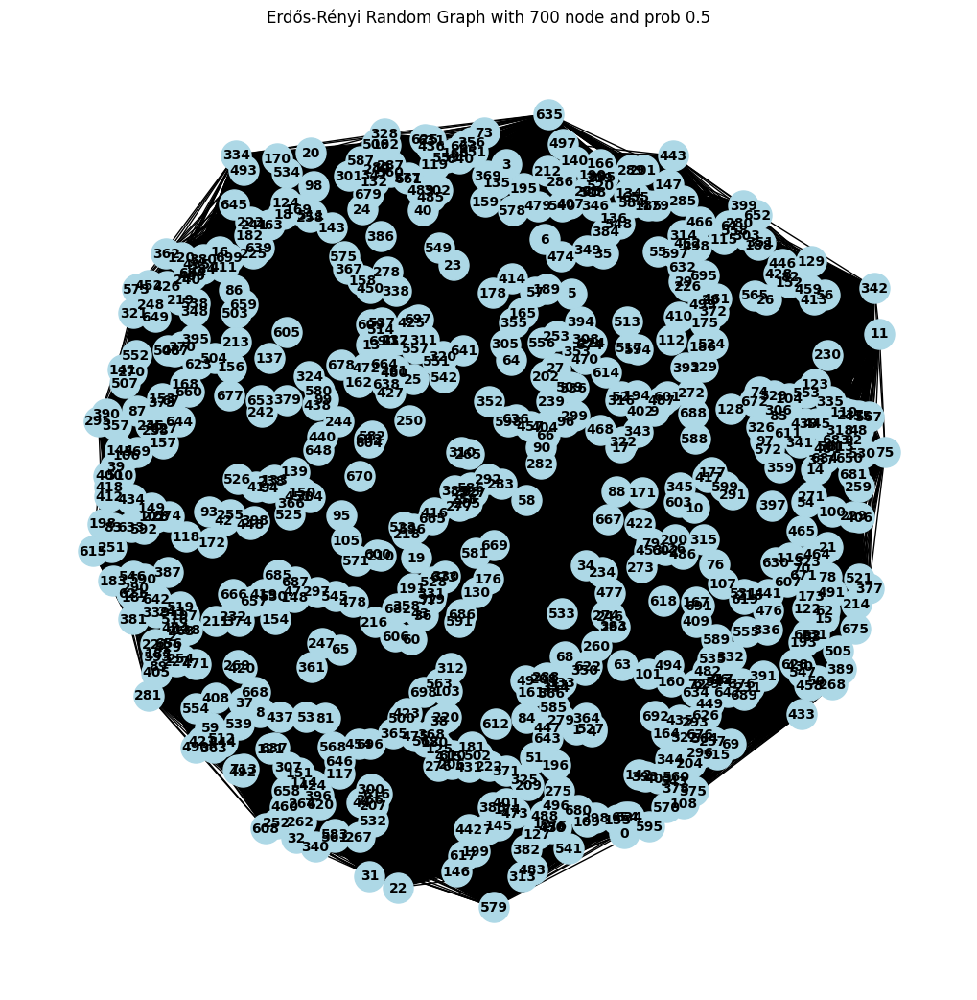

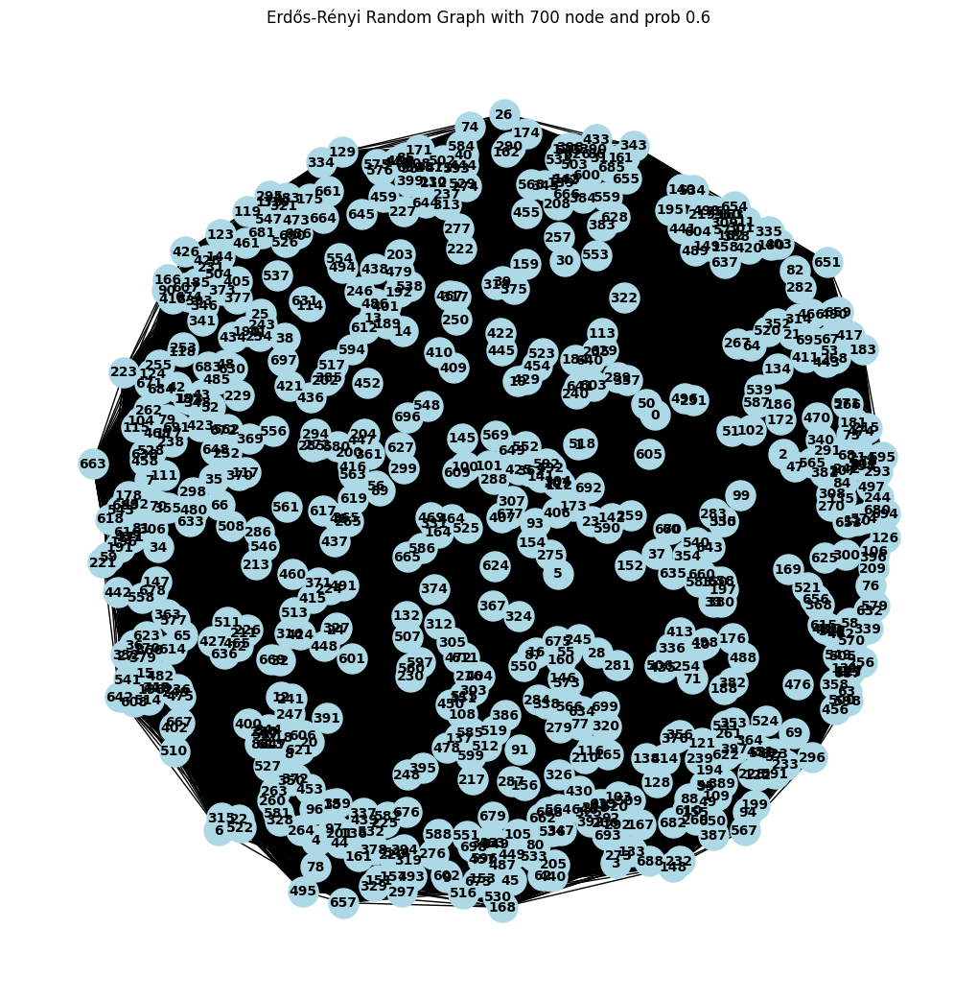



Graph for 800 nodes




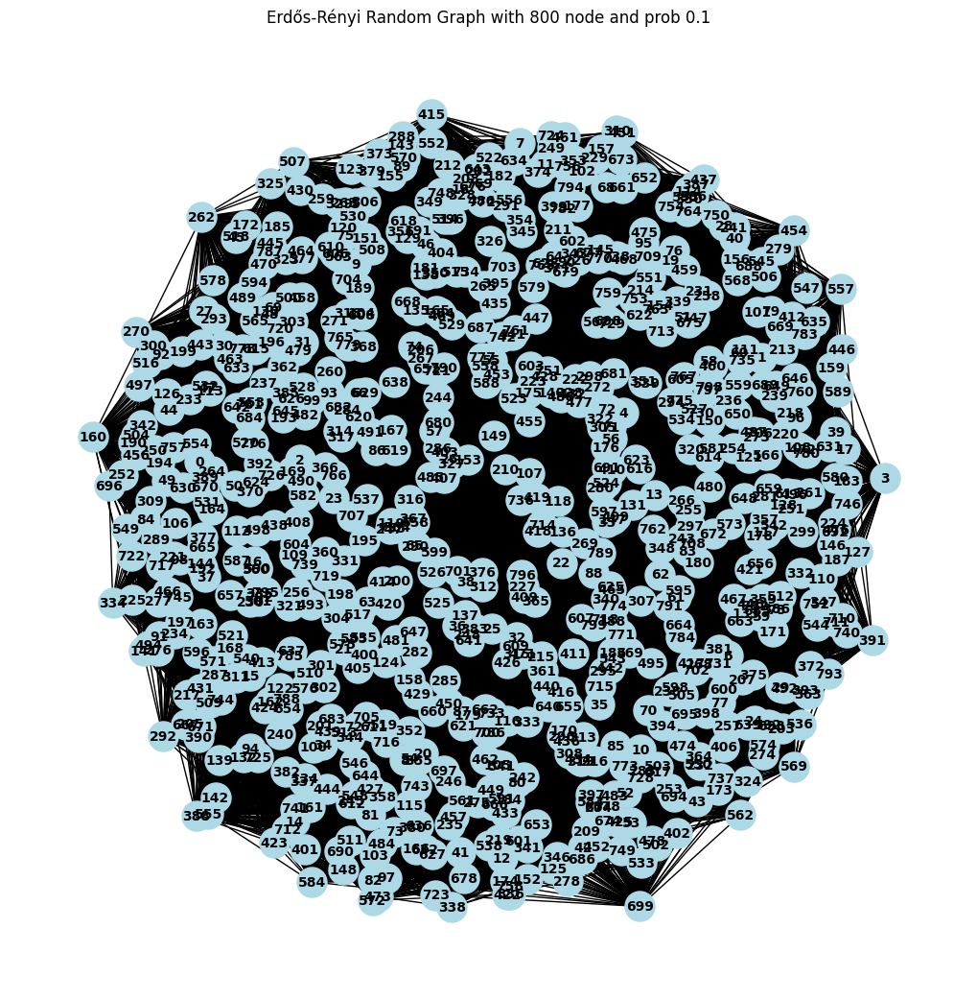

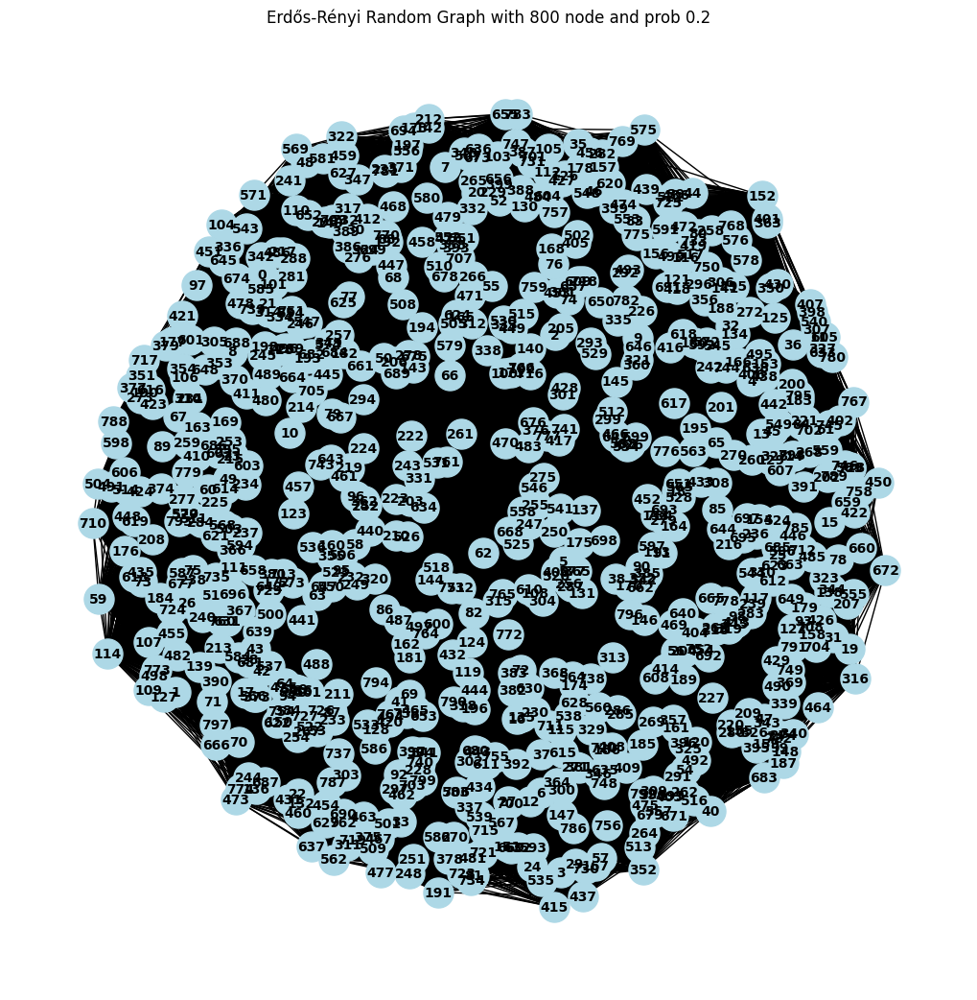

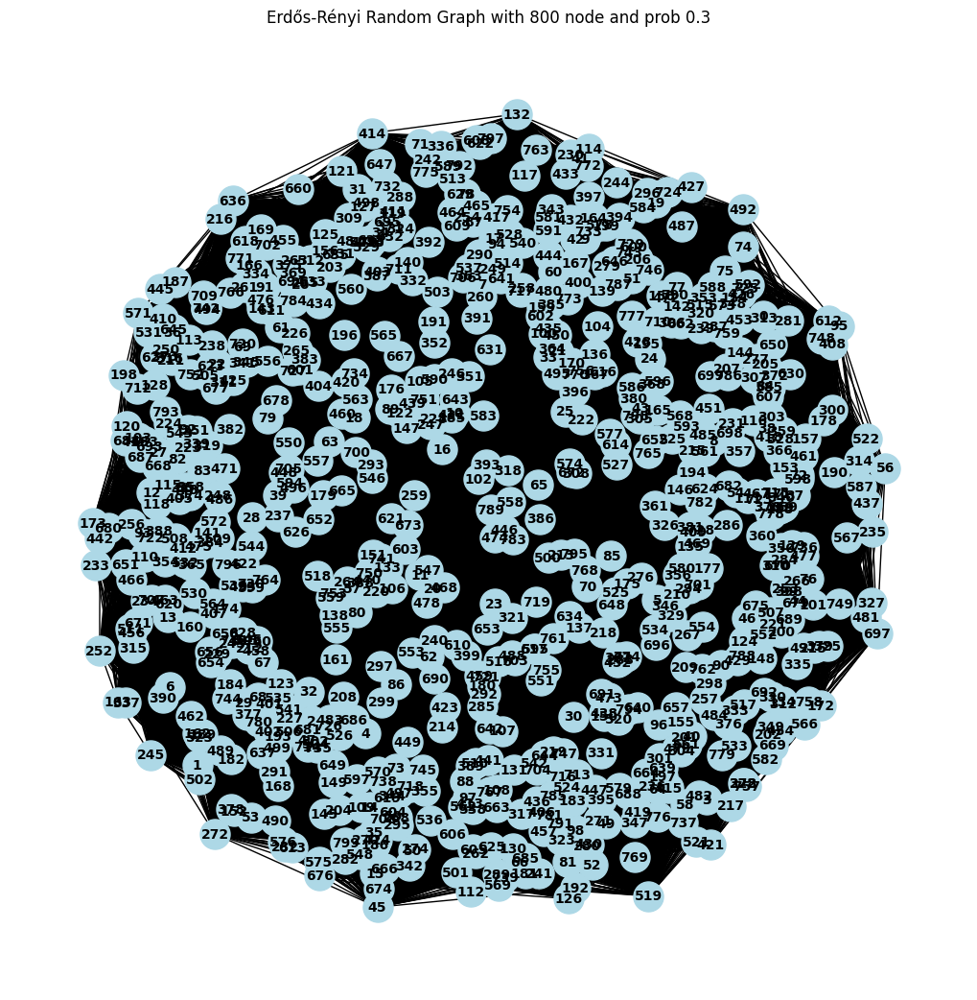

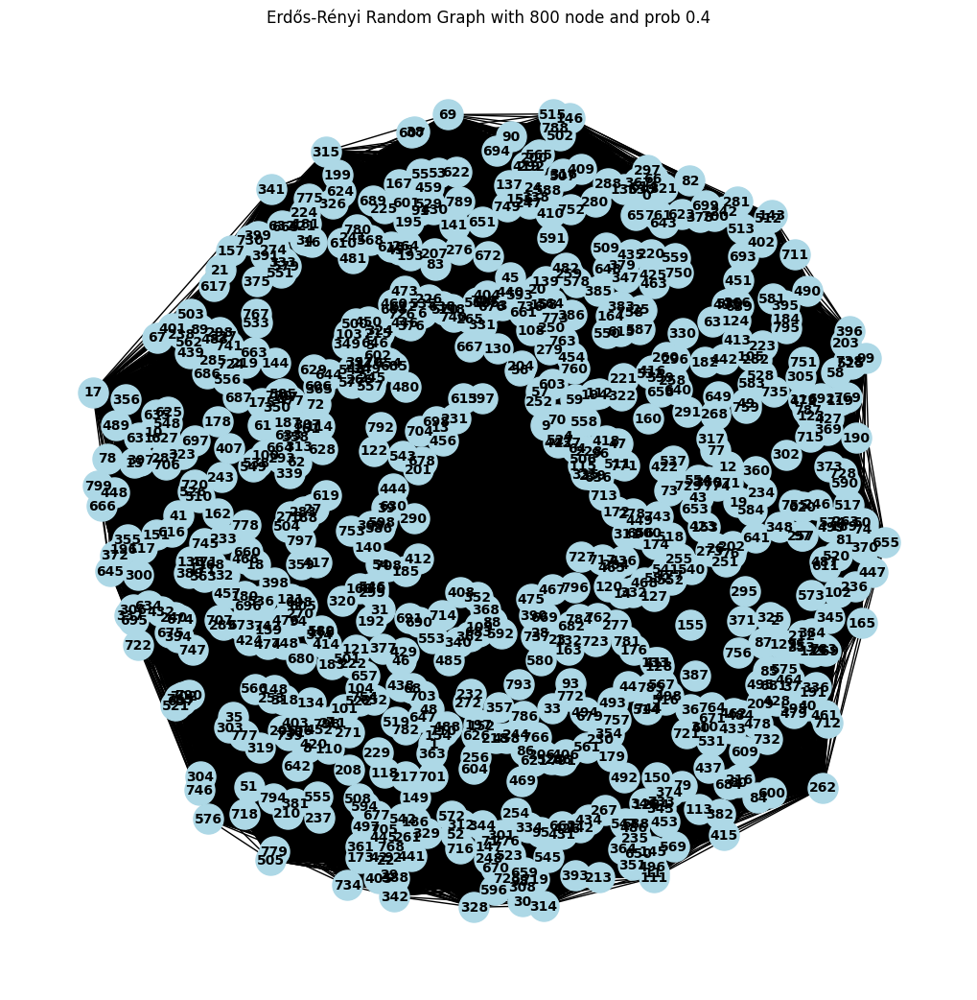

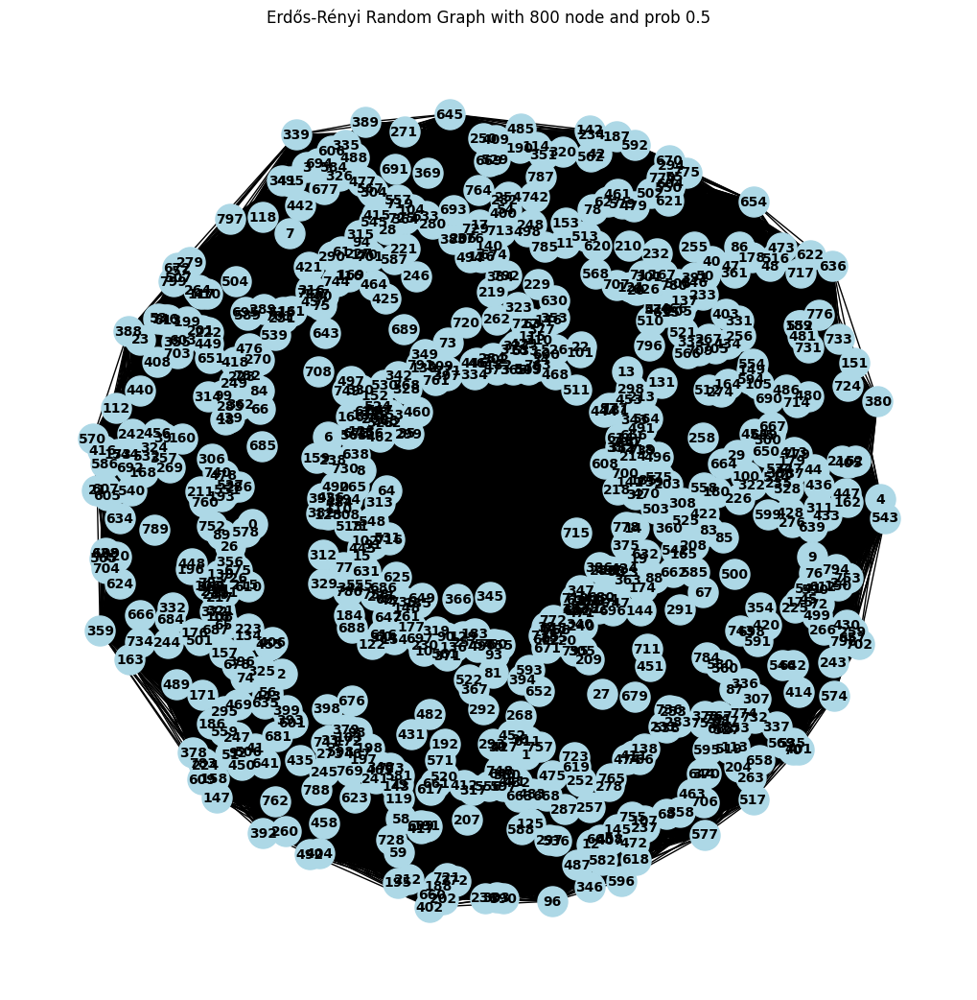

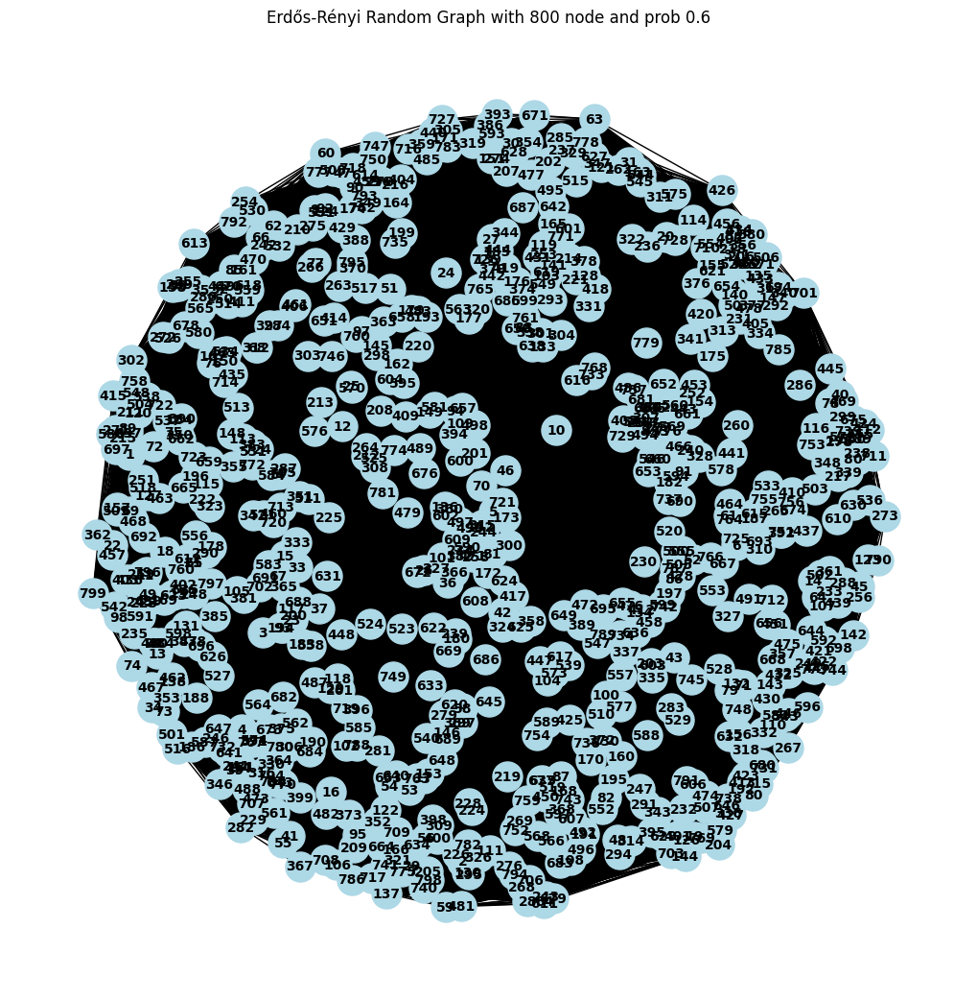



Graph for 900 nodes




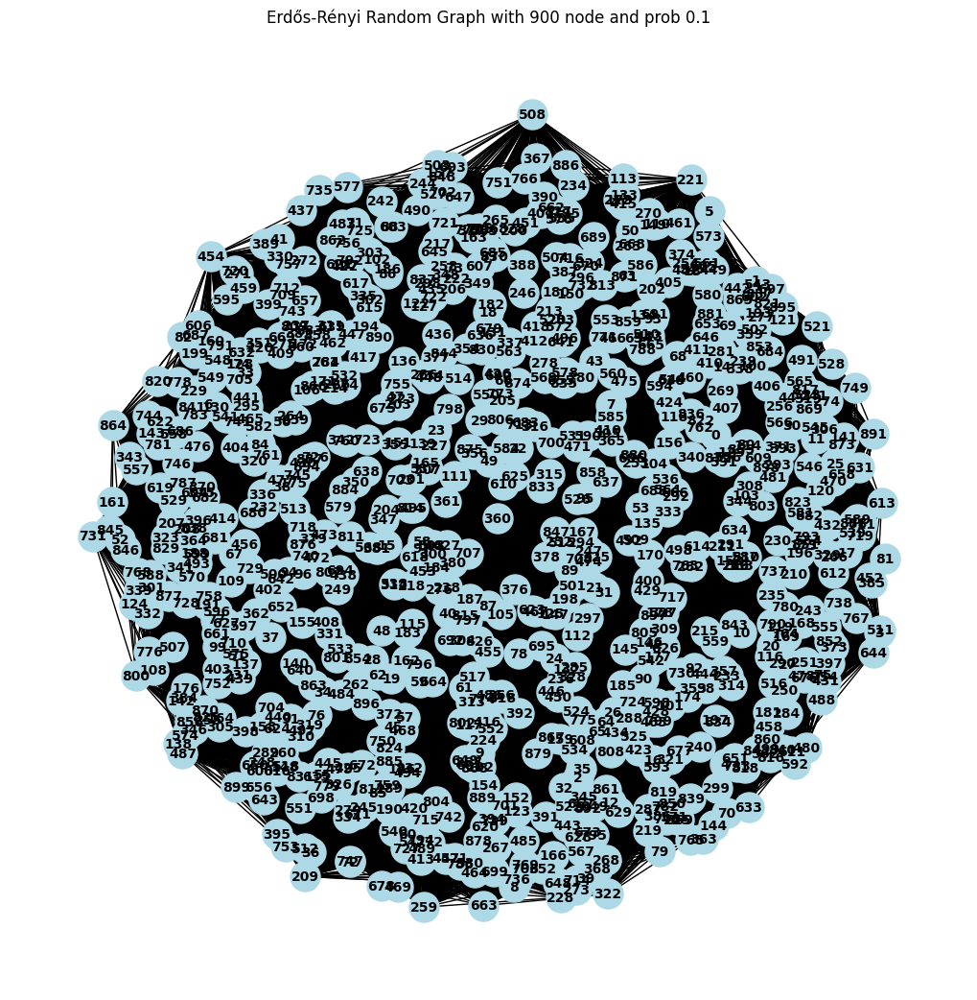

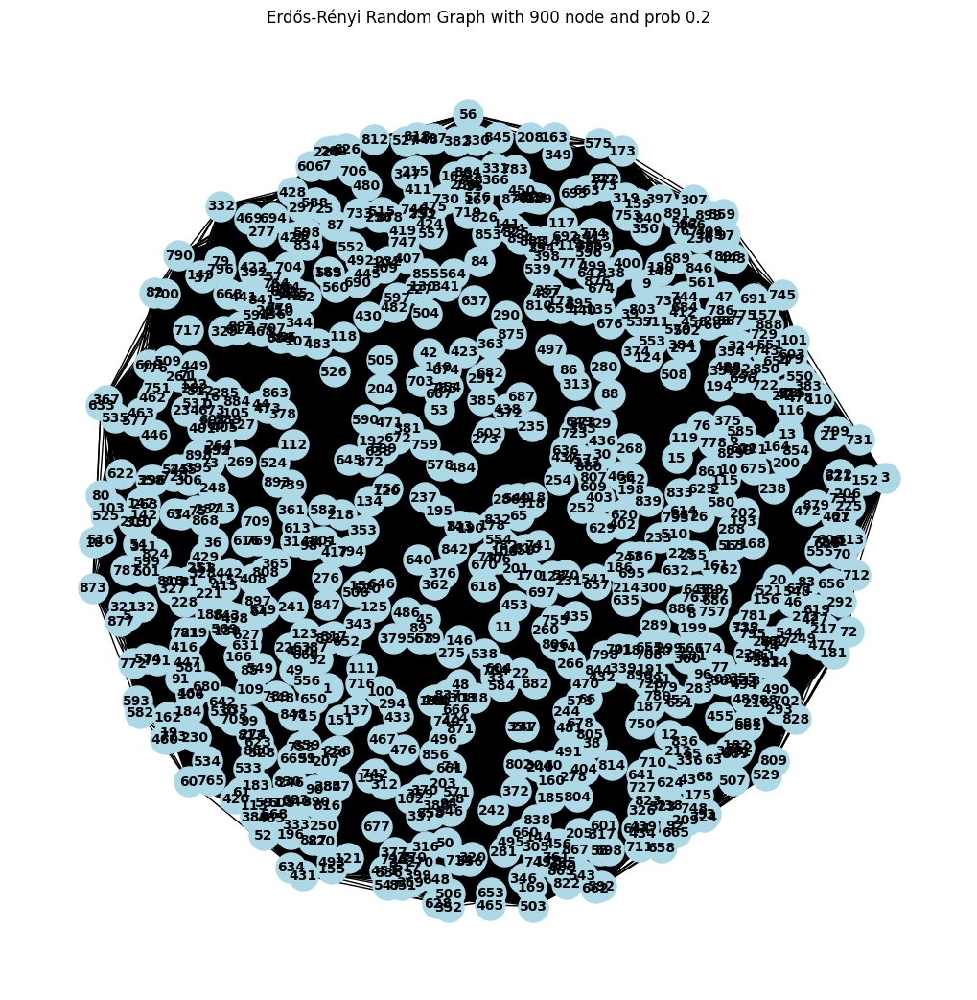

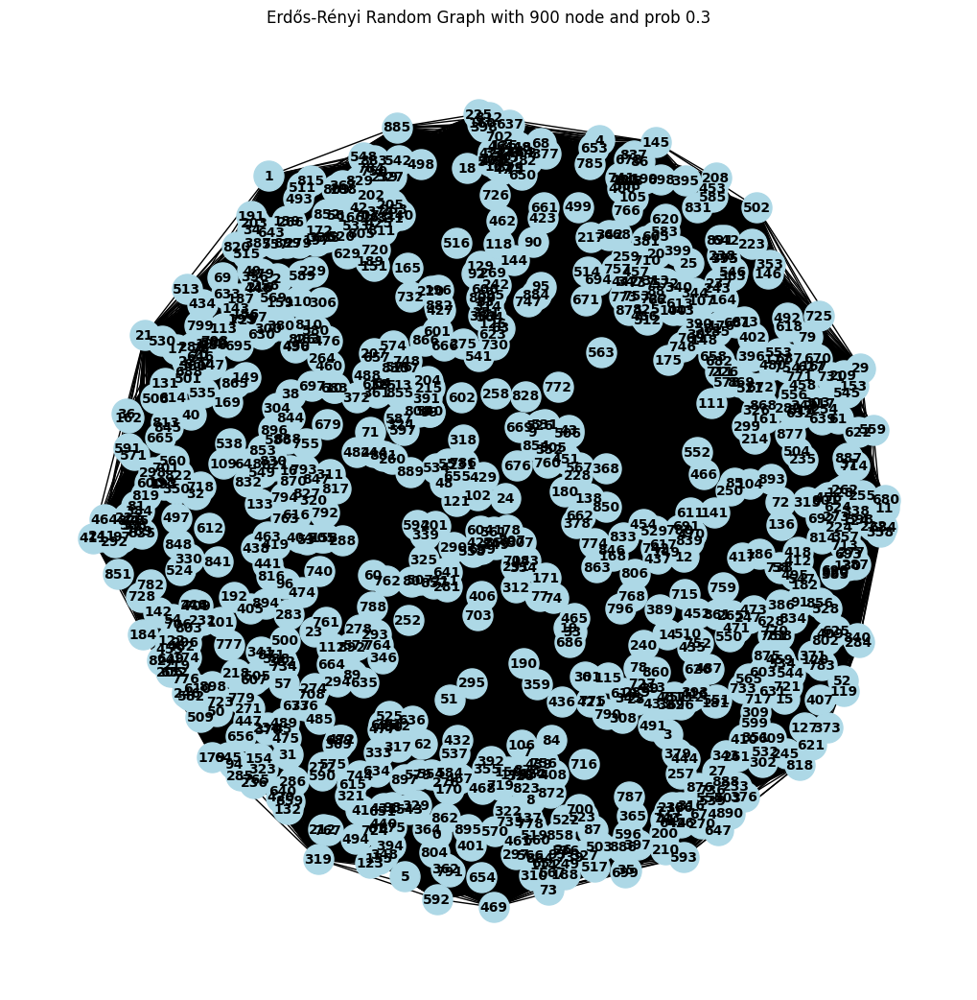

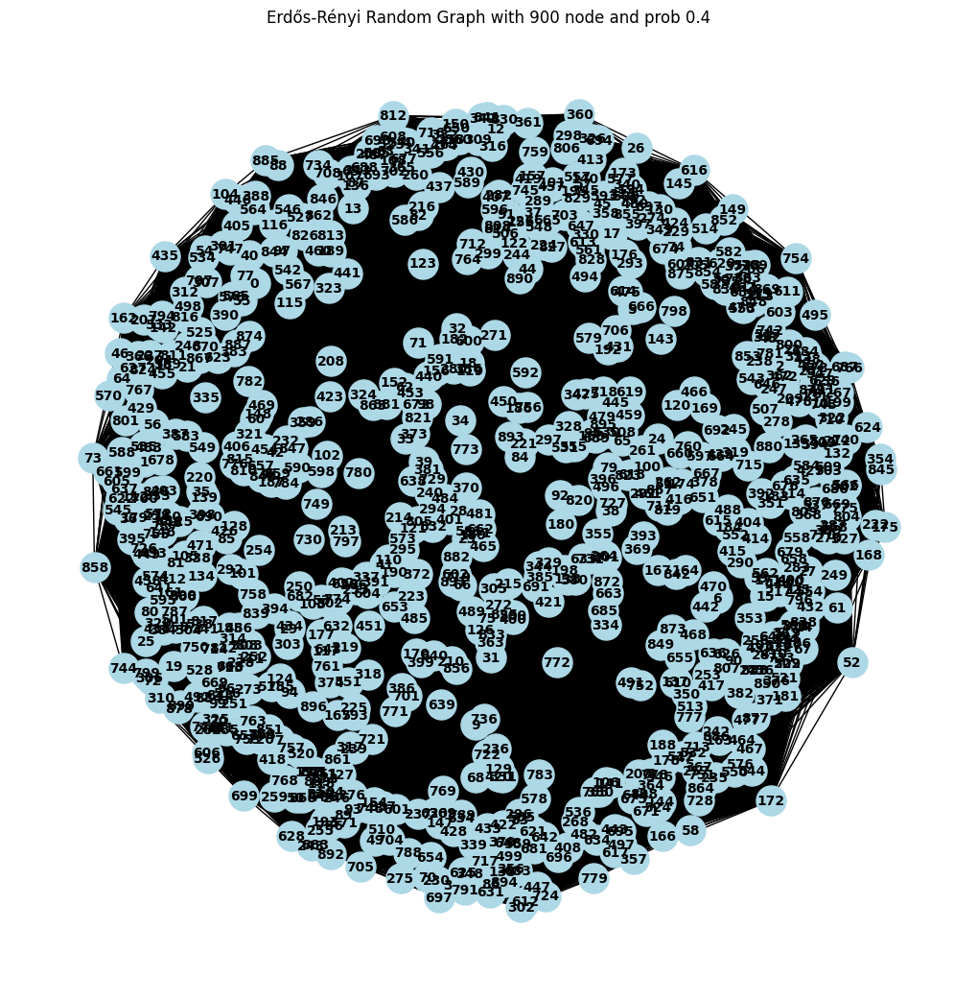

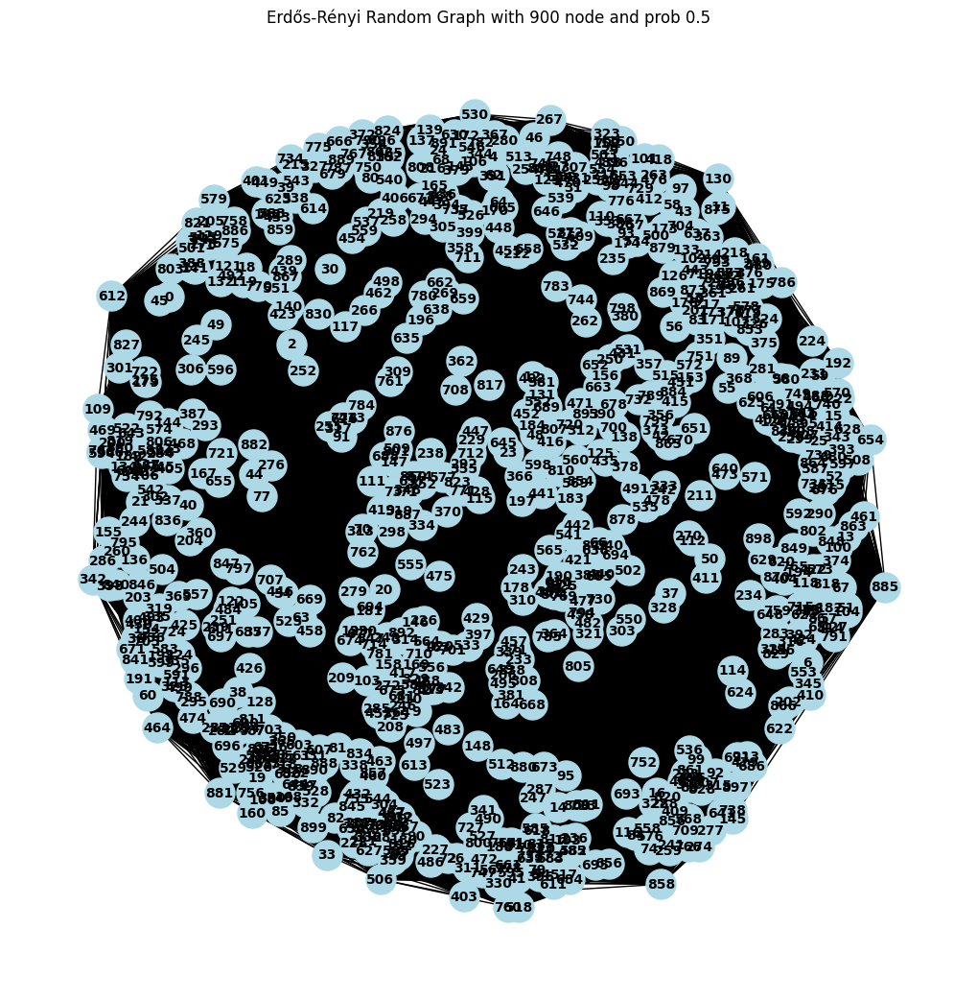

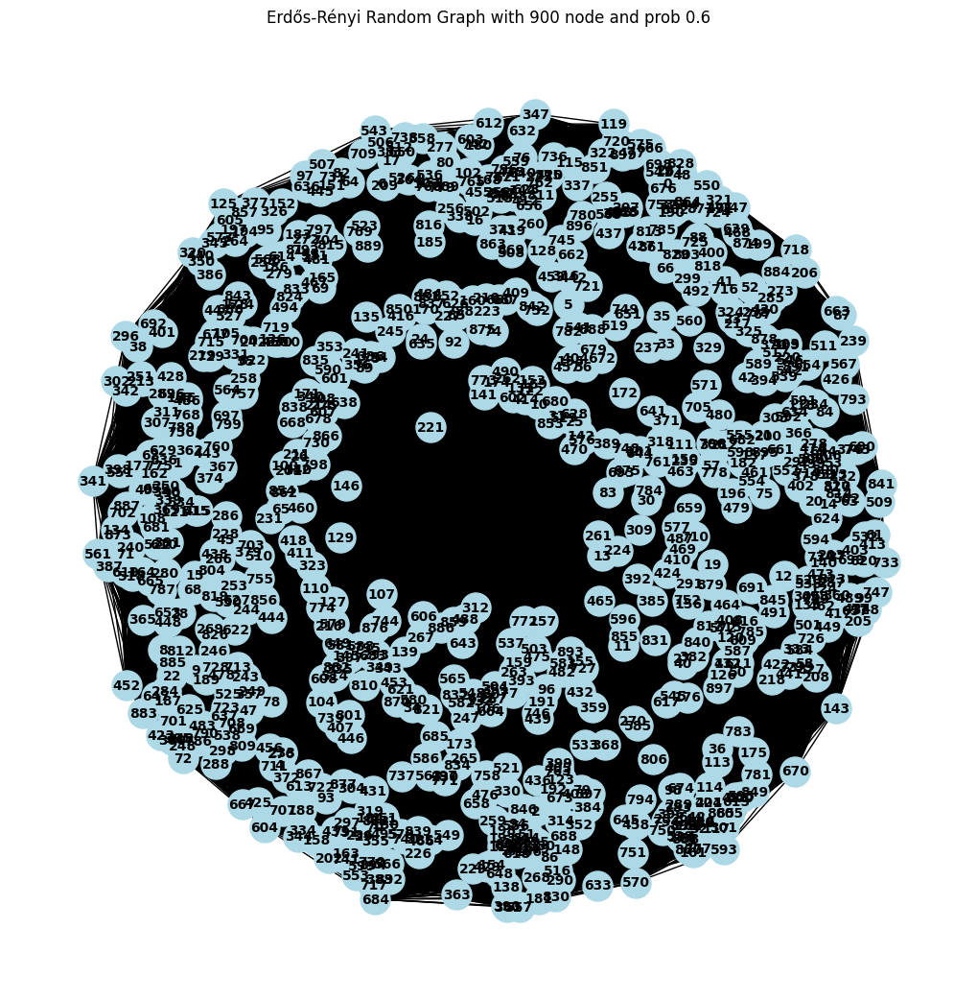



Graph for 1000 nodes




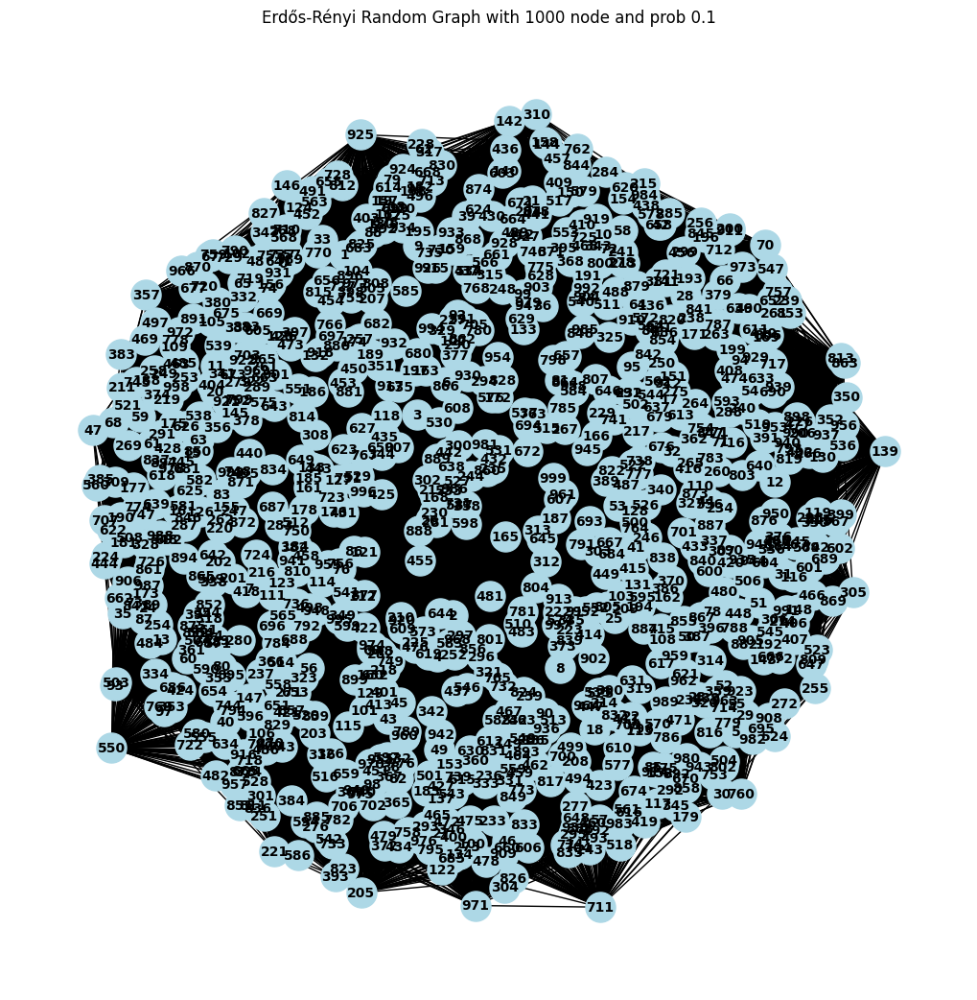

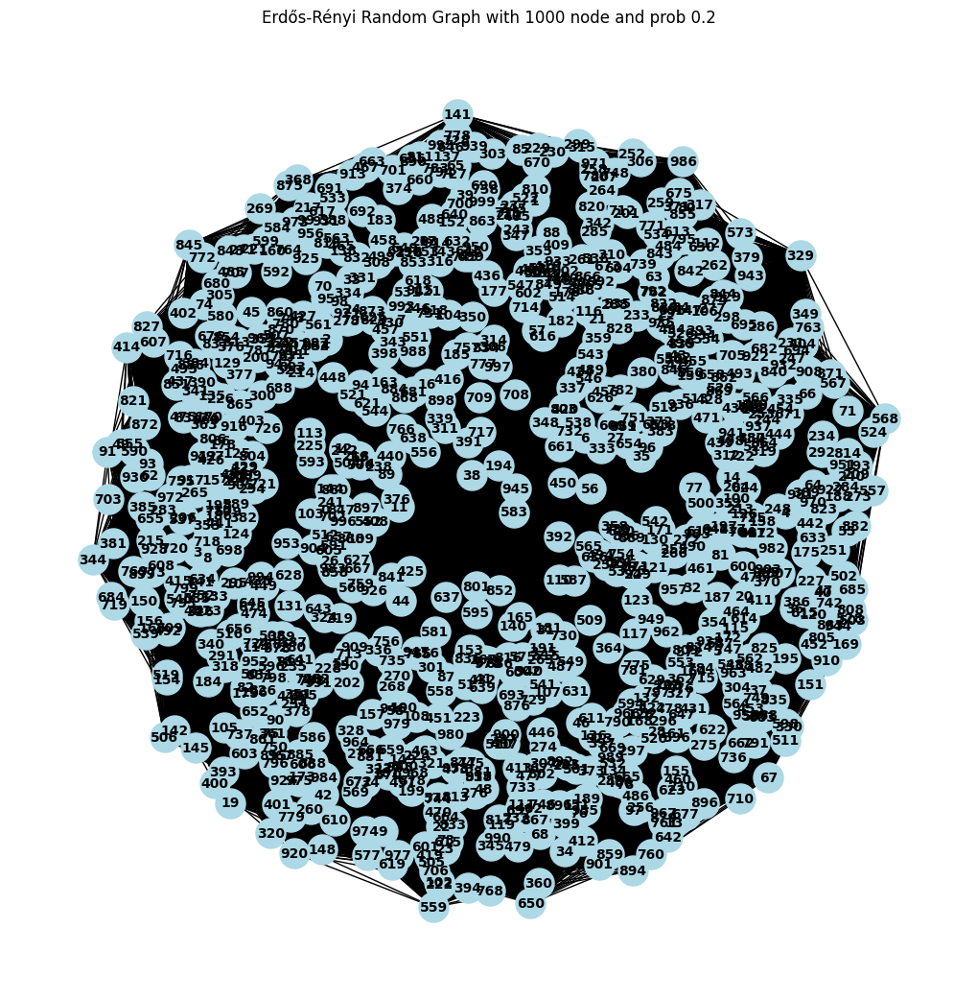

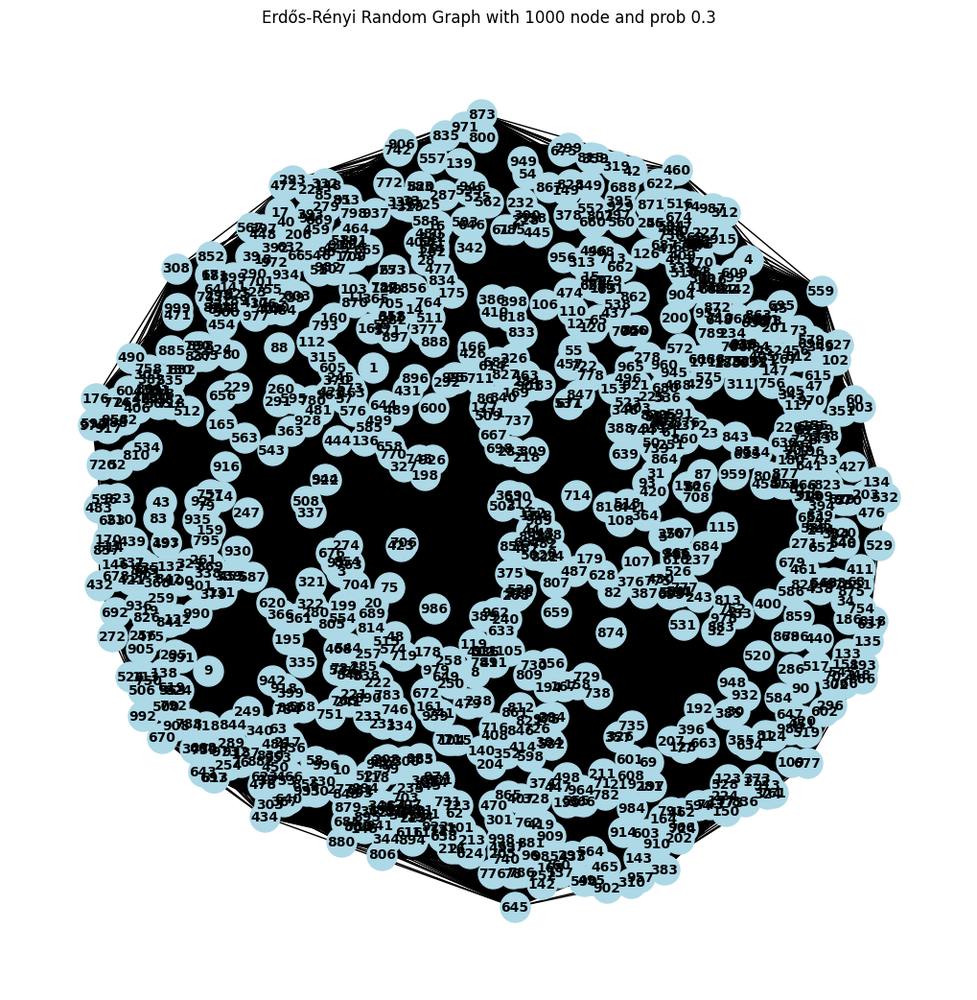

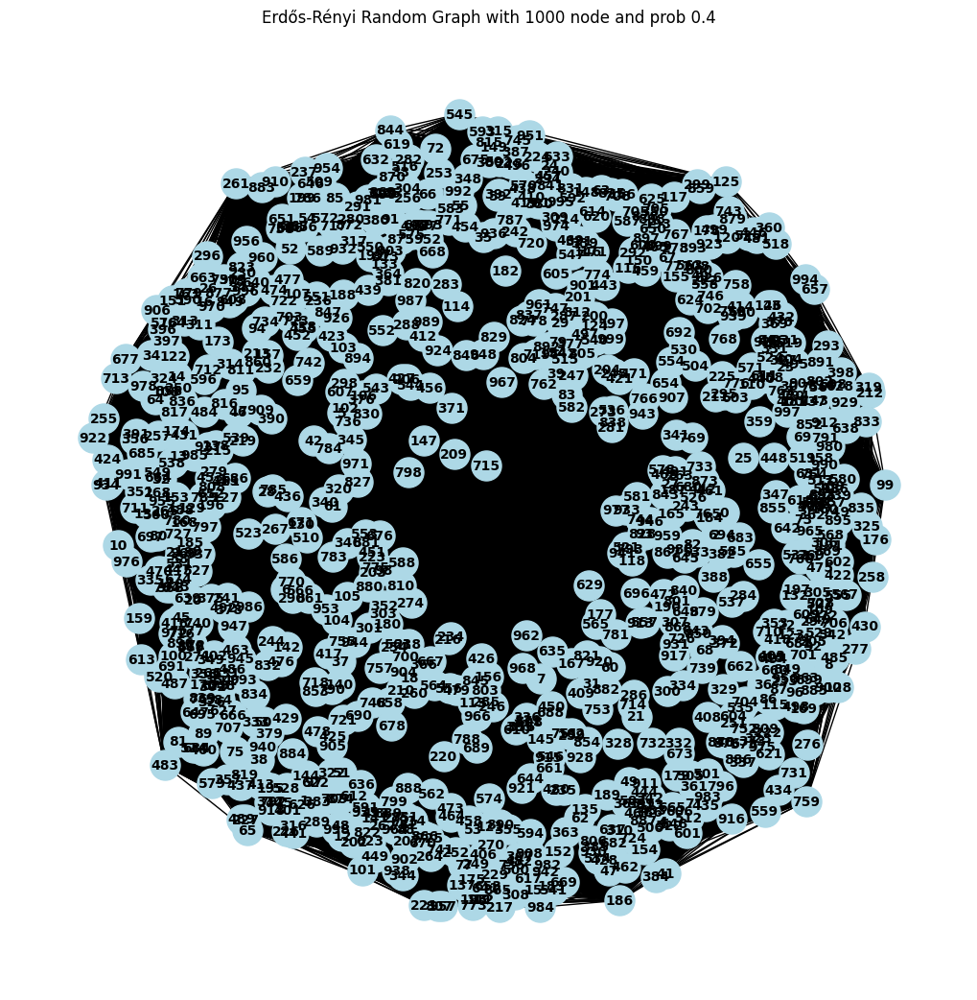

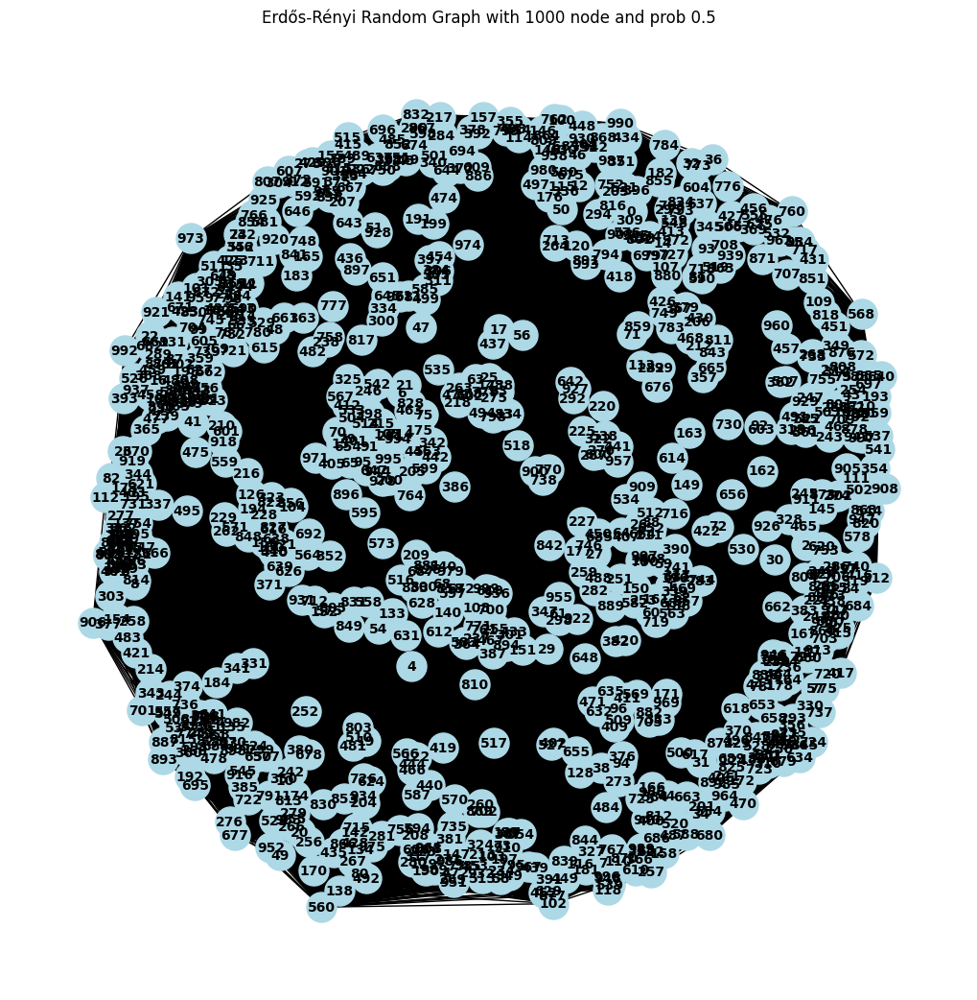

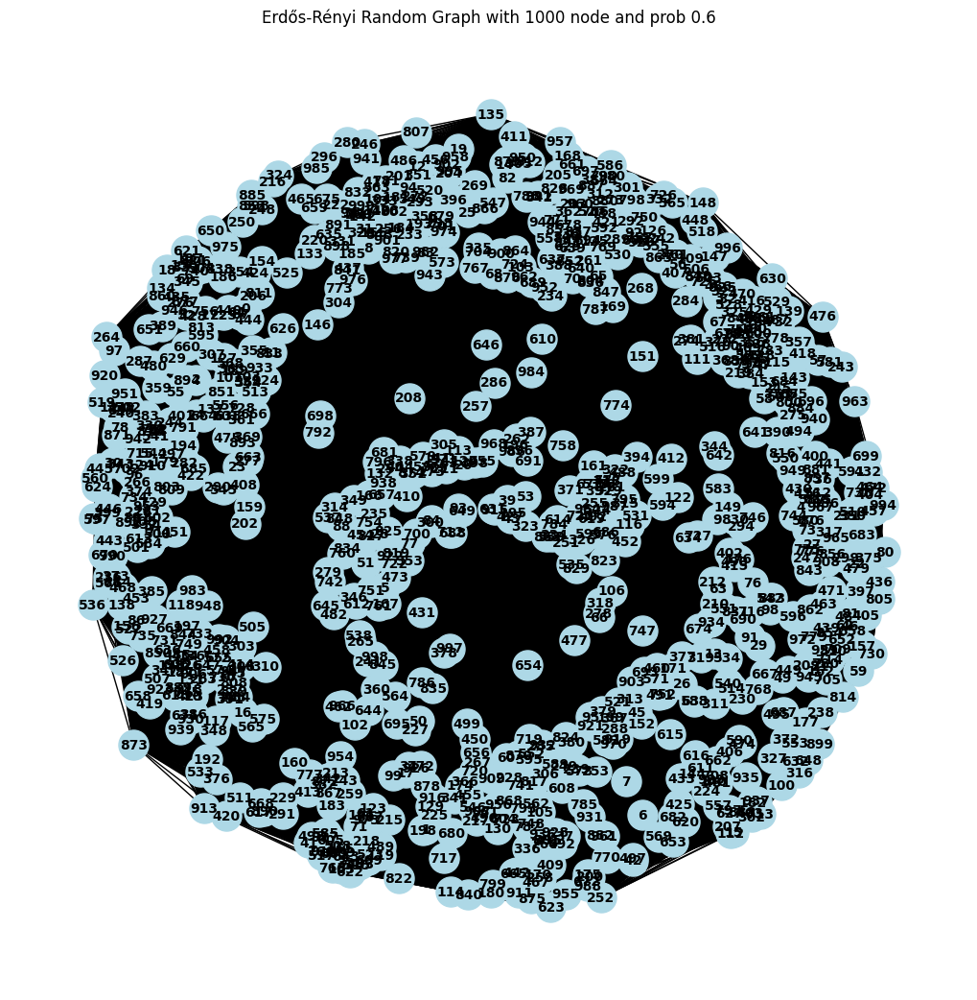

In [5]:
for n in range(100,1001,100):
    print(f"\n\nGraph for {n} nodes\n\n")
    for p in range(1,7):
        random_graph = generate_erdos_renyi_graph(n,float(p/10),5)
        graph_name = f"Erdős-Rényi Random Graph with {n} node and prob {float(p/10)}"
        visualize_graph_B(random_graph,graph_name, (10+(n%100)*5))

## Question: 2

Node classification task based on centrality measures.


### A.) Load the Graph and prepare the labels

- Load the network from torch_geometric.datasets repository
- Prepare one hot labels for each node.

### B.) Feature Engineering and Augmentation

- Compute the following features for each node:
    - Degree centrality
    - Eigenvector centrality
    - Betweenness centrality
    - Local clustering coefficient
    - Closeness centrality
    - PageRank
    - Katz Centrality
- Concatenate these features with existing node features (if available) in the dataset. Prepare a augmented feature for each node.

### C.) Neural Network for Node Classification.

- Preprocess the data and split into training (60%), validation (20%), and test (20%) sets.
- Implement a neural network for multi-class classification (please refer assignemnt pdf for more detail).


In [ ]:
! pip install torch_geometric

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.2/64.2 kB 699.0 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 23.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.5/239.5 kB 13.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.3/124.3 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 301.6/301.6 kB 18.8 MB/s eta 0:00:00


Graph loaded successfully.
Visualizing Graph


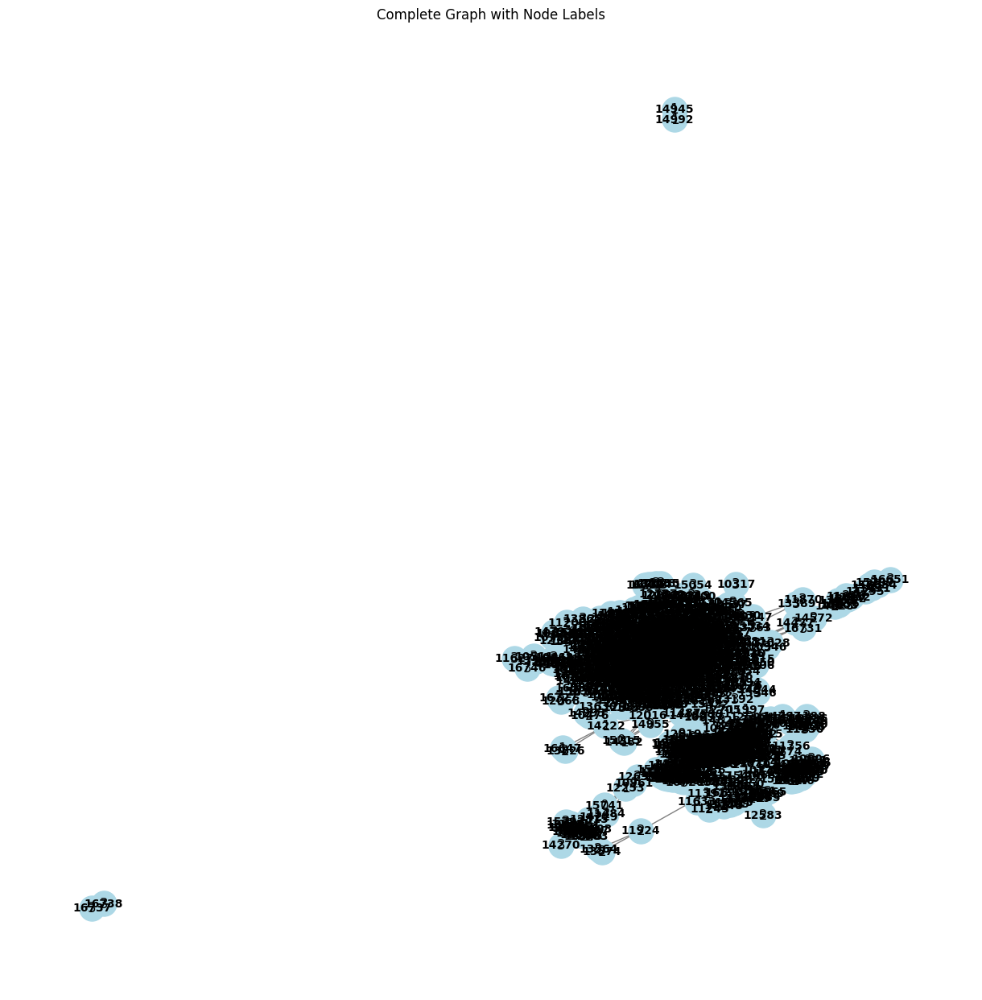

    Node D_centrality E_centrality B_centrality LC_coefficient C_centrality  \
0  12343            3     0.000122          0.0            1.0     0.335897   
1  12129            6     0.000243      0.00001       0.533333     0.342521   
2  13277           27     0.001139     0.000089       0.529915     0.361941   
3  11996          134     0.006032     0.002647       0.499944     0.431499   
4  13796          163     0.006462     0.022361       0.386958     0.475257   

   PageRank K_centrality label  
0  0.000215     0.001764     1  
1  0.000301     0.007005     1  
2  0.000751    -0.026956     0  
3   0.00318     0.014522     0  
4  0.004533     0.035728     0  


In [ ]:
from collections import defaultdict
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import torch
import torch.nn as nn
import torch.optim as optim
import torch_geometric
from google.colab import drive
import requests
import io
from collections import Counter
import pandas as pd

#Load the Graph
def load_graph():
    node_edges_url = "https://raw.githubusercontent.com/leoribeiro/struc2vec/master/graph/usa-airports.edgelist"
    node_edges_response = requests.get(node_edges_url)
    node_edges_response.raise_for_status()
    node_edges_data = node_edges_response.content.decode('utf-8')
    # print(node_edges_data)

    node_label_url = "https://raw.githubusercontent.com/leoribeiro/struc2vec/master/graph/labels-usa-airports.txt"
    node_label_response = requests.get(node_label_url)
    node_label_response.raise_for_status()
    node_label_data = node_label_response.content.decode('utf-8')

    G = nx.parse_edgelist(io.StringIO(node_edges_data), nodetype=int)

    labels = {}
    for line in node_label_data.splitlines():
        parts = line.split()
        if len(parts) == 2 and parts[0].isdigit():   # Ensure there are exactly two parts (node_id and label)
            node_id, label = parts
            labels[int(node_id)] = int(label)

    nx.set_node_attributes(G, labels, 'label')
    print("Graph loaded successfully.")
    return G,labels

# One-hot Label
def prepare_onehot(labels):
    labels_np = torch.tensor(labels, dtype=torch.long)
    num_classes = 4
    one_hot_encoded_tensor = torch.zeros(len(labels), num_classes)
    one_hot_encoded_tensor[torch.arange(len(labels)), labels_np] = 1
    return one_hot_encoded_tensor

# Feature Engineering
def compute_features(G,label_data):
  # Write code to prepare different node features here
    node_features = pd.DataFrame(list(G.nodes),columns=['Node'])

    def add_col_to_dataframe(original_df, col_name, feat_dict):
        original_df[col_name] = None
        for index, row in original_df.iterrows():
            original_df.at[index, col_name] = feat_dict[row['Node']]
        return original_df

    def get_adjecency_matrix(nodes, edges):
        adj_matrix = pd.DataFrame(0, index = nodes, columns = nodes, dtype=int)
        for edge in edges:
            i,j = edge
            adj_matrix.loc[i,j] = int(1)
            adj_matrix.loc[j, i] = int(1)

        return adj_matrix

    # Degree Centrality
    def degree_centrality(nodes, edges):
        l1=[]
        for edge in edges:
            l1.append(edge[0])
            l1.append(edge[1])
        d_centrality = dict(Counter(l1))
        return d_centrality

    def list_to_dict(centrality):
        col = {}
        keys = node_features['Node']
        for i in range(len(keys)):
            col[keys[i]] = centrality[i]
        return col

    # Eigenvector centrality
    def eigenvector_centrality(adj_matrix_df):
        adj_matrix = adj_matrix_df.to_numpy()
        eigen_values, eigen_vectors = np.linalg.eig(adj_matrix)
        max_eigen_value = np.argmax(eigen_values)
        eigen_vector_centrality=eigen_vectors[:,max_eigen_value]
        e_vector_normalize = np.abs(eigen_vector_centrality)/(np.sum(np.abs(eigen_vector_centrality)))
        dict_e_value = list_to_dict(e_vector_normalize)
        return dict_e_value

    def betweenness_centrality(graph):
        return nx.betweenness_centrality(graph)

    def local_clustering_coefficient(graph):
        clustering = nx.clustering(graph)
        return clustering

    def closeness_centrality(graph):
        closeness_centrality = nx.closeness_centrality(G)
        return closeness_centrality
# --------------------------------------------------------------------------------------
    # Calcuating features and adding to dataframe as a feature
    graph_nodes = G.nodes
    graph_edges = G.edges

    adj_matrix = get_adjecency_matrix(graph_nodes, graph_edges)

    d_centrality = degree_centrality(graph_nodes, graph_edges)
    node_features = add_col_to_dataframe(node_features,'D_centrality',d_centrality)

    e_centrality = eigenvector_centrality(adj_matrix)
    node_features = add_col_to_dataframe(node_features,'E_centrality',e_centrality)

    b_centrality = betweenness_centrality(G)
    node_features = add_col_to_dataframe(node_features,'B_centrality',b_centrality)

    lc_coefficient = local_clustering_coefficient(G)
    node_features = add_col_to_dataframe(node_features,'LC_coefficient',lc_coefficient)

    c_centrality = closeness_centrality(G)
    node_features = add_col_to_dataframe(node_features,'C_centrality',c_centrality)

    node_features = add_col_to_dataframe(node_features,'PageRank',nx.pagerank(G))

    node_features = add_col_to_dataframe(node_features,'K_centrality',nx.katz_centrality_numpy(G, alpha=0.1, beta=1.0))

    node_features = add_col_to_dataframe(node_features,'label',label_data)

    print(node_features.head())

    return node_features

# Neural Network for Node Classification
class SimpleNN(nn.Module):
    def __init__(self, input_dim, hidden_dim1, hidden_dim2, hidden_dim3, num_classes):
        super(SimpleNN, self).__init__()
        self.fc1 = nn.Linear(input_dim, hidden_dim1)
        self.fc2 = nn.Linear(hidden_dim1, hidden_dim2)
        self.fc3 = nn.Linear(hidden_dim2, hidden_dim3)
        self.fc4 = nn.Linear(hidden_dim3, num_classes)
        self.relu = nn.ReLU()
        self.softmax = nn.Softmax(dim=1)

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.relu(self.fc3(x))
        x = self.fc4(x)
        return x

# part 4: training

def train_and_evaluate(X_train, y_train, X_val, y_val, X_test, y_test):
    # Write your code for model training and evaluation here.
    # Print all losses and final test accuracy,precision,recall and F1-score
    pass

# Main execution

if __name__ == '__main__':
  # Write your code in the following subsection
    G,label_data = load_graph()

  # Generate graph
    print("Visualizing Graph")
    pos = nx.spring_layout(G)  # Positions for all nodes
    labels = nx.get_node_attributes(G, 'label')  # Extract labels
    plt.figure(figsize=(12, 12))  # Set figure size
    nx.draw(G, pos, with_labels=True, node_color='lightblue', node_size=500, font_size=10, font_weight='bold', edge_color='gray')
    nx.draw_networkx_labels(G, pos, labels, font_color='black')

    plt.title('Complete Graph with Node Labels')
    plt.show()

  # Compute features
    node_features = compute_features(G,label_data)

  # Standardize features
    columns_to_standardize = ['D_centrality', 'E_centrality', 'B_centrality', 'LC_coefficient', 'C_centrality', 'PageRank', 'K_centrality']
    scaler = StandardScaler()
    node_features[columns_to_standardize] = scaler.fit_transform(node_features[columns_to_standardize])
    # print(node_features.head())

  # Convert to PyTorch tensors
    X = torch.tensor(node_features.drop(columns=['Node', 'label']).values, dtype=torch.float32)
    y_label = node_features['label']
    y=prepare_onehot(y_label)

  # Train and evaluate model
    X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42, stratify=y_label)
    X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42, stratify=y_temp.argmax(dim=1))

  # Visualize results
    input_dim = X_train.shape[1]  # Number of features
    hidden_dim1 = 128
    hidden_dim2 = 64
    hidden_dim3 = 32
    num_classes = y_train.shape[1]  # Number of classes

    # Instantiate the model
    model = SimpleNN(input_dim, hidden_dim1, hidden_dim2, hidden_dim3, num_classes)


Neural Network

In [ ]:
# Training parameters
learning_rate = 0.0005
num_epochs = 1000

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# Convert data to torch tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train.argmax(dim=1).numpy(), dtype=torch.long)
X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val.argmax(dim=1).numpy(), dtype=torch.long)

loss_values = []
# Training loop
for epoch in range(num_epochs):
    model.train()
    optimizer.zero_grad()

    outputs = model(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)

    loss.backward()
    optimizer.step()

    loss_values.append(loss.item())

    if (epoch+1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')


<ipython-input-7-24ffbf52db3a>:10: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
<ipython-input-7-24ffbf52db3a>:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  X_val_tensor = torch.tensor(X_val, dtype=torch.float32)


Epoch [10/1000], Loss: 1.3572
Epoch [20/1000], Loss: 1.3050
Epoch [30/1000], Loss: 1.2420
Epoch [40/1000], Loss: 1.1767
Epoch [50/1000], Loss: 1.1153
Epoch [60/1000], Loss: 1.0565
Epoch [70/1000], Loss: 1.0017
Epoch [80/1000], Loss: 0.9571
Epoch [90/1000], Loss: 0.9234
Epoch [100/1000], Loss: 0.8974
Epoch [110/1000], Loss: 0.8764
Epoch [120/1000], Loss: 0.8589
Epoch [130/1000], Loss: 0.8438
Epoch [140/1000], Loss: 0.8305
Epoch [150/1000], Loss: 0.8189
Epoch [160/1000], Loss: 0.8082
Epoch [170/1000], Loss: 0.7987
Epoch [180/1000], Loss: 0.7899
Epoch [190/1000], Loss: 0.7816
Epoch [200/1000], Loss: 0.7736
Epoch [210/1000], Loss: 0.7659
Epoch [220/1000], Loss: 0.7587
Epoch [230/1000], Loss: 0.7517
Epoch [240/1000], Loss: 0.7450
Epoch [250/1000], Loss: 0.7381
Epoch [260/1000], Loss: 0.7313
Epoch [270/1000], Loss: 0.7245
Epoch [280/1000], Loss: 0.7176
Epoch [290/1000], Loss: 0.7107
Epoch [300/1000], Loss: 0.7040
Epoch [310/1000], Loss: 0.6972
Epoch [320/1000], Loss: 0.6903
Epoch [330/1000],

In [ ]:
from sklearn.metrics import accuracy_score, precision_recall_fscore_support

# Convert test data to torch tensors
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test.argmax(dim=1).numpy(), dtype=torch.long)

# Model evaluation
model.eval()
with torch.no_grad():
    test_outputs = model(X_test_tensor)
    _, predicted = torch.max(test_outputs, 1)

    # Calculate metrics
    accuracy = accuracy_score(y_test_tensor.numpy(), predicted.numpy())
    precision, recall, f1, _ = precision_recall_fscore_support(y_test_tensor.numpy(), predicted.numpy(), average='macro')

    print(f'Test Accuracy: {accuracy:.4f}')
    print(f'Test Precision: {precision:.4f}')
    print(f'Test Recall: {recall:.4f}')
    print(f'Test F1 Score: {f1:.4f}')


Test Accuracy: 0.6345
Test Precision: 0.6253
Test Recall: 0.6343
Test F1 Score: 0.6261


<ipython-input-8-d77d42a5a094>:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  X_test_tensor = torch.tensor(X_test, dtype=torch.float32)


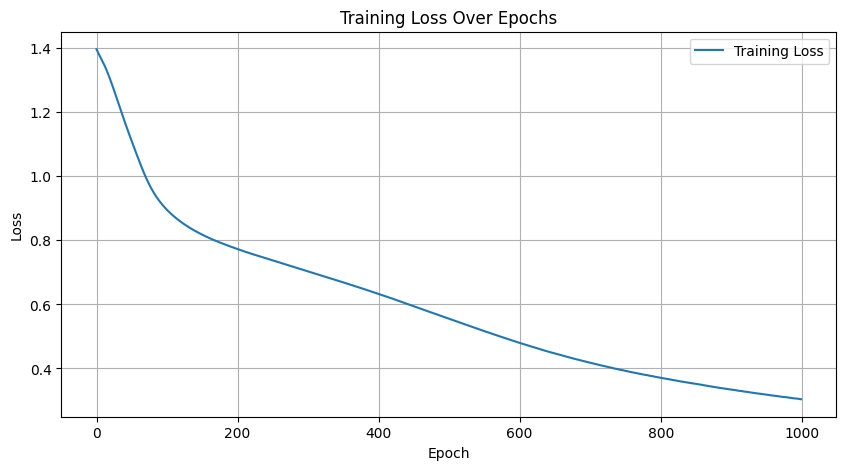

In [ ]:
# Training Loss Visualization
def plot_training_loss(losses):
    plt.figure(figsize=(10, 5))
    plt.plot(loss_values, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Loss Over Epochs')
    plt.legend()
    plt.grid(True)
    plt.show()

plot_training_loss(loss_values)

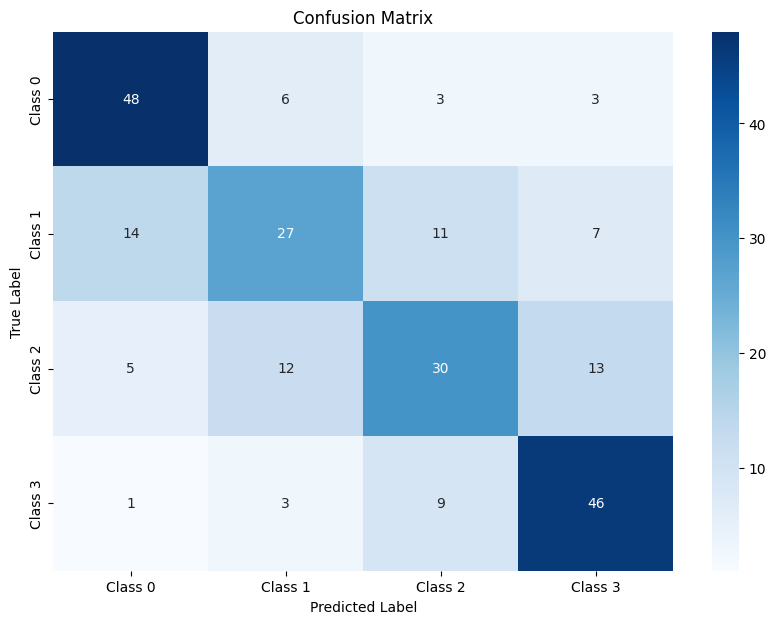

In [ ]:
# Confusion Matrix
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Get predictions and true labels
y_test_true = y_test.argmax(dim=1).numpy()
y_test_pred = predicted.numpy()

# Compute confusion matrix
conf_matrix = confusion_matrix(y_test_true, y_test_pred)

# Plot confusion matrix
def plot_confusion_matrix(conf_matrix, class_names):
    plt.figure(figsize=(10, 7))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

# Define class names (adjust according to your dataset)
class_names = [f'Class {i}' for i in range(num_classes)]

# Call the function to plot confusion matrix
plot_confusion_matrix(conf_matrix, class_names)


In [ ]:
# Classification Report
from sklearn.metrics import classification_report

# Compute classification report
report = classification_report(y_test_true, y_test_pred, target_names=class_names)

# Print classification report
print("Classification Report:\n", report)

Classification Report:
               precision    recall  f1-score   support

     Class 0       0.71      0.80      0.75        60
     Class 1       0.56      0.46      0.50        59
     Class 2       0.57      0.50      0.53        60
     Class 3       0.67      0.78      0.72        59

    accuracy                           0.63       238
   macro avg       0.63      0.63      0.63       238
weighted avg       0.63      0.63      0.63       238



Part 4

In [ ]:
from sklearn.metrics import classification_report, accuracy_score, precision_recall_fscore_support

def evaluate_model(model, X, y):
    model.eval()
    with torch.no_grad():
        X_tensor = torch.tensor(X, dtype=torch.float32)
        y_tensor = torch.tensor(y.argmax(dim=1).numpy(), dtype=torch.long)

        outputs = model(X_tensor)
        _, predicted = torch.max(outputs, 1)

        accuracy = accuracy_score(y_tensor.numpy(), predicted.numpy())
        precision, recall, f1, _ = precision_recall_fscore_support(y_tensor.numpy(), predicted.numpy(), average='macro')

        return accuracy, precision, recall, f1, predicted

# Evaluate on training, validation, and test sets
train_accuracy, train_precision, train_recall, train_f1, train_predictions = evaluate_model(model, X_train, y_train)
val_accuracy, val_precision, val_recall, val_f1, val_predictions = evaluate_model(model, X_val, y_val)
test_accuracy, test_precision, test_recall, test_f1, test_predictions = evaluate_model(model, X_test, y_test)

print(f'Training Accuracy: {train_accuracy:.4f}')
print(f'Training Precision: {train_precision:.4f}')
print(f'Training Recall: {train_recall:.4f}')
print(f'Training F1 Score: {train_f1:.4f}')

print(f'Validation Accuracy: {val_accuracy:.4f}')
print(f'Validation Precision: {val_precision:.4f}')
print(f'Validation Recall: {val_recall:.4f}')
print(f'Validation F1 Score: {val_f1:.4f}')

print(f'Test Accuracy: {test_accuracy:.4f}')
print(f'Test Precision: {test_precision:.4f}')
print(f'Test Recall: {test_recall:.4f}')
print(f'Test F1 Score: {test_f1:.4f}')


Training Accuracy: 0.8838
Training Precision: 0.8917
Training Recall: 0.8836
Training F1 Score: 0.8833
Validation Accuracy: 0.6513
Validation Precision: 0.6492
Validation Recall: 0.6515
Validation F1 Score: 0.6431
Test Accuracy: 0.6345
Test Precision: 0.6253
Test Recall: 0.6343
Test F1 Score: 0.6261


<ipython-input-12-e8879aae04d8>:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  X_tensor = torch.tensor(X, dtype=torch.float32)
<ipython-input-12-e8879aae04d8>:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  X_tensor = torch.tensor(X, dtype=torch.float32)
<ipython-input-12-e8879aae04d8>:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  X_tensor = torch.tensor(X, dtype=torch.float32)


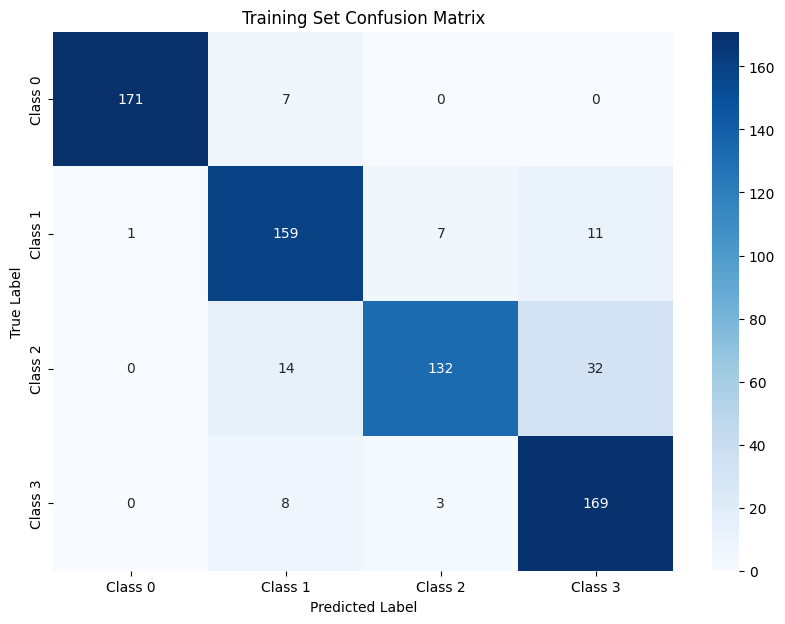

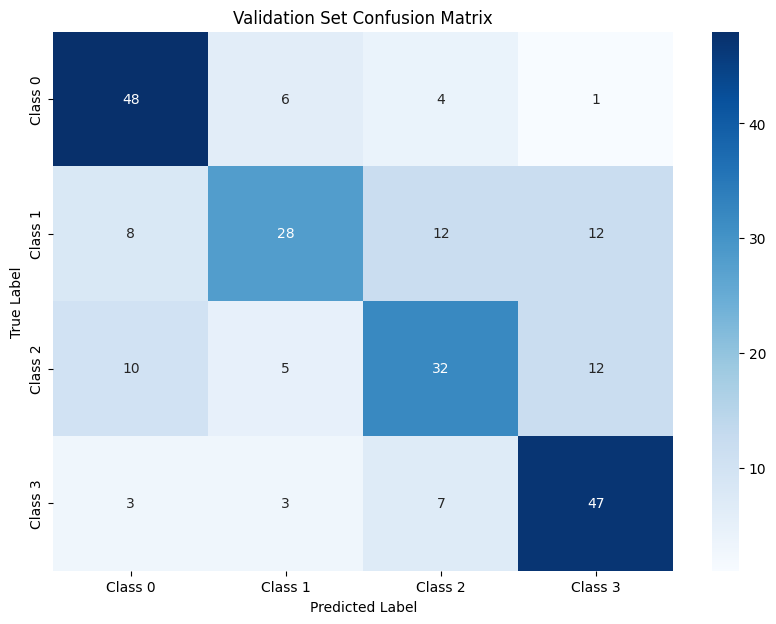

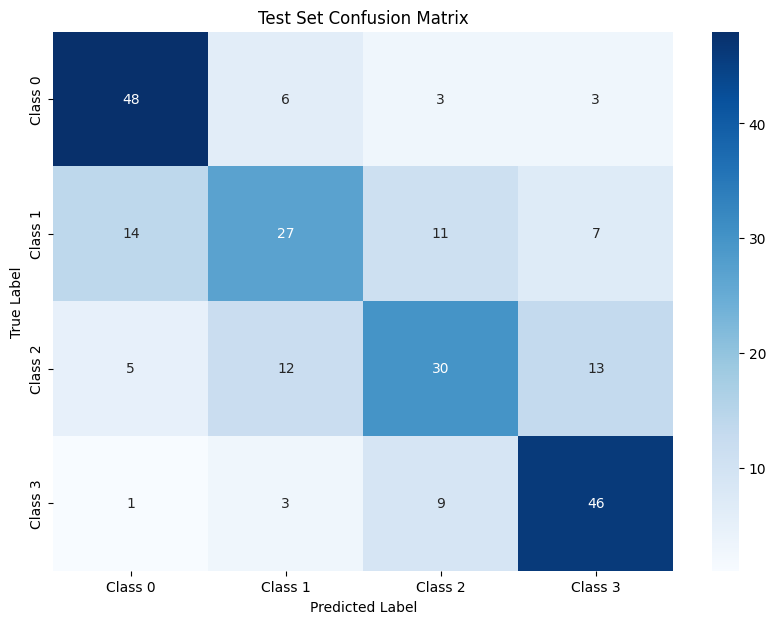

In [ ]:
def plot_confusion_matrix(conf_matrix, class_names, title='Confusion Matrix'):
    plt.figure(figsize=(10, 7))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title(title)
    plt.show()

# Compute confusion matrices
train_conf_matrix = confusion_matrix(y_train.argmax(dim=1).numpy(), train_predictions.numpy()) # Replace '_' with 'train_predictions.numpy()'
val_conf_matrix = confusion_matrix(y_val.argmax(dim=1).numpy(), val_predictions.numpy()) # Replace '_' with 'val_predictions.numpy()'
test_conf_matrix = confusion_matrix(y_test.argmax(dim=1).numpy(), test_predictions.numpy())

# Define class names (adjust according to your dataset)
class_names = [f'Class {i}' for i in range(num_classes)]

# Plot confusion matrices
plot_confusion_matrix(train_conf_matrix, class_names, 'Training Set Confusion Matrix')
plot_confusion_matrix(val_conf_matrix, class_names, 'Validation Set Confusion Matrix')
plot_confusion_matrix(test_conf_matrix, class_names, 'Test Set Confusion Matrix')


In [ ]:
# Generate classification reports
train_report = classification_report(y_train.argmax(dim=1).numpy(), train_predictions.numpy(), target_names=class_names) # Replace '_' with 'train_predictions.numpy()'
val_report = classification_report(y_val.argmax(dim=1).numpy(), val_predictions.numpy(), target_names=class_names) # Replace '_' with 'val_predictions.numpy()'
test_report = classification_report(y_test.argmax(dim=1).numpy(), test_predictions.numpy(), target_names=class_names)

print("Training Set Classification Report:\n", train_report)
print("Validation Set Classification Report:\n", val_report)
print("Test Set Classification Report:\n", test_report)


Training Set Classification Report:
               precision    recall  f1-score   support

     Class 0       0.99      0.96      0.98       178
     Class 1       0.85      0.89      0.87       178
     Class 2       0.93      0.74      0.82       178
     Class 3       0.80      0.94      0.86       180

    accuracy                           0.88       714
   macro avg       0.89      0.88      0.88       714
weighted avg       0.89      0.88      0.88       714

Validation Set Classification Report:
               precision    recall  f1-score   support

     Class 0       0.70      0.81      0.75        59
     Class 1       0.67      0.47      0.55        60
     Class 2       0.58      0.54      0.56        59
     Class 3       0.65      0.78      0.71        60

    accuracy                           0.65       238
   macro avg       0.65      0.65      0.64       238
weighted avg       0.65      0.65      0.64       238

Test Set Classification Report:
               precisi

***

## Question: 3

Graph Classification based on Graphlet Degree Vector.

Perform a graph classification task based on graphlet degree vector count  for the NCI109 dataset from the TUDataset collection. The NCI109 dataset is a collection of 4,127 chemical compounds, where each graph represents a compound, and the nodes and edges represent atoms and bonds. Each graph in the dataset is labelled as either "active" or "inactive" against a specific cancer cell line, indicating whether the chemical compound is bioactive or not.

### A.)Extract the specific graphlet degree vector counts for each graph and take them as feature vectors for performing the graph classification task.

**Types of Graphlets**

1. G1: Triangle
2. G2: Hexagon
3. G3: Pentagon
4. G4: K4 (complete subgraphs of size 4)
5. G5: K5 (complete subgraphs of size 5)
6. G6: 6-node clique
7. G7: 4-cycle (C4)
8. G8: Star (a center node with more than 2 connections).
9. G9: Chains(linear sequences of 3 nodes or more)

For each graph, report the graphlet counts.


### B.) Graph Classification Setup:
- Implement a 3-layer simple feedforward neural network with 64 hidden layer dimensions. Standardise the features of the dataset. Split the dataset into 80% train set and 20% test set. Use the ADAM optimizer with a learning rate of 0.001. Train the model for 200 epochs and report the model's performance metrics.
- Visualize the  classification results and the features of the graphs that are important for the prediction of a chemical compound that is bioactive or not.

Dataset Link - https://www.chrsmrrs.com/graphkerneldatasets/NCI109.zip

In [ ]:
!pip install tqdm

In [ ]:
# Write your solution here
import torch
import torch.nn as nn
import torch.optim as optim
from torch_geometric.datasets import TUDataset
from torch_geometric.data import DataLoader
import networkx as nx
import numpy as np
from itertools import combinations
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Load NCI109 dataset
node_edges = []
graphs_label=[]
chunk_size = 10000
for chunk in pd.read_csv('/content/NCI109_A.txt', delimiter=',', header=None, names=['x', 'y'], chunksize=chunk_size):
    for index, row in chunk.iterrows():
        node_edges.append((row['x'], row['y']))
for chunk in pd.read_csv('/content/NCI109_graph_indicator.txt', header=None, names=['Graph_indicator'], chunksize=chunk_size):
    for index, row in chunk.iterrows():
        graphs_label.append(row['Graph_indicator'])

n=len(graphs_label)
dict_graph_nodes={}
l1=[]
for i in range(n-1):
    if(graphs_label[i] == graphs_label[i+1]):
        l1.append(i+1)
    elif( i < n-1 and len(l1)==0 and (graphs_label[i] != graphs_label[i+1])):
        l1.append(i+1)
        dict_graph_nodes[graphs_label[i]]=l1
        if(i!=n-2):
            l1=[]
    else:
        l1.append(i+1)
        dict_graph_nodes[graphs_label[i]]=l1
        if(i!=n-2):
            l1=[]

#handling last node
if(graphs_label[n-2] == graphs_label[n-1]):
    l1.append(n-1)
    dict_graph_nodes[graphs_label[n-2]]=l1
else:
    l1=[]
    l1.append(n-1)
    dict_graph_nodes[graphs_label[n-2]]=l1


In [ ]:
from concurrent.futures import ThreadPoolExecutor, as_completed
from tqdm import tqdm

# Function to compute edges for a single key
def compute_edges_for_key(key, values, node_edges):
    edges = []
    values_set = set(values)
    for a, b in node_edges:
        if a in values_set and b in values_set:
            edges.append((a, b))
    return key, edges

def parallelize_edge_computation(dict_graph_nodes, node_edges):
    dict_graph_adj_value = {}
    with ThreadPoolExecutor() as executor:
        # Submit all tasks to the executor
        futures = []
        for key, values in dict_graph_nodes.items():
            futures.append(executor.submit(compute_edges_for_key, key, values, node_edges))

        # Use tqdm to show progress
        for future in tqdm(as_completed(futures), total=len(futures), desc="Processing"):
            key, edges = future.result()
            dict_graph_adj_value[key] = edges

    return dict_graph_adj_value

# Run the parallel computation
dict_graph_adj_value = parallelize_edge_computation(dict_graph_nodes, node_edges)

# Output the result
print(len(dict_graph_adj_value))


Processing: 100%|██████████| 4127/4127 [00:37<00:00, 110.62it/s]

4127


In [ ]:
for i, (key, value) in enumerate(dict_graph_adj_value.items()):
    if i >= 10:
        break
    print(f"{key}:{value}")

1569:[(39962, 39961), (39963, 39961), (39964, 39961), (39969, 39961), (39961, 39962), (39961, 39963), (39961, 39964), (39970, 39965), (39967, 39966), (39968, 39966), (39966, 39967), (39969, 39967), (39966, 39968), (39970, 39968), (39961, 39969), (39967, 39969), (39965, 39970), (39968, 39970)]
493:[(13179, 13167), (13182, 13168), (13173, 13169), (13174, 13169), (13174, 13170), (13181, 13170), (13181, 13171), (13182, 13171), (13181, 13172), (13169, 13173), (13175, 13173), (13176, 13173), (13169, 13174), (13170, 13174), (13180, 13174), (13173, 13175), (13177, 13175), (13173, 13176), (13178, 13176), (13175, 13177), (13179, 13177), (13176, 13178), (13179, 13178), (13167, 13179), (13177, 13179), (13178, 13179), (13174, 13180), (13182, 13180), (13170, 13181), (13171, 13181), (13172, 13181), (13168, 13182), (13171, 13182), (13180, 13182)]
1570:[(39986, 39971), (39991, 39971), (39987, 39972), (39989, 39973), (39975, 39974), (39976, 39974), (39980, 39974), (39981, 39974), (39974, 39975), (39977,

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt

In [ ]:
def create_graph_for_key(key, edges):
    G = nx.Graph()
    G.add_edges_from(edges)
    return key, G

def parallelize_graph_creation(dict_graph_adj_value):
    graphs = {}

    # Create a thread pool for parallel processing
    with ThreadPoolExecutor() as executor:
        futures = []

        # Submit tasks to the executor
        for key, edges in dict_graph_adj_value.items():
            futures.append(executor.submit(create_graph_for_key, key, edges))

        # Use tqdm to show progress
        for future in tqdm(as_completed(futures), total=len(futures), desc="Creating Graphs"):
            key, graph = future.result()
            graphs[key] = graph

    return graphs

# Run the parallel graph creation
graphs = parallelize_graph_creation(dict_graph_adj_value)

Creating Graphs: 100%|██████████| 4127/4127 [00:00<00:00, 223382.28it/s]


In [ ]:
graphs = dict(sorted(graphs.items()))

**Prinitng 10 graphs**

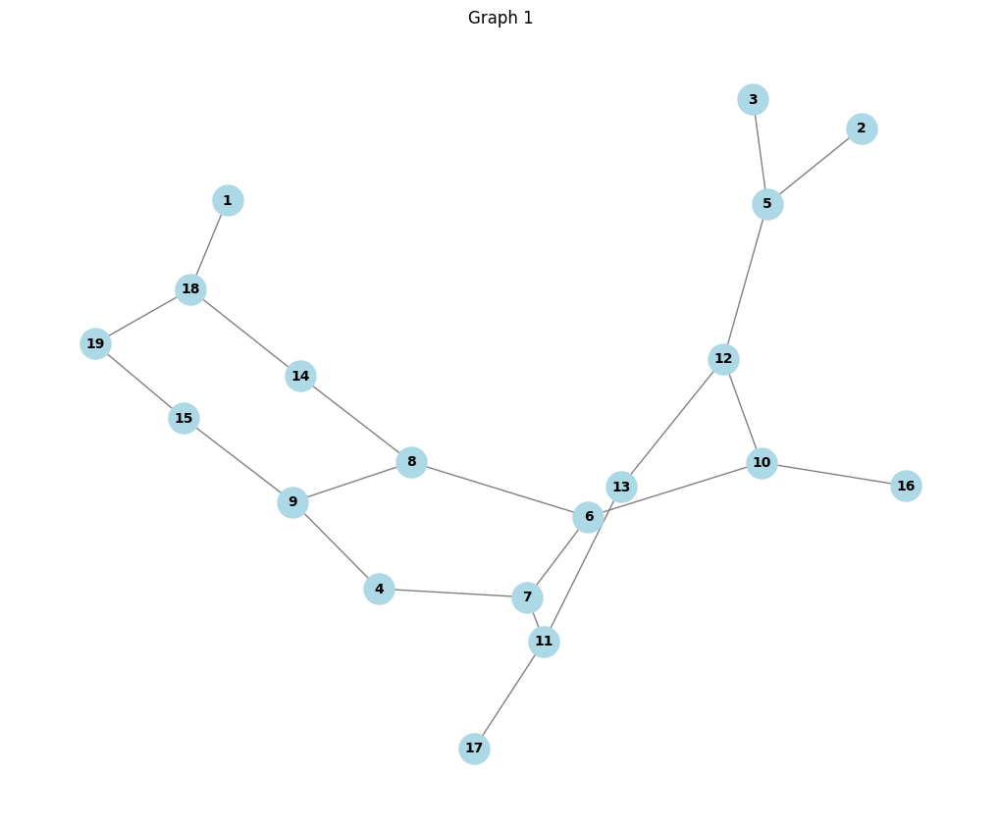

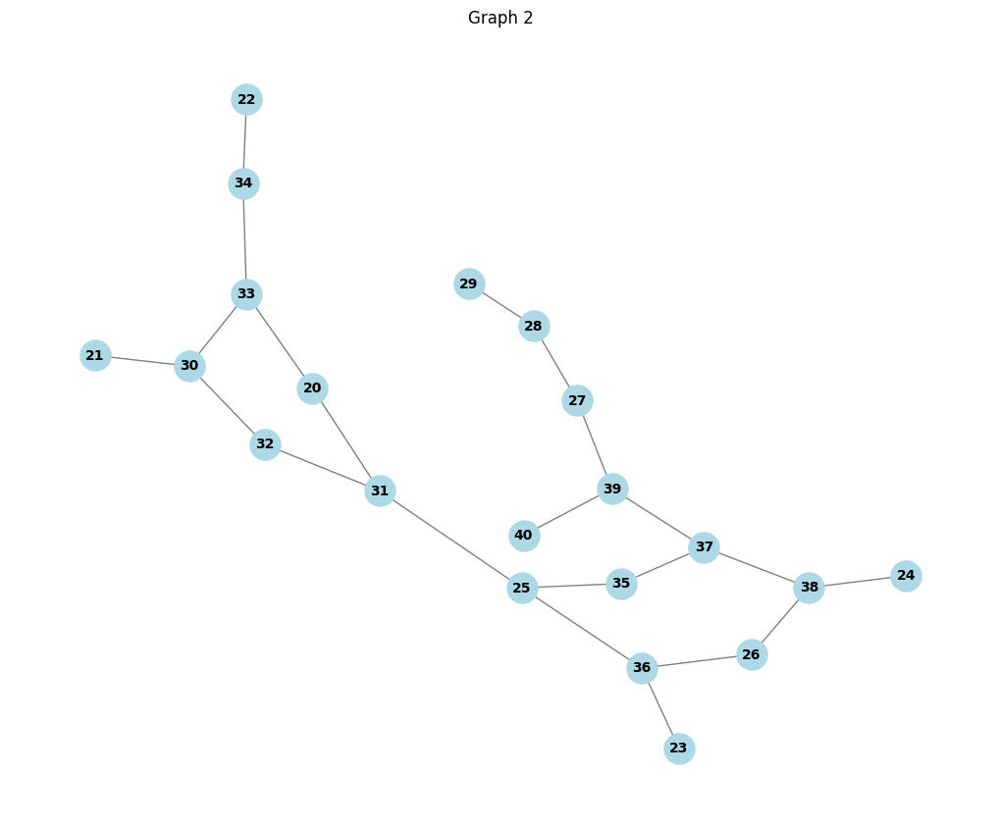

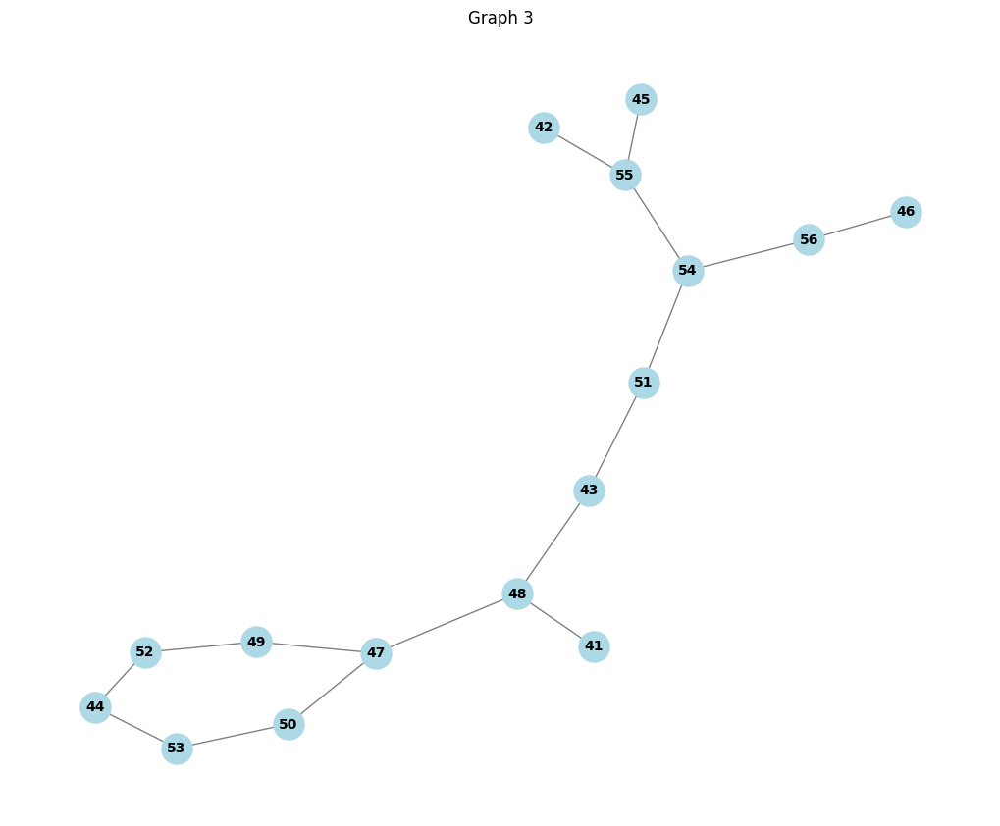

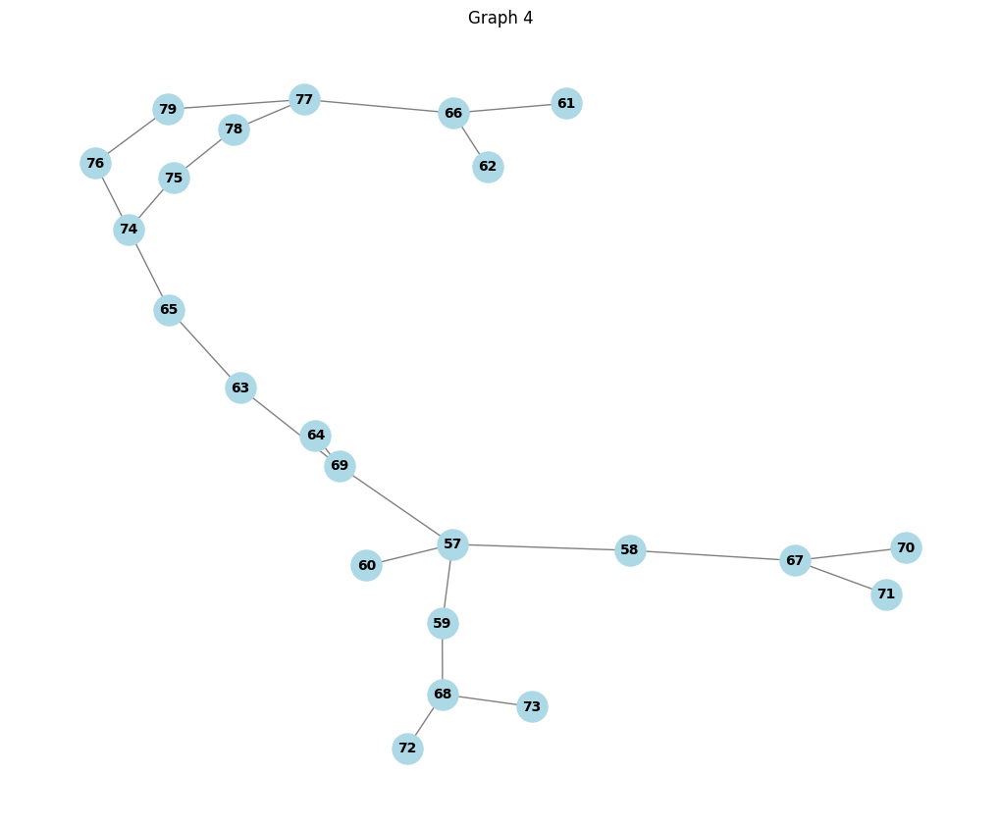

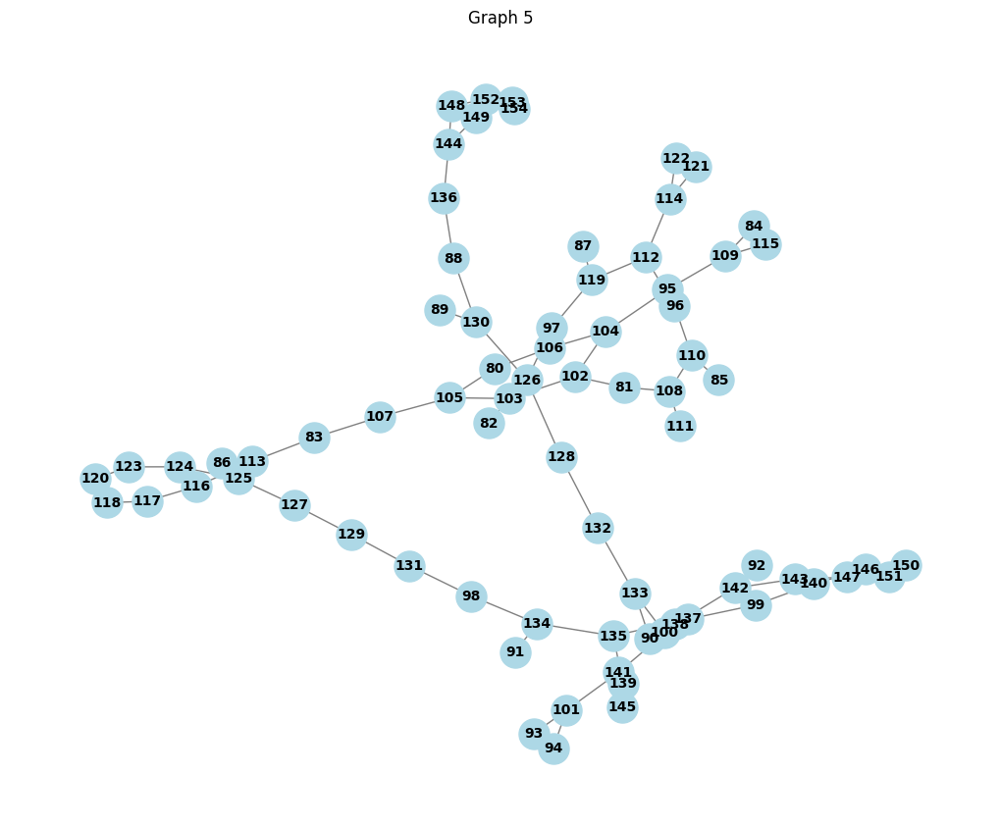

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
i = 0
for key, G in graphs.items():
    plt.figure(figsize=(10, 8))
    pos = nx.spring_layout(G)  # Positions nodes using the Fruchterman-Reingold force-directed algorithm
    nx.draw(G, pos, with_labels=True, node_size=500, node_color='lightblue', edge_color='gray', font_size=10, font_weight='bold')
    plt.title(f'Graph {key}')
    plt.show()
    i += 1
    if i >= 5:
        break

---
---

In [ ]:
import time
from multiprocessing import Pool, cpu_count
from tqdm import tqdm

def count_triangle(G):
    return sum(1 for _ in nx.enumerate_all_cliques(G) if len(_) == 3)

def count_hexagon(G):
    hexagons = [subgraph for subgraph in nx.enumerate_all_cliques(G) if len(subgraph) == 6]
    return len(hexagons)

def count_pentagon(G):
    pentagons = [subgraph for subgraph in nx.enumerate_all_cliques(G) if len(subgraph) == 5]
    return len(pentagons)

def count_k4(G):
    k4_subgraphs = [subgraph for subgraph in nx.enumerate_all_cliques(G) if len(subgraph) == 4]
    return len(k4_subgraphs)

def count_k5(G):
    k5_subgraphs = [subgraph for subgraph in nx.enumerate_all_cliques(G) if len(subgraph) == 5]
    return len(k5_subgraphs)

def count_6_clique(G):
    cliques = [subgraph for subgraph in nx.enumerate_all_cliques(G) if len(subgraph) == 6]
    return len(cliques)

def count_4_cycle(G):
    cycles = list(nx.simple_cycles(G))
    return sum(1 for cycle in cycles if len(cycle) == 4)

def count_star(G):
    stars = [subgraph for subgraph in nx.enumerate_all_cliques(G) if len(subgraph) >= 3]
    return len(stars)

def count_chains(G):
    chain_count = 0
    for u, v in G.edges():
        for path in nx.all_simple_paths(G, u, v):
            if len(path) >= 3:
                chain_count += 1
    return chain_count

def extract_features_for_graph(G):
    features = [
        count_triangle(G),
        count_hexagon(G),
        count_pentagon(G),
        count_k4(G),
        count_k5(G),
        count_6_clique(G),
        count_4_cycle(G),
        count_star(G),
        count_chains(G)
    ]
    return features

def extract_features(graphs):
    start_time = time.time()  # Start timing the entire feature extraction process

    # Using Pool with tqdm for progress bar
    with Pool(cpu_count()) as pool:
        feature_vectors = list(tqdm(pool.imap(extract_features_for_graph, graphs.values()), total=len(graphs)))

    elapsed_time = time.time() - start_time  # Calculate elapsed time
    print(f"Total time for all graphs: {elapsed_time:.4f} seconds")  # Output the total time taken

    return feature_vectors

def report_graphlet_counts(feature_vectors, output_file='graphlet_counts.csv'):
    df = pd.DataFrame(feature_vectors, columns=[f'G{i}' for i in range(1, 10)])
    df.to_csv(output_file, index=False)

feature_vectors = extract_features(graphs)
report_graphlet_counts(feature_vectors)


100%|██████████| 4127/4127 [02:46<00:00, 24.72it/s]


Total time for all graphs: 169.3243 seconds


In [ ]:
x=pd.read_csv('/content/graphlet_counts.csv')
X=pd.DataFrame(x)
X.head()

,G1,G2,G3,G4,G5,G6,G7,G8,G9
0,0,0,0,0,0,0,0,0,48
1,0,0,0,0,0,0,0,0,11
2,0,0,0,0,0,0,0,0,6
3,0,0,0,0,0,0,0,0,6
4,0,0,0,0,0,0,0,0,64


In [ ]:
graphs_target = pd.read_csv('/content/NCI109_graph_labels.txt', header=None, names=['Graph_target'])
graphs_target.head()

,Graph_target
0,0
1,0
2,0
3,0
4,0


In [ ]:
def prepare_onehot(labels):
    labels_np = torch.tensor(labels['Graph_target'].values, dtype=torch.long)
    num_classes = 2
    one_hot_encoded_tensor = torch.zeros(len(labels), num_classes)
    one_hot_encoded_tensor[torch.arange(len(labels)), labels_np] = 1
    return one_hot_encoded_tensor

y = prepare_onehot(graphs_target)
print(y)

tensor([[1., 0.],
        [1., 0.],
        [1., 0.],
        ...,
        [0., 1.],
        [0., 1.],
        [0., 1.]])


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_tensor = torch.tensor(X_scaled, dtype=torch.float32)
y_tensor = y

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_tensor, y_tensor, test_size=0.2, random_state=42)

In [ ]:
class FeedforwardNN(nn.Module):
    def __init__(self):
        super(FeedforwardNN, self).__init__()
        self.fc1 = nn.Linear(9, 64)  # 9 input features, 64 hidden units
        self.fc2 = nn.Linear(64, 64)  # 64 hidden units
        self.fc3 = nn.Linear(64, 2)   # Output layer with 2 classes

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        x = torch.relu(self.fc2(x))
        x = self.fc3(x)
        return x

model = FeedforwardNN()

In [ ]:
criterion = nn.CrossEntropyLoss()  # Use CrossEntropyLoss for classification
optimizer = optim.Adam(model.parameters(), lr=0.001)

In [ ]:
num_epochs = 200
for epoch in range(num_epochs):
    model.train()
    optimizer.zero_grad()
    outputs = model(X_train)
    loss = criterion(outputs, torch.max(y_train, 1)[1])
    loss.backward()
    optimizer.step()

    if (epoch+1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')


Epoch [10/200], Loss: 0.6875
Epoch [20/200], Loss: 0.6839
Epoch [30/200], Loss: 0.6805
Epoch [40/200], Loss: 0.6767
Epoch [50/200], Loss: 0.6721
Epoch [60/200], Loss: 0.6667
Epoch [70/200], Loss: 0.6609
Epoch [80/200], Loss: 0.6554
Epoch [90/200], Loss: 0.6507
Epoch [100/200], Loss: 0.6472
Epoch [110/200], Loss: 0.6444
Epoch [120/200], Loss: 0.6417
Epoch [130/200], Loss: 0.6391
Epoch [140/200], Loss: 0.6364
Epoch [150/200], Loss: 0.6338
Epoch [160/200], Loss: 0.6314
Epoch [170/200], Loss: 0.6297
Epoch [180/200], Loss: 0.6288
Epoch [190/200], Loss: 0.6283
Epoch [200/200], Loss: 0.6280


In [ ]:
model.eval()
with torch.no_grad():
    test_outputs = model(X_test)
    _, predicted = torch.max(test_outputs, 1)
    _, true_labels = torch.max(y_test, 1)
    accuracy = (predicted == true_labels).sum().item() / len(true_labels)
    print(f'Accuracy: {accuracy:.4f}')

    # Print classification report
    print(classification_report(true_labels, predicted, target_names=['Class 0', 'Class 1']))

Accuracy: 0.6804
              precision    recall  f1-score   support

     Class 0       0.68      0.74      0.71       436
     Class 1       0.68      0.62      0.65       390

    accuracy                           0.68       826
   macro avg       0.68      0.68      0.68       826
weighted avg       0.68      0.68      0.68       826



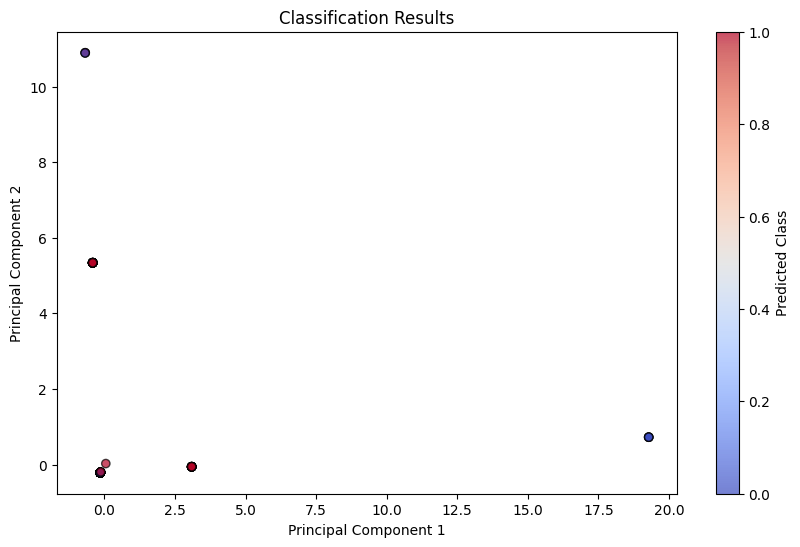

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Apply PCA to reduce dimensionality
pca = PCA(n_components=2)
X_test_pca = pca.fit_transform(X_test.numpy())

# Plot classification results
def plot_classification_results(X, y_true, y_pred):
    plt.figure(figsize=(10, 6))
    scatter = plt.scatter(X[:, 0], X[:, 1], c=y_pred, cmap='coolwarm', edgecolor='k', alpha=0.7)
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.title('Classification Results')
    plt.colorbar(scatter, label='Predicted Class')
    plt.show()

plot_classification_results(X_test_pca, true_labels.numpy(), predicted.numpy())


Thank You